In [1]:
import xarray as xr
#import rioxarray as rxr
import xesmf as xe
import pandas as pd
import numpy as np
import calendar as cld
import matplotlib.pyplot as plt
import matplotlib.colors
colors_land = plt.cm.terrain(np.linspace(0.25, 1, 256))
import proplot as pplt # New plot library (https://proplot.readthedocs.io/en/latest/)
pplt.rc['savefig.dpi'] = 300 # 1200 is too big! #https://proplot.readthedocs.io/en/latest/basics.html#Creating-figures
from scipy.stats import chi2
from numba import njit,prange
import matplotlib as mpl
mpl.rcParams['hatch.linewidth'] = 0.05  # previous pdf hatch linewidth
from matplotlib.dates import DateFormatter

from pyproj import CRS,Transformer,Proj

import sys
sys.path.insert(1, '/home/castelli/Notebooks/PhD/utils') # to include my util file in previous directory
import utils as u
u.check_python_version()

3.10.13 | packaged by conda-forge | (main, Oct 26 2023, 18:07:37) [GCC 12.3.0]


In [2]:
def daily_to_monthly(var_array,leap_year): # var_array must be 365 or 366 days, in shape [time,x,y]
    list_monthly_var = []
    day = 0
    
    if leap_year:
        month_days = [31,29,31,30,31,30,31,31,30,31,30,31]
    else:
        month_days = [31,28,31,30,31,30,31,31,30,31,30,31]
    
    for i in range(12):
        eom = day + month_days[i] #eom : end of month
        result = var_array[day:eom].mean(axis=0)
        list_monthly_var.append(result)
        day = eom

    monthly_var = np.stack(list_monthly_var)
    return monthly_var

In [3]:
ds = xr.open_dataset('/bettik/beaumetj/MARout/MAR-EC-Earth3/MARgrid_EUe.nc')

imin = 32 ; imax = -30
jmin = 20 ; jmax = -15
lon = np.array(ds.LON[jmin:jmax,imin:imax])
lat = np.array(ds.LAT[jmin:jmax,imin:imax])
H = np.array(ds.SH[jmin:jmax,imin:imax])
nlat,nlon = 91, 139

normal_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':True,
                 'lonlines':2, 'latlines':2, 'abc':False, 'latlim':[43.,48.5],'lonlim':[4.,16.]}
big_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':True,
              'lonlines':2, 'latlines':2, 'abc':False, 'latlim':[41.,50],'lonlim':[0.,20.]}
multiplot_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':False, 'lonlines':2,
                    'latlines':2, 'abc':False, 'latlim':[43.,48.5],'lonlim':[4.,16.]}

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

veg_mar = ['No Veg.', # 0
           'Crops Low', # 1
           'Crops Medium', # 2
           'Crops High', # 3
           'Grass low', # 4
           'Grass Medium', # 5
           'Grass High', # 6
           'Broadleaf Low', # 7
           'Broadleaf Medium', # 8
           'Broadleaf High', # 9
           'Needle Low', # 10
           'Needle Medium', # 11
           'Needle High', # 12
           'City'] # 13

In [4]:
ds = xr.open_dataset('/bettik/castelli/MARout/EUh/h01/2015/ICE.h01.2015.01.01-31.nc')[["LON","LAT","SH","FRV","VEG"]]

ds

<xarray.Dataset>
Dimensions:  (y: 80, x: 80, sector: 3)
Coordinates:
  * x        (x) float32 -168.0 -161.0 -154.0 -147.0 ... 364.0 371.0 378.0 385.0
  * y        (y) float32 -273.0 -266.0 -259.0 -252.0 ... 259.0 266.0 273.0 280.0
  * sector   (sector) float32 1.0 2.0 3.0
Data variables:
    LON      (y, x) float32 ...
    LAT      (y, x) float32 ...
    SH       (y, x) float32 ...
    FRV      (sector, y, x) float32 ...
    VEG      (sector, y, x) float32 ...
Attributes:
    title:        ICE - Exp: h01 - 20150101
    institution:  ULg (Xavier Fettweis)
    history:      libUN (2005.04.08) - Thu May 22 04:38:36 2025
    netcdf:       4.8.0 of May  2 2023 12:43:48 $

In [5]:
# function for seasonal mean (from Ian)
def season_mean(ds, calendar="standard"):
    #make a DataArray with the season of each day
    seas_array = ds.time.dt.season
    
    # count days in winter season (varies with leap years)
    nb_DJF = seas_array.str.count('DJF').sum()
    
    wgt_DJF = 1/nb_DJF.values.item()
    wgt_MAM = 1/(31+30+31)
    wgt_JJA = 1/(30+31+31)
    wgt_SON = 1/(30+31+30)

    weight = seas_array.str.replace('DJF',str(wgt_DJF)).str.replace('MAM',str(wgt_MAM)).str.replace('JJA',str(wgt_JJA)).str.replace('SON',str(wgt_SON))
    weight = weight.astype('float')
    
    # Test that the sum of the weights for each season is 1.0
    np.testing.assert_allclose(weight.groupby("time.season").sum().values, np.ones(4))

    # Calculate the weighted average
    return (ds * weight).groupby("time.season").sum(dim="time")

In [6]:
#ds_CC.CC.resample(time="1D").mean()



In [7]:
def detect_alps(H):
    nlat,nlon = np.shape(H)
    mask = np.bool_(np.zeros((nlat,nlon)))
    r = 4
    for j in range(r,nlat-r):
        for i in range(r,nlon-r):
            mask[j,i] = np.logical_and(H[j,i]>360 ,np.any(H[j-r:j+r,i-r:i+r]>1300))
            # mask[j,i] = np.std(H[j-r:j+r,i-r:i+r])>200
    return mask
alps = detect_alps(H)
alps[lon<4.8] = False
alps[np.logical_and(lon>10,lat<45.2)] = False

alps_month = np.repeat(alps[np.newaxis,:,:],12,axis=0)


In [8]:
def energy_balance_maps(path):
    vars = ["SWU","SWD","LWU","LWD","SHF","LHF","Melt","GF"]
    Lf = 3.34*10**5 # J.kg**(-1) the latent heat of fusion of water
    t_day = 86400 # 60*60*24 seconds in a day

    f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=3,nrows=3)
    
    for i,var in enumerate(vars):
        if var=="Melt":
            ds_MBm = xr.open_dataset(path)["MBm"][:,:,jmin:jmax,imin:imax]
            ds_FRV = xr.open_dataset('/bettik/castelli/data/MAR-EC-Earth3/ICE.EC-Earth3.EUe.FRV.08.1975.nc').FRV[:,jmin:jmax,imin:imax]
            FRV_sect1 = np.array(ds_FRV.sel(sector=1.0)/100)
            FRV_sect2 = np.array(ds_FRV.sel(sector=2.0)/100)
            FRV_sect3 = np.array(ds_FRV.sel(sector=3.0)/100)
            melt_MBm = ds_MBm.sel(sector=1.0)*FRV_sect1 + ds_MBm.sel(sector=2.0)*FRV_sect2 + ds_MBm.sel(sector=3.0)*FRV_sect3
            ds_var = melt_MBm * Lf / t_day
        else:
            ds_var = xr.open_dataset(path)[var][:,jmin:jmax,imin:imax]

        ax=axs[i]
        m = ax.pcolormesh(lon,lat,ds_var.mean(axis=0),levels=np.linspace(-25,25,11),cmap='RdBu_r',title=var)

    
    f.colorbar(m, label= '?')

    axs.format(**normal_format,suptitle="Ground Flux - Jan 2015 ",titlesize='20px')

In [9]:
def open_monthly_data_k(year,month,days_in_month,sim,day_average=True,HA_col=True,timestep_in_hours = 2,imin = 32,imax = -30,jmin = 20,jmax = -15):
    path = '/bettik/castelli/MARout/EU'
    letter = sim[0]
    code = sim[1:]
    if day_average:
        ds_day = xr.open_dataset(path+letter+'/'+letter+code+'/'+year+'/ICE.'+letter+code+'.'+year+'.'+month+'.01-'+days_in_month+'.nc')[["GFk","SWUk","SWD",
                                                                                                                                  "HAcck","LWUk","LWD","SHFk","LHFk",
                                                                                                                                  "MBm","MBr","MBmTop","MBrTop","MB",
                                                                                                                                  "SAbs_vk","SAbs","CC",
                                                                                                                                  "TTz","ST","SWtk"]].isel(x=slice(imin,imax),
                                                                                                                                y=slice(jmin,jmax)).groupby("time.day").mean()
        if HA_col:
            ds_ha_col = xr.open_dataset(path+letter+'/'+letter+code+'/'+year+'/ICE.'+letter+code+'.'+year+'.'+month+'.01-'+days_in_month+'.nc')["HA_colk"].isel(x=slice(imin,imax),
                                                                                                              y=slice(jmin,jmax)).groupby("time.day").mean()
            ds_day['HA_colk'] = ds_ha_col
    else:
        ds_day = xr.open_dataset(path+letter+'/'+letter+code+'/'+year+'/ICE.'+letter+code+'.'+year+'.'+month+'.01-'+days_in_month+'.nc')[["GFk","SWUk","SWD",
                                                                                                                                  "HAcck","LWUk","LWD","SHFk","LHFk",
                                                                                                                                  "MBm","MBr","MBmTop","MBrTop","MB",
                                                                                                                                  "SAbs_vk","SAbs","CC",
                                                                                                                                  "TTz","ST","SWtk"]].isel(x=slice(imin,imax),
                                                                                                                                                    y=slice(jmin,jmax))
        if HA_col:
            ds_ha_col = xr.open_dataset(path+letter+'/'+letter+code+'/'+year+'/ICE.'+letter+code+'.'+year+'.'+month+'.01-'+days_in_month+'.nc')["HA_colk"].isel(x=slice(imin,imax),
                                                                                                              y=slice(jmin,jmax))
            ds_day['HA_colk'] = ds_ha_col
    
    # Melt
    Lf = 3.34*10**5 # J.kg**(-1) the latent heat of fusion of water
    #t_day = 86400 # 60*60*24 seconds in a day
    t_timestep = 60*60*timestep_in_hours
    ds_day_melt = ds_day.MBm * Lf / t_timestep # kg.m**(-2) * J.kg**(-1) / s = J/s.m**(-2) = W.m**(-2)
    ds_day_freez = ds_day.MBr * Lf / t_timestep
    ds_day_melt_top = ds_day.MBmTop * Lf / t_timestep
    ds_day_freez_top = ds_day.MBrTop * Lf / t_timestep



    ds_day['NSWk'] = ds_day.SWD - ds_day.SWUk
    ds_day['NLWk'] = ds_day.LWD - ds_day.LWUk
    ds_day['meltk'] = -ds_day_melt # minus sign because energy is LOST by surface in order to melt snow
    ds_day['freezek'] = ds_day_freez
    ds_day['melt_topk'] = -ds_day_melt_top
    ds_day['freeze_topk'] = ds_day_freez_top
    ds_day['TT2'] = ds_day.TTz.sel(ztqlev=2.0)
    ds_day['SWtk'] = -ds_day['SWtk'] # - sign because the energy transmitted to lower layers is LOST by the surface

    ds_day_surf_balance = ds_day.NSWk + ds_day.NLWk + ds_day.SHFk + ds_day.LHFk + ds_day.melt_topk + ds_day.freeze_topk + ds_day.GFk + ds_day.HAcck + ds_day.SWtk

    ds_day['Surf_Balk'] = ds_day_surf_balance

    return ds_day

In [10]:
def open_monthly_data_ave(year,month,days_in_month,sim,day_average=True,HA_col=True,timestep_in_hours = 2,imin = 32,imax = -30,jmin = 20,jmax = -15,whichpath='castelli'):
    # average of mosaics

    if whichpath=='castelli':
        path = '/bettik/castelli/MARout/EU'
    else:
        path = '/bettik/menegozm/MARout/EU'
    letter = sim[0]
    code = sim[1:]
    if day_average:
        ds_day = xr.open_dataset(path+letter+'/'+letter+code+'/'+year+'/ICE.'+letter+code+'.'+year+'.'+month+'.01-'+days_in_month+'.nc')[["GF","SWU","SWD",
                                                                                                                                  "HAcc","LWU","LWD","SHF","LHF",
                                                                                                                                  "MBm","MBr","MBmTop","MBrTop","MB","MBrr",
                                                                                                                                  "SAbs_v","SAbs","CC","CU","CM","CD","QQz",
                                                                                                                                  "TTz","ST","SWt"]].isel(x=slice(imin,imax),
                                                                                                                                y=slice(jmin,jmax)).groupby("time.day").mean()
        if HA_col:
            ds_ha_col = xr.open_dataset(path+letter+'/'+letter+code+'/'+year+'/ICE.'+letter+code+'.'+year+'.'+month+'.01-'+days_in_month+'.nc')["HA_col"].isel(x=slice(imin,imax),
                                                                                                              y=slice(jmin,jmax)).groupby("time.day").mean()
            ds_day['HA_col'] = ds_ha_col
    else:
        ds_day = xr.open_dataset(path+letter+'/'+letter+code+'/'+year+'/ICE.'+letter+code+'.'+year+'.'+month+'.01-'+days_in_month+'.nc')[["GF","SWU","SWD",
                                                                                                                                  "HAcc","LWU","LWD","SHF","LHF",
                                                                                                                                  "MBm","MBr","MBmTop","MBrTop","MB","MBrr",
                                                                                                                                  "SAbs_v","SAbs","CC","CU","CM","CD","QQz",
                                                                                                                                  "TTz","ST","SWt"]].isel(x=slice(imin,imax),
                                                                                                                                                    y=slice(jmin,jmax))
        if HA_col:
            ds_ha_col = xr.open_dataset(path+letter+'/'+letter+code+'/'+year+'/ICE.'+letter+code+'.'+year+'.'+month+'.01-'+days_in_month+'.nc')["HA_col"].isel(x=slice(imin,imax),
                                                                                                              y=slice(jmin,jmax))
            ds_day['HA_col'] = ds_ha_col

    # Melt
    Lf = 3.34*10**5 # J.kg**(-1) the latent heat of fusion of water
    #t_day = 86400 # 60*60*24 seconds in a day
    t_timestep = 60*60*timestep_in_hours
    melt_MBm = ds_day.MBm.sel(sector=1.0)*ds.FRV.sel(sector=1.0)/100 + ds_day.MBm.sel(sector=2.0)*ds.FRV.sel(sector=2.0)/100 + \
               ds_day.MBm.sel(sector=3.0)*ds.FRV.sel(sector=3.0)/100 # in mm = L.m**(-2) = kg.m**(-2) because for liquid water 1L=1kg
    freez_MBr = ds_day.MBr.sel(sector=1.0)*ds.FRV.sel(sector=1.0)/100 + ds_day.MBr.sel(sector=2.0)*ds.FRV.sel(sector=2.0)/100 + \
               ds_day.MBr.sel(sector=3.0)*ds.FRV.sel(sector=3.0)/100
    melt_MBm_top = ds_day.MBmTop.sel(sector=1.0)*ds.FRV.sel(sector=1.0)/100 + ds_day.MBmTop.sel(sector=2.0)*ds.FRV.sel(sector=2.0)/100 + \
                   ds_day.MBmTop.sel(sector=3.0)*ds.FRV.sel(sector=3.0)/100
    freez_MBr_top = ds_day.MBrTop.sel(sector=1.0)*ds.FRV.sel(sector=1.0)/100 + ds_day.MBrTop.sel(sector=2.0)*ds.FRV.sel(sector=2.0)/100 + \
                   ds_day.MBrTop.sel(sector=3.0)*ds.FRV.sel(sector=3.0)/100
    average_snow = ds_day.MB.sel(sector=1.0)*ds.FRV.sel(sector=1.0)/100 + ds_day.MB.sel(sector=2.0)*ds.FRV.sel(sector=2.0)/100 + \
               ds_day.MB.sel(sector=3.0)*ds.FRV.sel(sector=3.0)/100
    ds_day_melt = melt_MBm * Lf / t_timestep # kg.m**(-2) * J.kg**(-1) / s = J/s.m**(-2) = W.m**(-2)
    ds_day_freez = freez_MBr * Lf / t_timestep
    ds_day_melt_top = melt_MBm_top * Lf / t_timestep
    ds_day_freez_top = freez_MBr_top * Lf / t_timestep


    ds_day['NSW'] = ds_day.SWD - ds_day.SWU
    ds_day['NLW'] = ds_day.LWD - ds_day.LWU
    ds_day['melt'] = -ds_day_melt # minus sign because energy is LOST by surface in order to melt snow
    ds_day['freeze'] = ds_day_freez
    ds_day['melt_top'] = -ds_day_melt_top
    ds_day['freeze_top'] = ds_day_freez_top
    ds_day['TT2'] = ds_day.TTz.sel(ztqlev=2.0)
    ds_day['MBave'] = average_snow
    ds_day['SWt'] = -ds_day['SWt'] # - sign because the energy transmitted to lower layers is LOST by the surface

    
    ds_day_surf_balance = ds_day.NSW + ds_day.NLW + ds_day.SHF + ds_day.LHF + ds_day.melt_top + ds_day.freeze_top + ds_day.GF + ds_day.HAcc + ds_day.SWt

    ds_day['Surf_Bal'] = ds_day_surf_balance

    return ds_day

In [11]:
def open_monthly_data_ave_1var(year,month,days_in_month,sim,day_average=True,HA_col=True,timestep_in_hours = 2,imin = 32,imax = -30,jmin = 20,jmax = -15, whichpath='castelli'):
    # average of mosaics
    if whichpath=='castelli':
        path = '/bettik/castelli/MARout/EU'
    else:
        path = '/bettik/menegozm/MARout/EU'
    letter = sim[0]
    code = sim[1:]
    if day_average:
        ds_day = xr.open_dataset(path+letter+'/'+letter+code+'/'+year+'/ICE.'+letter+code+'.'+year+'.'+month+'.01-'+days_in_month+'.nc')[["CC"]].isel(x=slice(imin,imax),
                                                                                                                                y=slice(jmin,jmax)).groupby("time.day").mean()

    else:
        ds_day = xr.open_dataset(path+letter+'/'+letter+code+'/'+year+'/ICE.'+letter+code+'.'+year+'.'+month+'.01-'+days_in_month+'.nc')[["CC"]].isel(x=slice(imin,imax),
                                                                                                                                                    y=slice(jmin,jmax))
    

    return ds_day

In [12]:
def open_yearly_data(year, sim, vars, timestep_in_hours = 4):
    
    ds_year = xr.open_dataset('/bettik/castelli/data/MAR-EC-Earth3/small_domain/SSP245/ICE.EC-Earth3_SSP245.'+sim+'.TTz.'+year+'.nc')

    for var in vars:
        ds_var = xr.open_dataset('/bettik/castelli/data/MAR-EC-Earth3/small_domain/SSP245/ICE.EC-Earth3_SSP245.'+sim+'.'+var+'.'+year+'.nc')
        ds_year[var] = ds_var[var]

    # Melt and Refreeze
    Lf = 3.34*10**5 # J.kg**(-1) the latent heat of fusion of water
    t_timestep = 60*60*timestep_in_hours
    melt_MBm = ds_year.MBm.sel(sector=1.0)*ds.FRV.sel(sector=1.0)/100 + ds_year.MBm.sel(sector=2.0)*ds.FRV.sel(sector=2.0)/100 + \
            ds_year.MBm.sel(sector=3.0)*ds.FRV.sel(sector=3.0)/100 # in mm = L.m**(-2) = kg.m**(-2) because for liquid water 1L=1kg
    freez_MBr = ds_year.MBr.sel(sector=1.0)*ds.FRV.sel(sector=1.0)/100 + ds_year.MBr.sel(sector=2.0)*ds.FRV.sel(sector=2.0)/100 + \
            ds_year.MBr.sel(sector=3.0)*ds.FRV.sel(sector=3.0)/100
    melt_MBm_top = ds_year.MBmTop.sel(sector=1.0)*ds.FRV.sel(sector=1.0)/100 + ds_year.MBmTop.sel(sector=2.0)*ds.FRV.sel(sector=2.0)/100 + \
                ds_year.MBmTop.sel(sector=3.0)*ds.FRV.sel(sector=3.0)/100
    freez_MBr_top = ds_year.MBrTop.sel(sector=1.0)*ds.FRV.sel(sector=1.0)/100 + ds_year.MBrTop.sel(sector=2.0)*ds.FRV.sel(sector=2.0)/100 + \
                ds_year.MBrTop.sel(sector=3.0)*ds.FRV.sel(sector=3.0)/100
    average_snow = ds_year.MB.sel(sector=1.0)*ds.FRV.sel(sector=1.0)/100 + ds_year.MB.sel(sector=2.0)*ds.FRV.sel(sector=2.0)/100 + \
               ds_year.MB.sel(sector=3.0)*ds.FRV.sel(sector=3.0)/100

    ds_day_melt = melt_MBm * Lf / t_timestep # kg.m**(-2) * J.kg**(-1) / s = J/s.m**(-2) = W.m**(-2)
    ds_day_freez = freez_MBr * Lf / t_timestep
    ds_day_melt_top = melt_MBm_top * Lf / t_timestep
    ds_day_freez_top = freez_MBr_top * Lf / t_timestep


    ds_year['NSW'] = ds_year.SWD - ds_year.SWU
    ds_year['NLW'] = ds_year.LWD - ds_year.LWU
    ds_year['melt'] = -ds_day_melt # minus sign because energy is LOST by surface in order to melt snow
    ds_year['freeze'] = ds_day_freez
    ds_year['melt_top'] = -ds_day_melt_top
    ds_year['freeze_top'] = ds_day_freez_top
    ds_year['TT2'] = ds_year.TTz.sel(ztqlev=2.0)
    ds_year['MBave'] = average_snow
    ds_year['SWt'] = -ds_year['SWt'] # - sign because the energy transmitted to lower layers is LOST by the surface

    ds_year['Surf_Bal'] = ds_year.NSW + ds_year.NLW + ds_year.SHF + ds_year.LHF + ds_year.melt_top + ds_year.freeze_top + ds_year.GF + ds_year.HAcc + ds_year.SWt

    return ds_year

In [13]:
def plot_by_mosaic(ds_var,ds_var_ave,first,last,iloc,jloc,ymin,ymax,names_var,colors):
# ------------------------------------------------- Map ------------------------------------------------
        
    colors_land = plt.cm.terrain(np.linspace(0.25, 1, 256))
    f, ax = pplt.subplots(proj='cyl', axwidth=5)
    m=ax.pcolormesh(ds.LON, ds.LAT, ds.SH, levels=17,cmap=colors_land)
    f.colorbar(m,label= 'm.a.s.l.',labelsize='large',ticklabelsize='large')

    ax.plot(lon[iloc,jloc], lat[iloc,jloc],'rx',markersize=8,markeredgewidth=1.5)

    ax.format(**normal_format)
    ax.format(ocean=True,oceancolor='royalblue',reso='hi')

# ------------------------------------------------- Mosaic plots ------------------------------------------------

    longitude_point = round(float(lon[iloc,jloc]),2)
    latitude_point = round(float(lat[iloc,jloc]),2)
    f, axs = pplt.subplots(axwidth=5,axheight=0.4,ncols=2,nrows=4,hratios=(1,5,1,5),ref=1,sharey=False)
    pplt.rc.update(small=10, large=12)

    ds_var_ave['Surf_Bal_noSWt'] = ds_var_ave.NSW + ds_var_ave.NLW + ds_var_ave.SHF + ds_var_ave.LHF + ds_var_ave.melt_top + ds_var_ave.freeze_top + ds_var_ave.GF + \
                                ds_var_ave.HAcc
    ds_var['Surf_Bal_noSWtk'] = ds_var.NSWk + ds_var.NLWk + ds_var.SHFk + ds_var.LHFk + ds_var.melt_topk + ds_var.freeze_topk + ds_var.GFk + \
                                ds_var.HAcck
    
    ds_var_ave['Surf_Bal_HA_col'] = ds_var_ave.NSW + ds_var_ave.NLW + ds_var_ave.SHF + ds_var_ave.LHF + ds_var_ave.melt + ds_var_ave.freeze + ds_var_ave.HA_col
    ds_var['Surf_Bal_HA_colk'] = ds_var.NSWk + ds_var.NLWk + ds_var.SHFk + ds_var.LHFk + ds_var.meltk + ds_var.freezek + ds_var.HA_colk
    
    ds_var_ave['Surf_Bal_nofreeze'] = ds_var_ave.NSW + ds_var_ave.NLW + ds_var_ave.SHF + ds_var_ave.LHF + ds_var_ave.melt_top + ds_var_ave.GF + ds_var_ave.HAcc + \
                                        ds_var_ave.SWt
    ds_var['Surf_Bal_nofreezek'] = ds_var.NSWk + ds_var.NLWk + ds_var.SHFk + ds_var.LHFk + ds_var.melt_topk + ds_var.GFk + ds_var.HAcck + ds_var.SWtk
    
    ds_var_ave['Surf_Bal_noHAcc'] = ds_var_ave.NSW + ds_var_ave.NLW + ds_var_ave.SHF + ds_var_ave.LHF + ds_var_ave.melt_top + ds_var_ave.freeze + ds_var_ave.GF + \
                                    ds_var_ave.SWt
    ds_var['Surf_Bal_noHAcck'] = ds_var.NSWk + ds_var.NLWk + ds_var.SHFk + ds_var.LHFk + ds_var.melt_topk + ds_var.freezek + ds_var.GFk + ds_var.SWtk

    for i,var in enumerate(names_var):
        if(var=='Surf_Bal' or var=='Surf_Bal_HA_col' or var=='Surf_Bal_nofreeze' or var=='Surf_Bal_noHAcc'):
            line_width=2.5
        else:
            line_width=1
        ax=axs[2]
        ax.set_ylim([ymin,ymax])
        ax.format(ylabel='W/$m^2$')
        ax.scatter(ds_var_ave.time[first:last], np.array(ds_var_ave[var])[first:last,iloc,jloc], c=colors[i], s=10)
        ax.plot(ds_var_ave.time[first:last], np.array(ds_var_ave[var])[first:last,iloc,jloc], c=colors[i],linewidth=line_width)
        
        ax=axs[3]
        ax.set_ylim([ymin,ymax])
        ax.scatter(ds_var.time[first:last], np.array(ds_var[var+'k'].sel(sector="1.0"))[first:last,iloc,jloc], c=colors[i], s=10)
        ax.plot(ds_var.time[first:last], np.array(ds_var[var+'k'].sel(sector="1.0"))[first:last,iloc,jloc], c=colors[i],linewidth=line_width)
        ax=axs[6]
        ax.set_ylim([ymin,ymax])
        ax.format(ylabel='W/$m^2$')
        ax.scatter(ds_var.time[first:last], np.array(ds_var[var+'k'].sel(sector="2.0"))[first:last,iloc,jloc], c=colors[i], s=10)
        ax.plot(ds_var.time[first:last], np.array(ds_var[var+'k'].sel(sector="2.0"))[first:last,iloc,jloc], c=colors[i],linewidth=line_width)
        ax=axs[7]
        ax.set_ylim([ymin,ymax])
        ax.scatter(ds_var.time[first:last], np.array(ds_var[var+'k'].sel(sector="3.0"))[first:last,iloc,jloc], c=colors[i], s=10)
        ax.plot(ds_var.time[first:last], np.array(ds_var[var+'k'].sel(sector="3.0"))[first:last,iloc,jloc], c=colors[i],linewidth=line_width,label=var)


    max_MB = np.array(ds_var['MB'])[:,first:last,iloc,jloc].max()
    ax=axs[0]
    ax.format(title='Average of sectors',ylabel='Snow \n(mmWe)')
    ax.set_ylim([-0.1,max_MB])
    ax.plot(ds_var_ave.time[first:last], np.array(ds_var_ave['MBave'])[first:last,iloc,jloc], c='skyblue',linewidth=line_width)
    
    ax=axs[1]
    ax.format(title=f'Sector 1 : {veg_mar[int(ds.VEG[0,iloc,jloc])]}')
    ax.set_ylim([-0.1,max_MB])
    ax.plot(ds_var.time[first:last], np.array(ds_var['MB'].sel(sector="1.0"))[first:last,iloc,jloc], c='skyblue',linewidth=line_width)
    ax=axs[4]
    ax.format(title=f'Sector 2 : {veg_mar[int(ds.VEG[1,iloc,jloc])]}',ylabel='Snow \n(mmWe)')
    ax.set_ylim([-0.1,max_MB])
    ax.plot(ds_var.time[first:last], np.array(ds_var['MB'].sel(sector="2.0"))[first:last,iloc,jloc], c='skyblue',linewidth=line_width)
    ax=axs[5]
    ax.format(title=f'Sector 3 : {veg_mar[int(ds.VEG[2,iloc,jloc])]}')
    ax.set_ylim([-0.1,max_MB])
    ax.plot(ds_var.time[first:last], np.array(ds_var['MB'].sel(sector="3.0"))[first:last,iloc,jloc], c='skyblue',linewidth=line_width)

    f.format(titlesize='20px',suptitle=f'Gridpoint (lon {longitude_point}°, lat {latitude_point}°)')
    f.legend(loc='b',prop = { "size": 10 },ncols=4)

In [14]:
def plot_by_mosaic2(ds_var,ds_var_ave,first,last,iloc,jloc,ymin,ymax,names_var,colors):
# ------------------------------------------------- Map ------------------------------------------------
        
    colors_land = plt.cm.terrain(np.linspace(0.25, 1, 256))
    f, ax = pplt.subplots(proj='cyl', axwidth=5)
    m=ax.pcolormesh(ds.LON, ds.LAT, ds.SH, levels=17,cmap=colors_land)
    f.colorbar(m,label= 'm.a.s.l.',labelsize='large',ticklabelsize='large')

    ax.plot(ds.LON[iloc,jloc], ds.LAT[iloc,jloc],'rx',markersize=8,markeredgewidth=1.5)

    ax.format(**normal_format)
    ax.format(ocean=True,oceancolor='royalblue',reso='hi')

# ------------------------------------------------- Mosaic plots ------------------------------------------------

    longitude_point = round(float(ds.LON[iloc,jloc]),2)
    latitude_point = round(float(ds.LAT[iloc,jloc]),2)
    f, axs = pplt.subplots(axwidth=5,axheight=0.4,ncols=2,nrows=4,hratios=(1,5,1,5),ref=1,sharey=False)
    pplt.rc.update(small=10, large=12)

    ds_var_ave['Surf_Bal_noSWt'] = ds_var_ave.NSW + ds_var_ave.NLW + ds_var_ave.SHF + ds_var_ave.LHF + ds_var_ave.melt_top + ds_var_ave.freeze_top + ds_var_ave.GF + \
                                ds_var_ave.HAcc
    ds_var['Surf_Bal_noSWtk'] = ds_var.NSWk + ds_var.NLWk + ds_var.SHFk + ds_var.LHFk + ds_var.melt_topk + ds_var.freeze_topk + ds_var.GFk + \
                                ds_var.HAcck
    
    ds_var_ave['Surf_Bal_HA_col'] = ds_var_ave.NSW + ds_var_ave.NLW + ds_var_ave.SHF + ds_var_ave.LHF + ds_var_ave.melt + ds_var_ave.freeze + ds_var_ave.HA_col
    ds_var['Surf_Bal_HA_colk'] = ds_var.NSWk + ds_var.NLWk + ds_var.SHFk + ds_var.LHFk + ds_var.meltk + ds_var.freezek + ds_var.HA_colk
    
    ds_var_ave['Surf_Bal_nofreeze'] = ds_var_ave.NSW + ds_var_ave.NLW + ds_var_ave.SHF + ds_var_ave.LHF + ds_var_ave.melt_top + ds_var_ave.GF + ds_var_ave.HAcc + \
                                        ds_var_ave.SWt
    ds_var['Surf_Bal_nofreezek'] = ds_var.NSWk + ds_var.NLWk + ds_var.SHFk + ds_var.LHFk + ds_var.melt_topk + ds_var.GFk + ds_var.HAcck + ds_var.SWtk
    
    ds_var_ave['Surf_Bal_noHAcc'] = ds_var_ave.NSW + ds_var_ave.NLW + ds_var_ave.SHF + ds_var_ave.LHF + ds_var_ave.melt_top + ds_var_ave.freeze + ds_var_ave.GF + \
                                    ds_var_ave.SWt
    ds_var['Surf_Bal_noHAcck'] = ds_var.NSWk + ds_var.NLWk + ds_var.SHFk + ds_var.LHFk + ds_var.melt_topk + ds_var.freezek + ds_var.GFk + ds_var.SWtk

    for i,var in enumerate(names_var):
        if(var=='Surf_Bal' or var=='Surf_Bal_HA_col' or var=='Surf_Bal_nofreeze' or var=='Surf_Bal_noHAcc'):
            line_width=2.5
        else:
            line_width=1
        ax=axs[2]
        ax.set_ylim([ymin,ymax])
        ax.format(ylabel='W/$m^2$')
        ax.scatter(ds_var_ave.time[first:last], np.array(ds_var_ave[var])[first:last,iloc,jloc], c=colors[i], s=10)
        ax.plot(ds_var_ave.time[first:last], np.array(ds_var_ave[var])[first:last,iloc,jloc], c=colors[i],linewidth=line_width)
        
        ax=axs[3]
        ax.set_ylim([ymin,ymax])
        ax.scatter(ds_var.time[first:last], np.array(ds_var[var+'k'].sel(sector="1.0"))[first:last,iloc,jloc], c=colors[i], s=10)
        ax.plot(ds_var.time[first:last], np.array(ds_var[var+'k'].sel(sector="1.0"))[first:last,iloc,jloc], c=colors[i],linewidth=line_width)
        ax=axs[6]
        ax.set_ylim([ymin,ymax])
        ax.format(ylabel='W/$m^2$')
        ax.scatter(ds_var.time[first:last], np.array(ds_var[var+'k'].sel(sector="2.0"))[first:last,iloc,jloc], c=colors[i], s=10)
        ax.plot(ds_var.time[first:last], np.array(ds_var[var+'k'].sel(sector="2.0"))[first:last,iloc,jloc], c=colors[i],linewidth=line_width)
        ax=axs[7]
        ax.set_ylim([ymin,ymax])
        ax.scatter(ds_var.time[first:last], np.array(ds_var[var+'k'].sel(sector="3.0"))[first:last,iloc,jloc], c=colors[i], s=10)
        ax.plot(ds_var.time[first:last], np.array(ds_var[var+'k'].sel(sector="3.0"))[first:last,iloc,jloc], c=colors[i],linewidth=line_width,label=var)


    max_MB = np.array(ds_var['MB'])[first:last,:,iloc,jloc].max()
    ax=axs[0]
    ax.format(title='Average of sectors',ylabel='Snow \n(mmWe)')
    ax.set_ylim([-0.1,max_MB])
    ax.plot(ds_var_ave.time[first:last], np.array(ds_var_ave['MBave'])[first:last,iloc,jloc], c='skyblue',linewidth=line_width)
    
    ax=axs[1]
    ax.format(title=f'Sector 1 : {veg_mar[int(ds.VEG[0,iloc,jloc])]}')
    ax.set_ylim([-0.1,max_MB])
    ax.plot(ds_var.time[first:last], np.array(ds_var['MB'].sel(sector="1.0"))[first:last,iloc,jloc], c='skyblue',linewidth=line_width)
    ax=axs[4]
    ax.format(title=f'Sector 2 : {veg_mar[int(ds.VEG[1,iloc,jloc])]}',ylabel='Snow \n(mmWe)')
    ax.set_ylim([-0.1,max_MB])
    ax.plot(ds_var.time[first:last], np.array(ds_var['MB'].sel(sector="2.0"))[first:last,iloc,jloc], c='skyblue',linewidth=line_width)
    ax=axs[5]
    ax.format(title=f'Sector 3 : {veg_mar[int(ds.VEG[2,iloc,jloc])]}')
    ax.set_ylim([-0.1,max_MB])
    ax.plot(ds_var.time[first:last], np.array(ds_var['MB'].sel(sector="3.0"))[first:last,iloc,jloc], c='skyblue',linewidth=line_width)

    f.format(titlesize='20px',suptitle=f'Gridpoint (lon {longitude_point}°, lat {latitude_point}°)')
    f.legend(loc='b',prop = { "size": 10 },ncols=4)

In [15]:
def plot_monthly_2points(ds_var,first,last,iloc1,jloc1,iloc2,jloc2,ymin,ymax,names_var,colors):
# ------------------------------------------------- Map ------------------------------------------------
        
    colors_land = plt.cm.terrain(np.linspace(0.25, 1, 256))
    f, ax = pplt.subplots(proj='cyl', axwidth=5)
    m=ax.pcolormesh(ds.LON, ds.LAT, ds.SH, levels=17,cmap=colors_land)
    f.colorbar(m,label= 'm.a.s.l.',labelsize='large',ticklabelsize='large')

    ax.plot(ds.LON[iloc1,jloc1], ds.LAT[iloc1,jloc1],'rx',markersize=8,markeredgewidth=1.5)
    ax.plot(ds.LON[iloc2,jloc2], ds.LAT[iloc2,jloc2],'bx',markersize=8,markeredgewidth=1.5)

    ax.format(**normal_format)
    ax.format(ocean=True,oceancolor='royalblue',reso='hi')

# ------------------------------------------------- Time series plots ------------------------------------------------

    #longitude_point = round(float(lon[iloc,jloc]),2)
    #latitude_point = round(float(lat[iloc,jloc]),2)
    f, axs = pplt.subplots(axwidth=5,axheight=0.4,ncols=2,nrows=2,hratios=(1,5),ref=1,sharey=False)
    pplt.rc.update(small=10, large=12)
    
    #ds_var_ave['Surf_Bal_HA_col'] = ds_var_ave.NSW + ds_var_ave.NLW + ds_var_ave.SHF + ds_var_ave.LHF + ds_var_ave.melt + ds_var_ave.freeze + ds_var_ave.HA_col
    #ds_var['Surf_Bal_HA_colk'] = ds_var.NSWk + ds_var.NLWk + ds_var.SHFk + ds_var.LHFk + ds_var.meltk + ds_var.freezek + ds_var.HA_colk

    for i,var in enumerate(names_var):
        if(var=='Surf_Bal' or var=='Surf_Bal_HA_col'):
            line_width=2.5
        else:
            line_width=1
        ax=axs[2]
        ax.set_ylim([ymin,ymax])
        ax.format(ylabel='W/$m^2$')
        ax.scatter(ds_var.month[first:last], np.array(ds_var[var])[first:last,iloc1,jloc1], c=colors[i], s=10)
        ax.plot(ds_var.month[first:last], np.array(ds_var[var])[first:last,iloc1,jloc1], c=colors[i],linewidth=line_width)
        
        ax=axs[3]
        ax.set_ylim([ymin,ymax])
        ax.scatter(ds_var.month[first:last], np.array(ds_var[var])[first:last,iloc2,jloc2], c=colors[i], s=10)
        ax.plot(ds_var.month[first:last], np.array(ds_var[var])[first:last,iloc2,jloc2], c=colors[i],linewidth=line_width,label=var)


    max_MB = max(np.array(ds_var['MB'])[first:last,:,iloc1,jloc1].max(), np.array(ds_var['MB'])[:,first:last,iloc2,jloc2].max())
    ax=axs[0]
    ax.format(title='Point 1',ylabel='Snow \n(mmWe)')
    ax.set_ylim([-0.1,max_MB])
    ax.plot(ds_var.month[first:last], np.array(ds_var['MB'].max(axis=1))[first:last,iloc1,jloc1], c='skyblue',linewidth=line_width)

    max_MB = np.array(ds_var['MB'])[first:last,:,iloc2,jloc2].max()
    ax=axs[1]
    ax.format(title='Point 2')
    ax.plot(ds_var.month[first:last], np.array(ds_var['MB'].max(axis=1))[first:last,iloc2,jloc2], c='skyblue',linewidth=line_width)

    #f.format(titlesize='20px',suptitle=f'Gridpoint (lon {longitude_point}°, lat {latitude_point}°)')
    f.legend(loc='b',prop = { "size": 10 },ncols=4)

In [16]:
# Random point in the Alps
i1 = 75 # y
j1 = 90 # x

# Random point near Mediterranean
#i2 = 25
#j2 = 55
i2 = 34
j2 = 45

# Strong melt
i_m = 84
j_m = 92

# Strong refreeze
i_f = 68
j_f = 104

In [17]:
path_ju = '/bettik/beaumetj/MARout/MAR-ERA5/daily/ICE.ERA5_v1.EUl.'
#path_ian = '/bettik/castelli/data/MAR3.14/MAR-ERA5/EUb/ICE.ERA5.EUb.'
path_ian = '/bettik/castelli/data/MAR3.14/MAR-ERA5/EUc/ICE.ERA5.EUc.'

### EUe

#### e14 : January 01-05, without surface temperature limit

In [42]:
ds_e14_k = open_monthly_data_k(year='2015',month='01',days_in_month='05',sim='e14',day_average=False,HA_col=True,timestep_in_hours = 2)
ds_e14_ave = open_monthly_data_ave(year='2015',month='01',days_in_month='05',sim='e14',day_average=False,HA_col=True,timestep_in_hours = 2)

In [44]:
ds_e14_ave.MBrr.groupby('time.day').mean()

<xarray.Dataset>
Dimensions:     (x: 139, y: 91, sector: 3, ztqlev: 3, day: 5)
Coordinates:
  * x           (x) float32 -259.0 -252.0 -245.0 -238.0 ... 693.0 700.0 707.0
  * y           (y) float32 -168.0 -161.0 -154.0 -147.0 ... 448.0 455.0 462.0
  * sector      (sector) float32 1.0 2.0 3.0
  * ztqlev      (ztqlev) float32 2.0 10.0 100.0
  * day         (day) int64 1 2 3 4 5
Data variables: (12/34)
    GF          (day, y, x) float32 232.3 227.2 220.4 ... -1.051 -1.397 -1.938
    SWU         (day, y, x) float32 9.406 9.388 9.289 ... 1.682 2.043 1.693
    SWD         (day, y, x) float32 88.68 88.51 87.58 86.64 ... 7.57 8.9 7.293
    HAcc        (day, y, x) float32 32.14 31.44 30.5 ... -0.02605 -0.03167
    LWU         (day, y, x) float32 380.9 381.3 381.8 ... 313.1 310.8 310.3
    LWD         (day, y, x) float32 263.1 266.2 275.5 ... 270.2 268.5 269.6
    ...          ...
    freeze      (day, y, x) float32 nan nan nan nan nan ... nan nan nan nan nan
    melt_top    (day, y, x) float32 nan nan nan nan nan ... nan nan nan nan nan
    freeze_top  (day, y, x) float32 nan nan nan nan nan ... nan nan nan nan nan
    TT2         (day, y, x) float32 8.796 8.755 8.708 ... 1.602 1.291 1.061
    MBave       (day, y, x) float32 nan nan nan nan nan ... nan nan nan nan nan
    Surf_Bal    (day, y, x) float32 nan nan nan nan nan ... nan nan nan nan nan
Attributes:
    title:        ICE - Exp: e14 - 20150101
    institution:  ULg (Xavier Fettweis)
    history:      libUN (2005.04.08) - Wed May  7 17:30:34 2025
    netcdf:       4.8.0 of May  2 2023 12:43:48 $

In [48]:
ds

<xarray.Dataset>
Dimensions:  (y: 80, x: 80, sector: 3)
Coordinates:
  * x        (x) float32 -168.0 -161.0 -154.0 -147.0 ... 364.0 371.0 378.0 385.0
  * y        (y) float32 -273.0 -266.0 -259.0 -252.0 ... 259.0 266.0 273.0 280.0
  * sector   (sector) float32 1.0 2.0 3.0
Data variables:
    LON      (y, x) float32 4.953 5.038 5.123 5.209 ... 11.83 11.92 12.02 12.11
    LAT      (y, x) float32 42.53 42.53 42.53 42.53 ... 47.42 47.41 47.41 47.4
    SH       (y, x) float32 ...
    FRV      (sector, y, x) float32 ...
    VEG      (sector, y, x) float32 ...
Attributes:
    title:        ICE - Exp: h01 - 20150101
    institution:  ULg (Xavier Fettweis)
    history:      libUN (2005.04.08) - Thu May 22 04:38:36 2025
    netcdf:       4.8.0 of May  2 2023 12:43:48 $

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

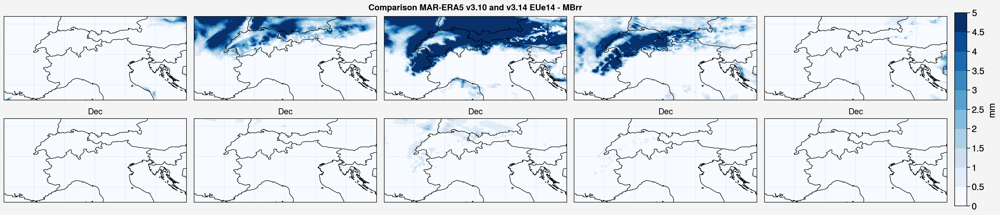

In [49]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=5,nrows=2,axheight=1.5)

ds_e14_ave_MBrr_day = ds_e14_ave.MBrr.groupby('time.day').mean()
ds_big = xr.open_dataset('/bettik/beaumetj/MARout/MAR-EC-Earth3/MARgrid_EUe.nc')


for d in range(5):
    ax=axs[d]
    m = ax.pcolormesh(ds_big.LON,ds_big.LAT,ds_EUl2015_MBrr.MBrr[d],levels=np.linspace(0,5,11),cmap='Blues')
    
    ax=axs[d+5]
    m = ax.pcolormesh(ds_big.LON[jmin:jmax,imin:imax],ds_big.LAT[jmin:jmax,imin:imax],ds_e14_ave_MBrr_day.isel(day=d),levels=np.linspace(0,5,11),cmap='Blues')
    ax.format(title=months[mon])


f.colorbar(m,label= 'mm',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format,suptitle='Comparison MAR-ERA5 v3.10 and v3.14 EUe14 - MBrr')

In [16]:
ds_day = xr.open_dataset('/bettik/castelli/MARout/EUe/e14/2015/ICE.e14.2015.01.01-05.nc')[["ST2"]].isel(x=slice(imin,imax),y=slice(jmin,jmax))
ds_e14_k["ST2"] = ds_day["ST2"]

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


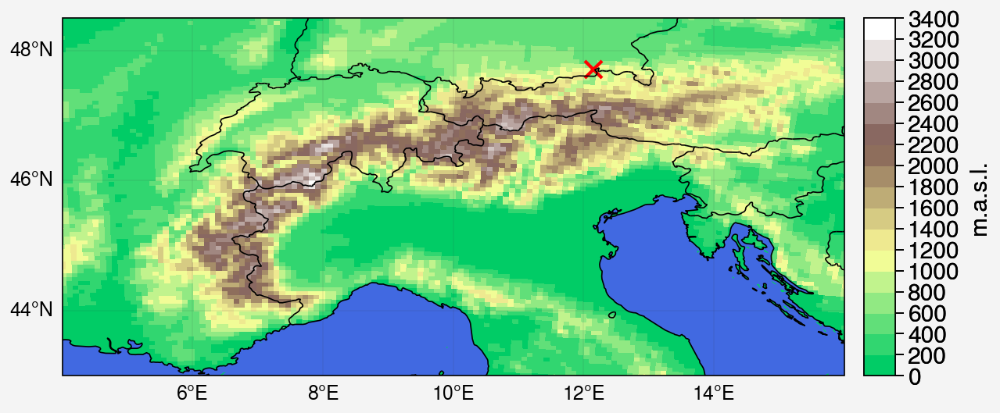

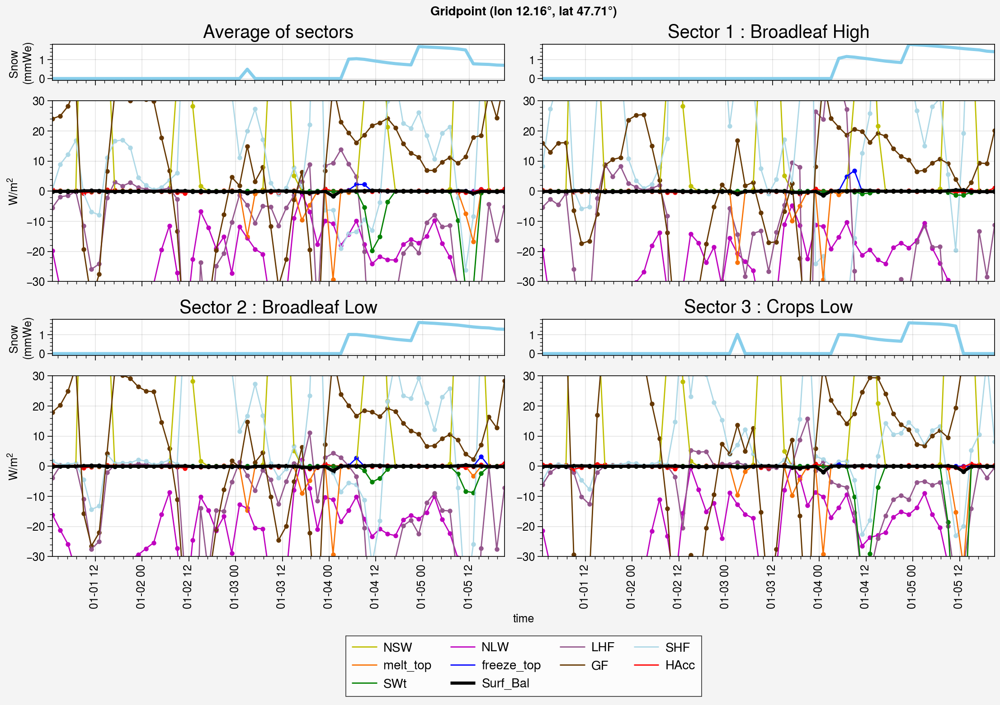

In [17]:
plot_by_mosaic(ds_var = ds_e14_k, ds_var_ave = ds_e14_ave, first=0, last=-1, iloc = i1, jloc = j1, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


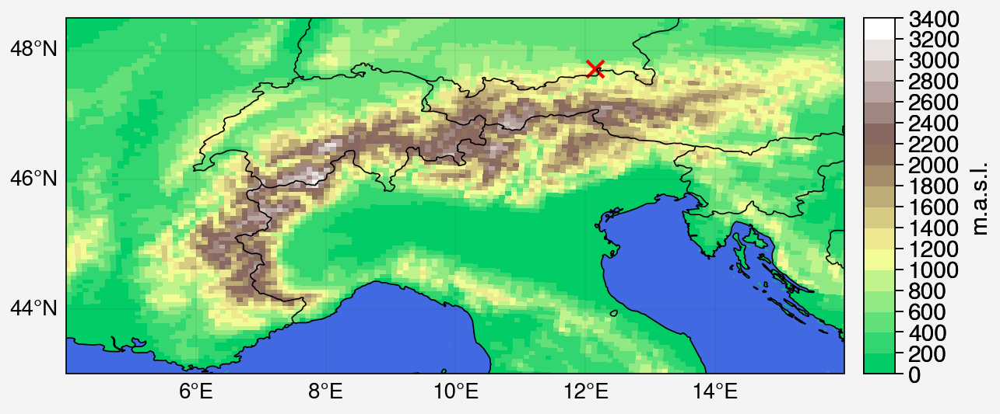

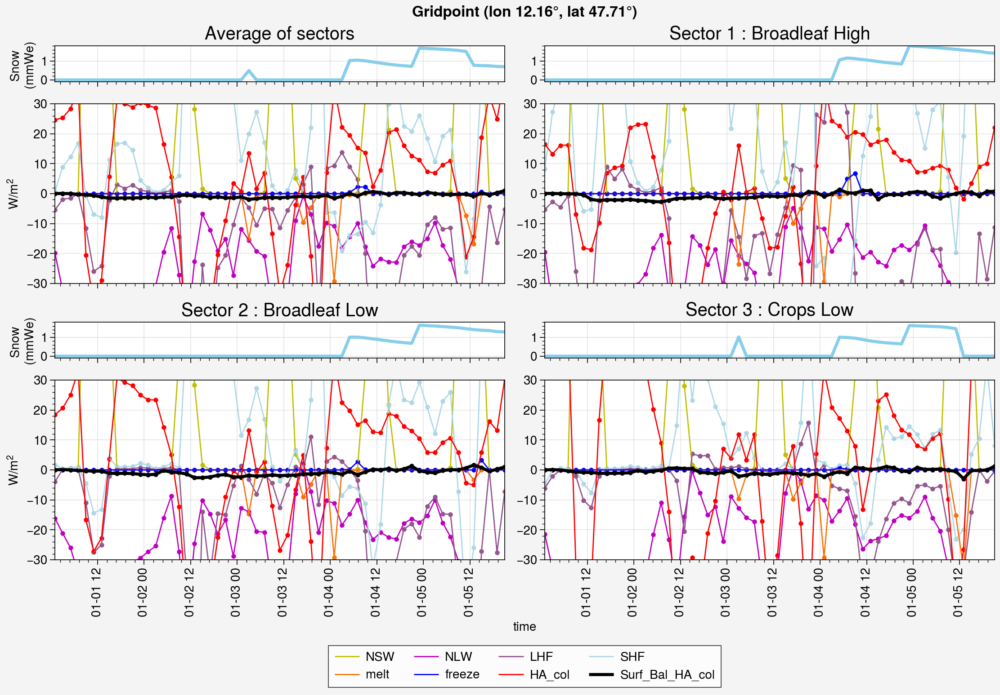

In [18]:
plot_by_mosaic(ds_var = ds_e14_k, ds_var_ave = ds_e14_ave, first=0, last=-1, iloc = i1, jloc = j1, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


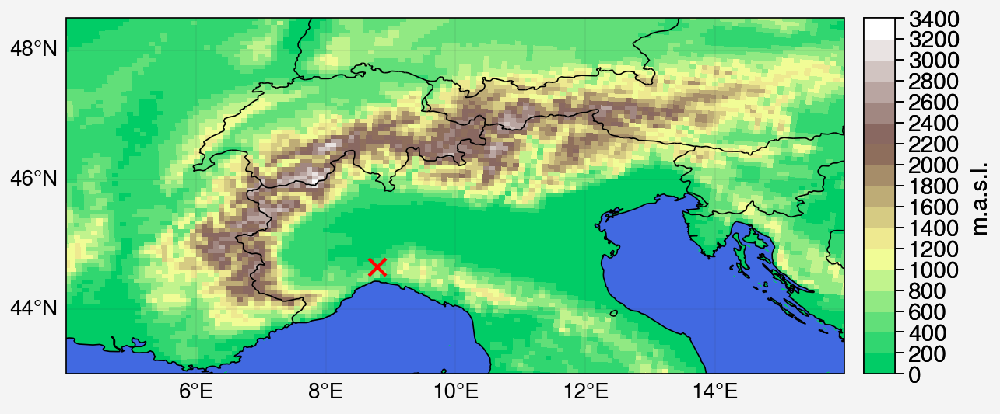

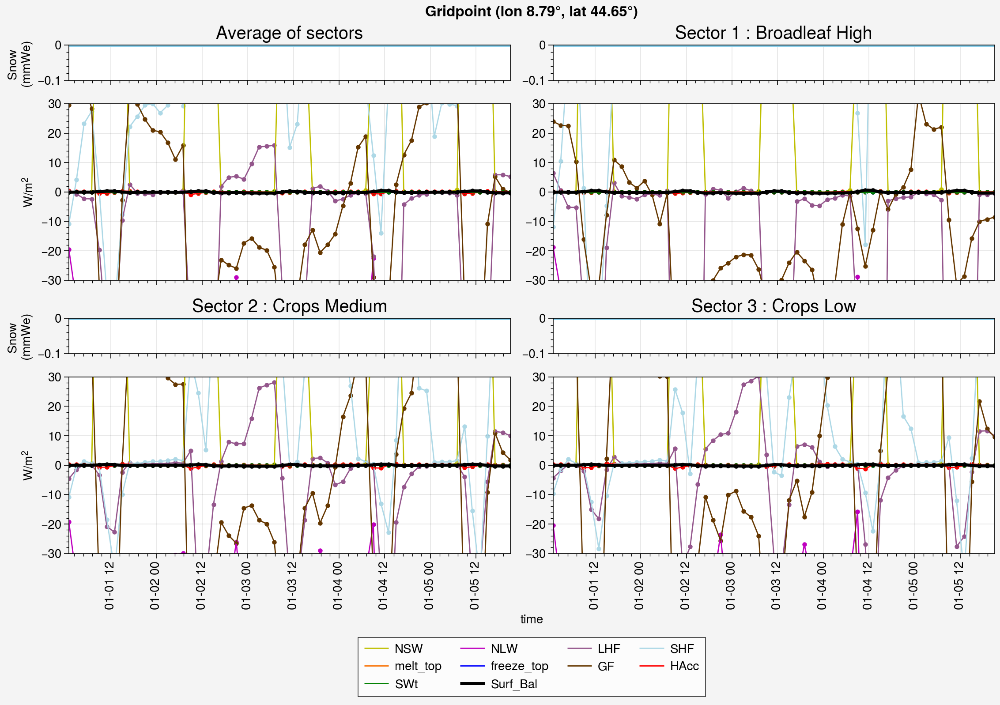

In [19]:
plot_by_mosaic(ds_var = ds_e14_k, ds_var_ave = ds_e14_ave, first=0, last=-1, iloc = i2, jloc = j2, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


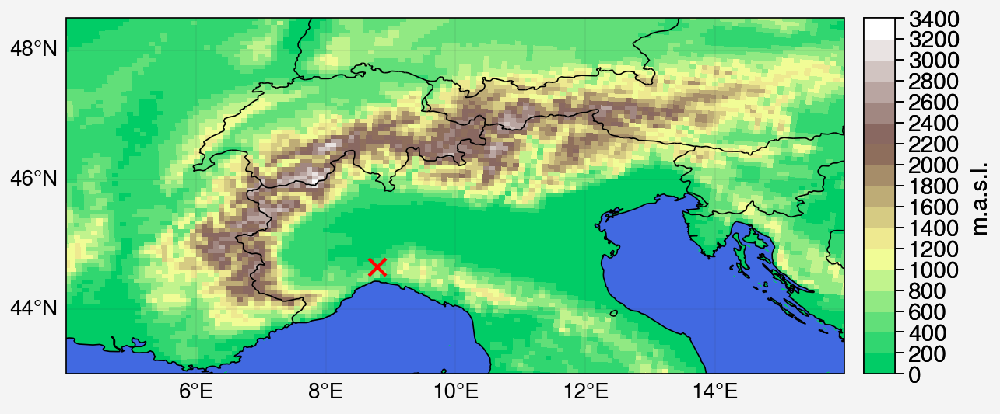

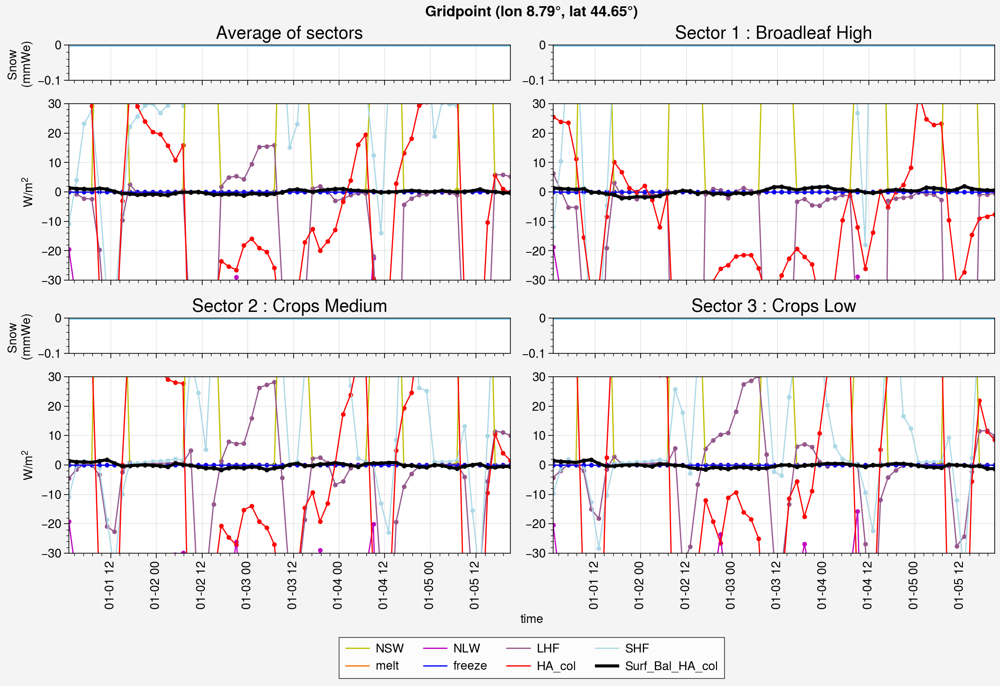

In [20]:
plot_by_mosaic(ds_var = ds_e14_k, ds_var_ave = ds_e14_ave, first=0, last=-1, iloc = i2, jloc = j2, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


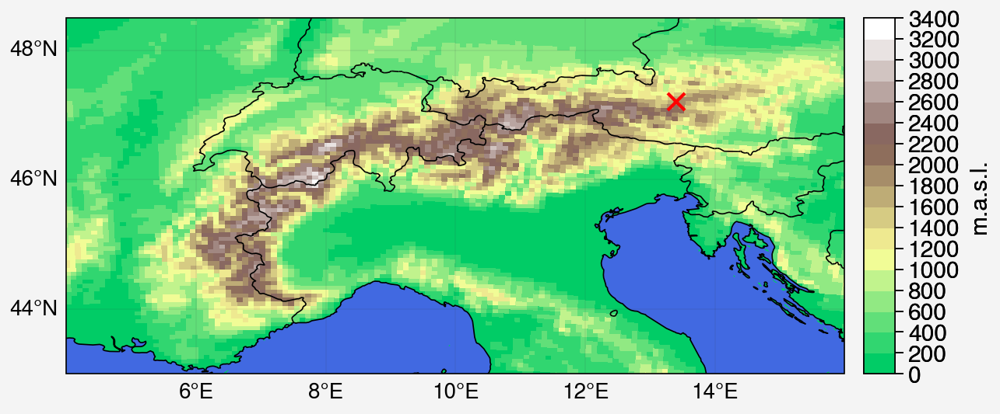

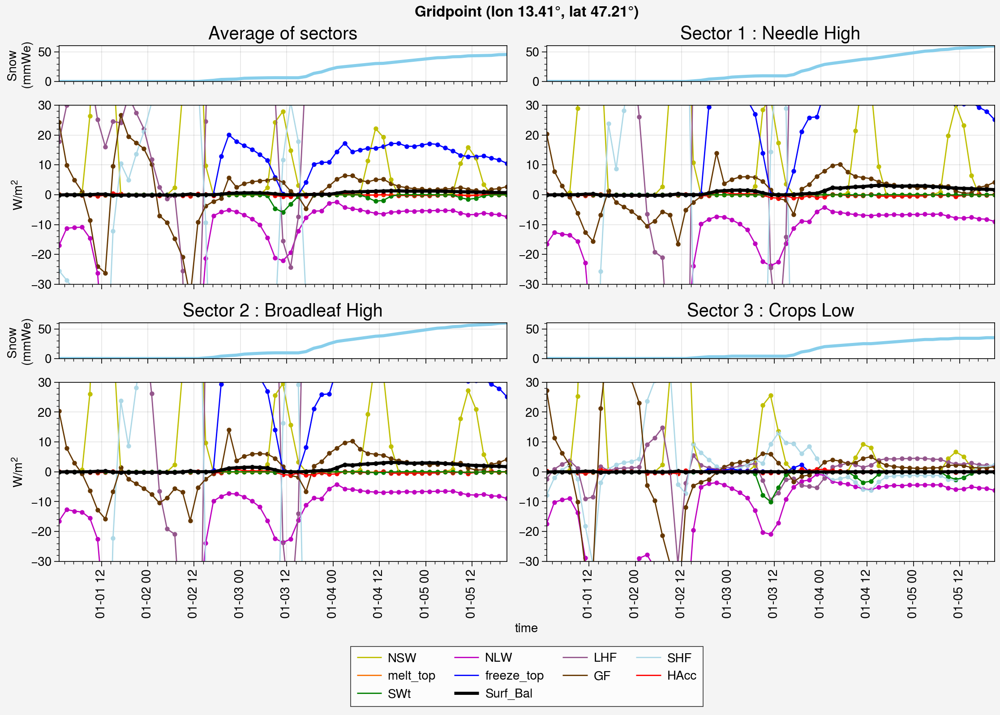

In [21]:
# arr_e14_totfreeze = np.array(ds_e14_ave.freeze.sum(axis=0))
# i_f, j_f = np.where(arr_e14_totfreeze==arr_e14_totfreeze.max())
# print(i_f,j_f)
# print(arr_e14_totfreeze.max())

plot_by_mosaic(ds_var = ds_e14_k, ds_var_ave = ds_e14_ave, first=0, last=-1, iloc = i_f, jloc = j_f, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


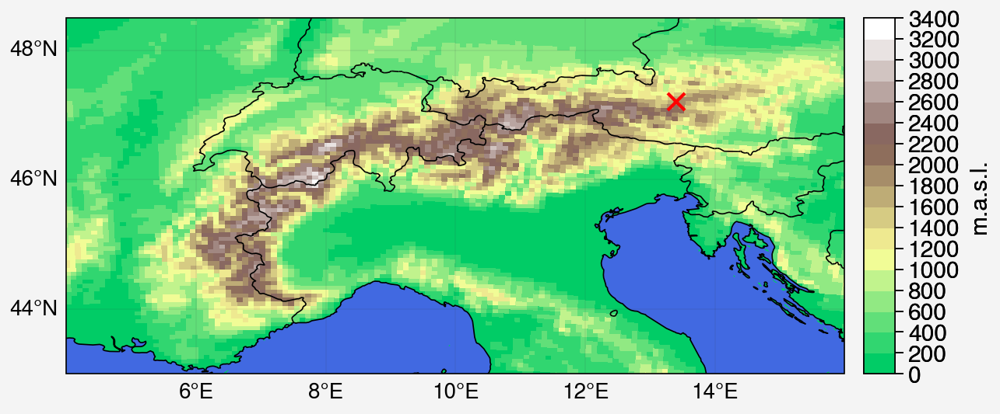

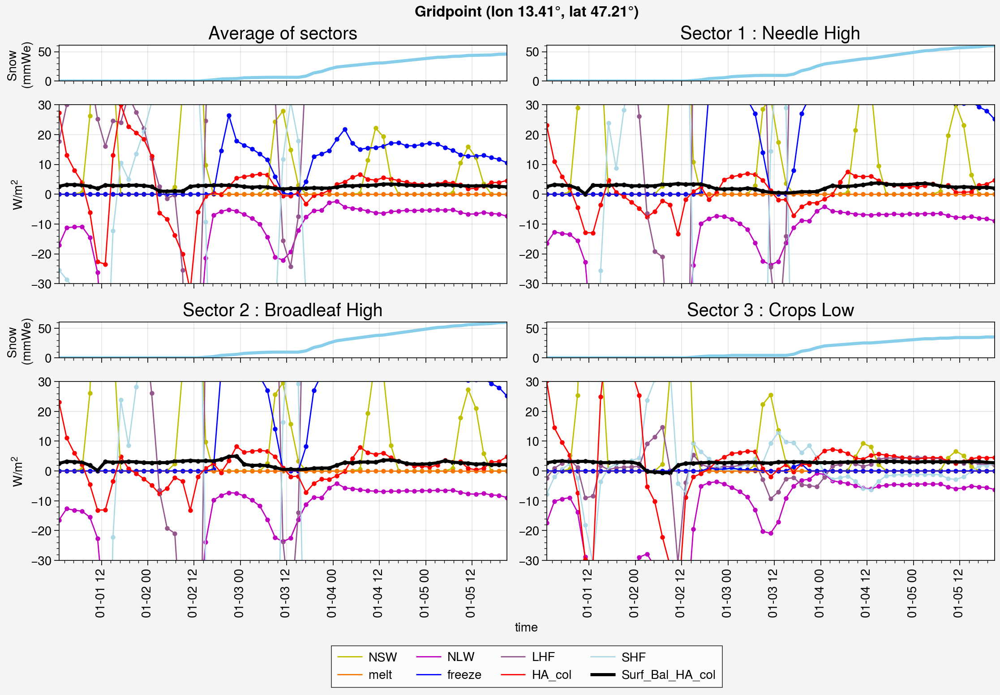

In [22]:
plot_by_mosaic(ds_var = ds_e14_k, ds_var_ave = ds_e14_ave, first=0, last=-1, iloc = i_f, jloc = j_f, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


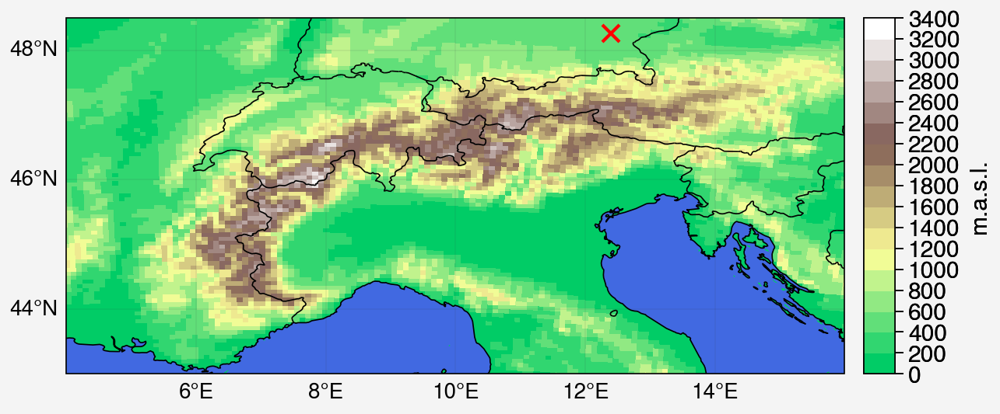

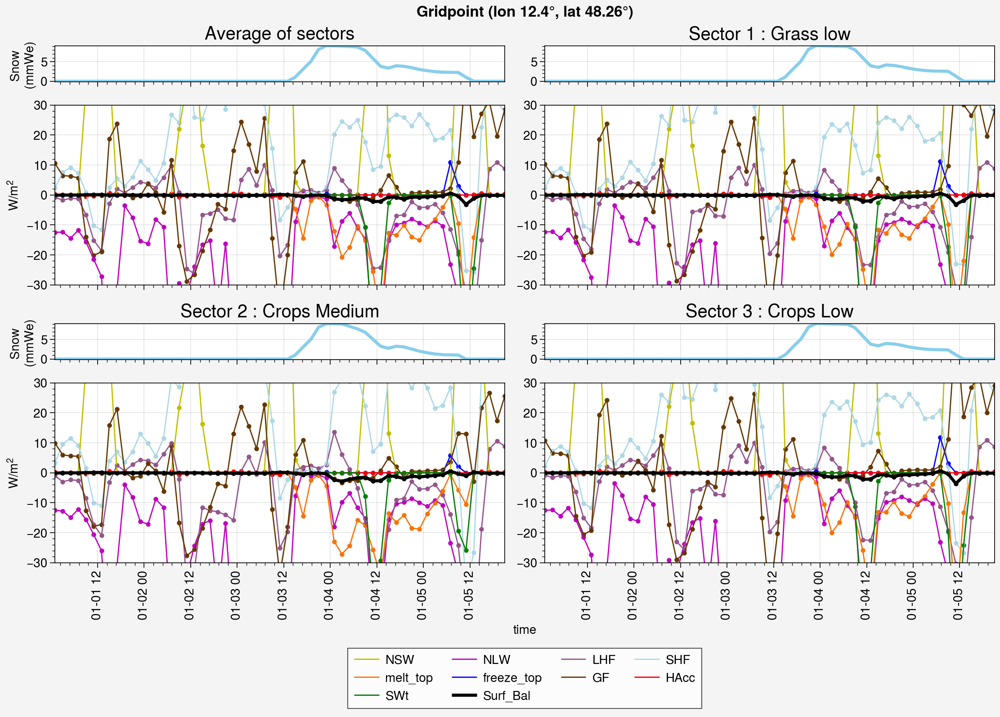

In [23]:
# arr_e14_totmelt = np.array(ds_e14_ave.melt.sum(axis=0))
# i_m, j_m = np.where(arr_e14_totmelt==arr_e14_totmelt.min())
# print(i_m,j_m)
# print(arr_e14_totmelt.min())

plot_by_mosaic(ds_var = ds_e14_k, ds_var_ave = ds_e14_ave, first=0, last=-1, iloc = i_m, jloc = j_m, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


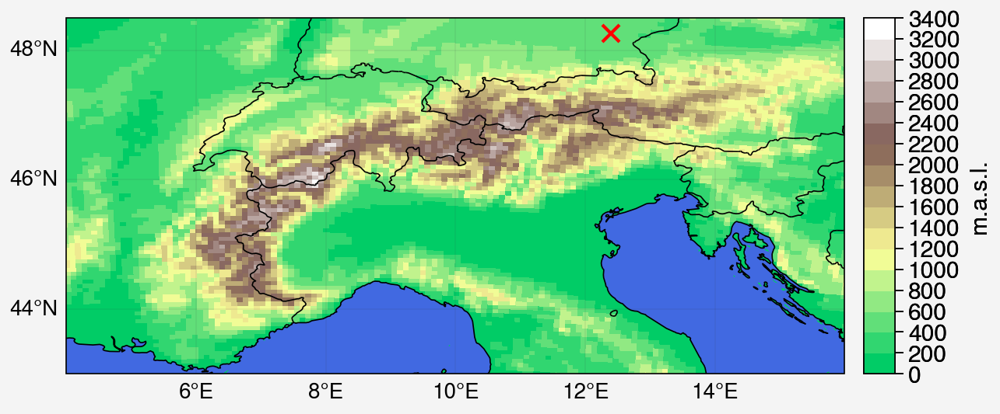

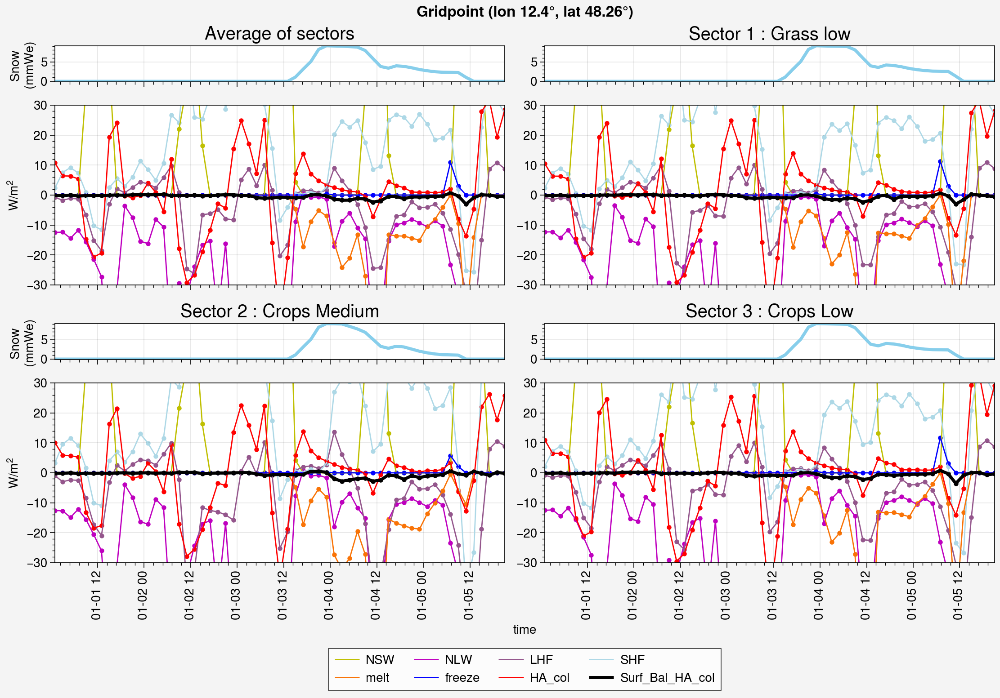

In [24]:
plot_by_mosaic(ds_var = ds_e14_k, ds_var_ave = ds_e14_ave, first=0, last=-1, iloc = i_m, jloc = j_m, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

#### e15 : January 01-05, with surface temperature limit

In [25]:
ds_e15_k = open_monthly_data_k(month='01',days_in_month='05',sim='e15',day_average=False,HA_col=True,timestep_in_hours = 2)
ds_e15_ave = open_monthly_data_ave(month='01',days_in_month='05',sim='e15',day_average=False,HA_col=True,timestep_in_hours = 2)

In [26]:
ds_day = xr.open_dataset('/bettik/castelli/MARout/EUe/e15/2015/ICE.e15.2015.01.01-05.nc')[["ST2"]].isel(x=slice(imin,imax),y=slice(jmin,jmax))
ds_e15_k["ST2"] = ds_day["ST2"]

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


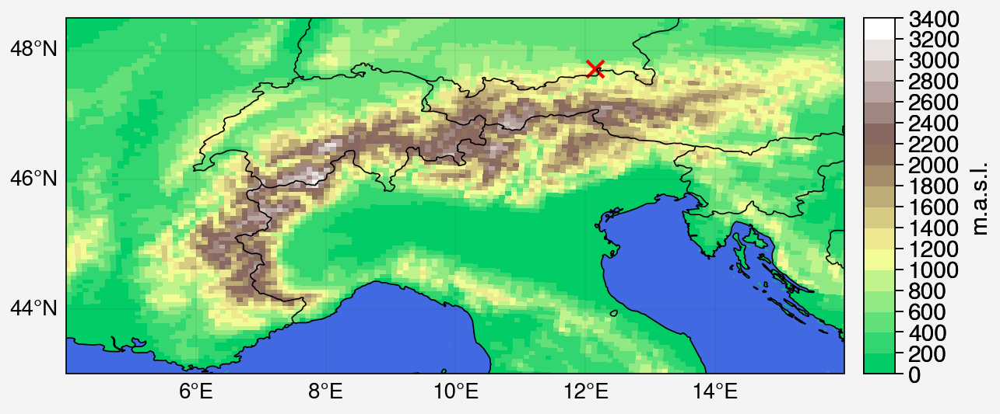

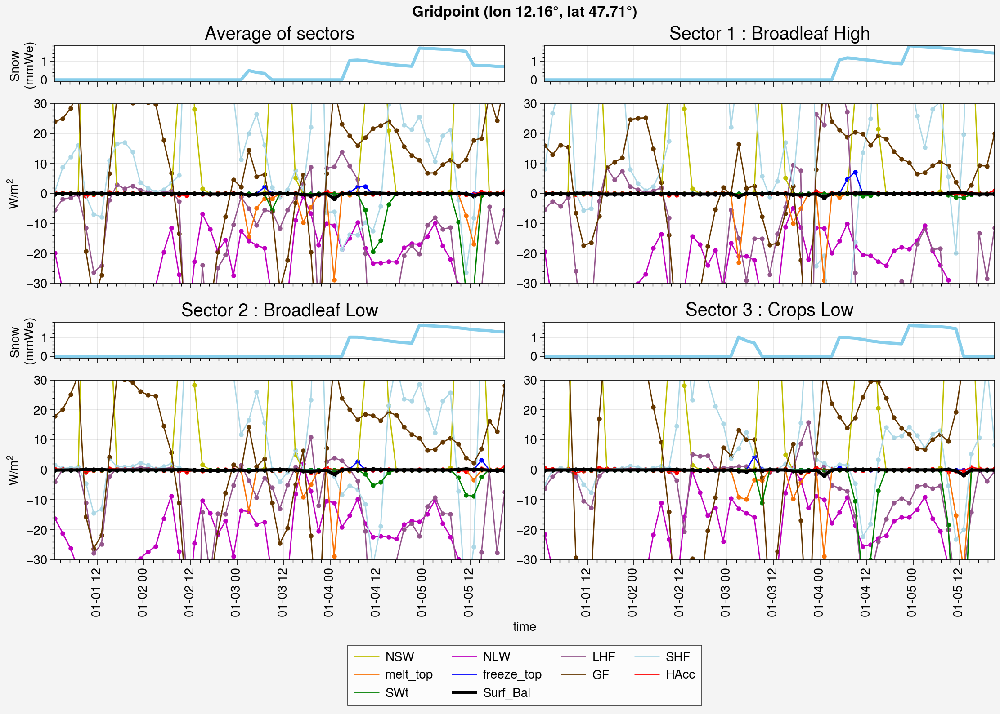

In [27]:
plot_by_mosaic(ds_var = ds_e15_k, ds_var_ave = ds_e15_ave, first=0, last=-1, iloc = i1, jloc = j1, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


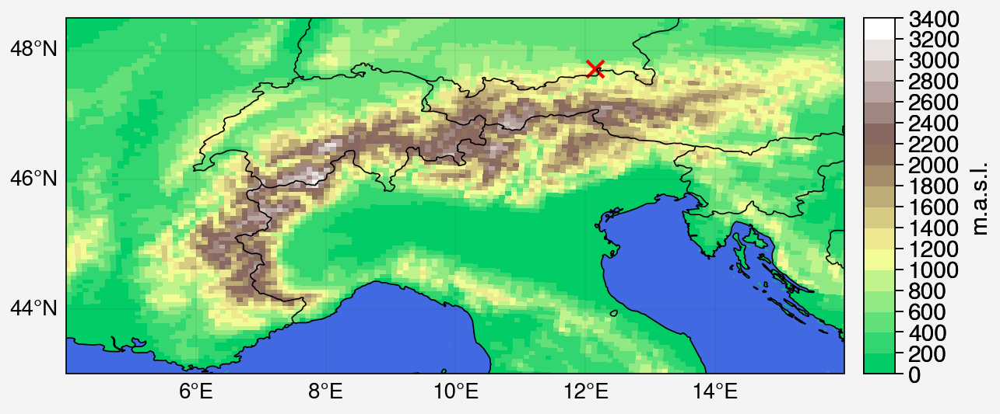

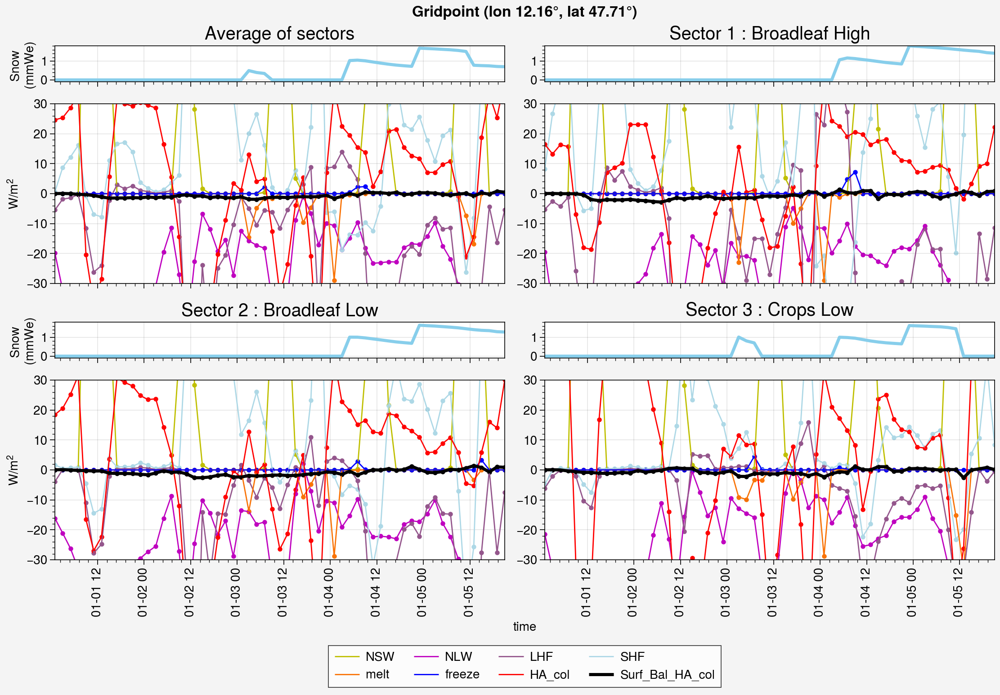

In [28]:
plot_by_mosaic(ds_var = ds_e15_k, ds_var_ave = ds_e15_ave, first=0, last=-1, iloc = i1, jloc = j1, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


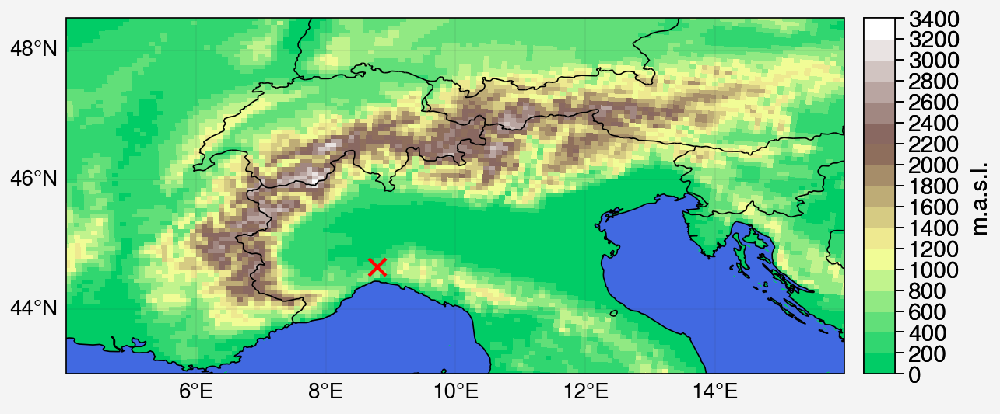

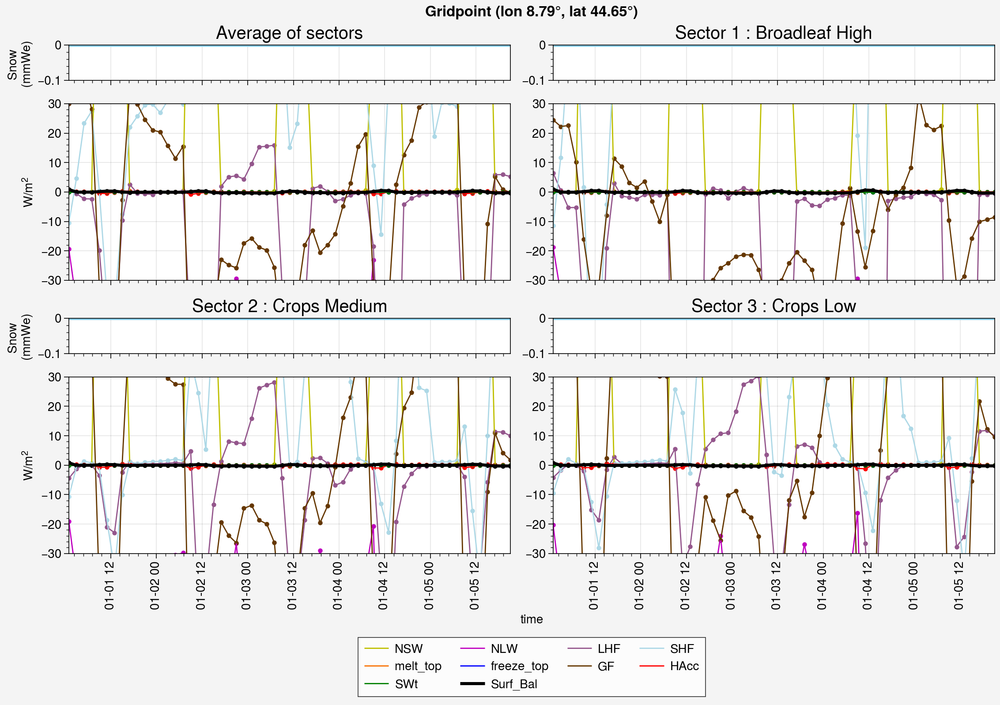

In [29]:
plot_by_mosaic(ds_var = ds_e15_k, ds_var_ave = ds_e15_ave, first=0, last=-1, iloc = i2, jloc = j2, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


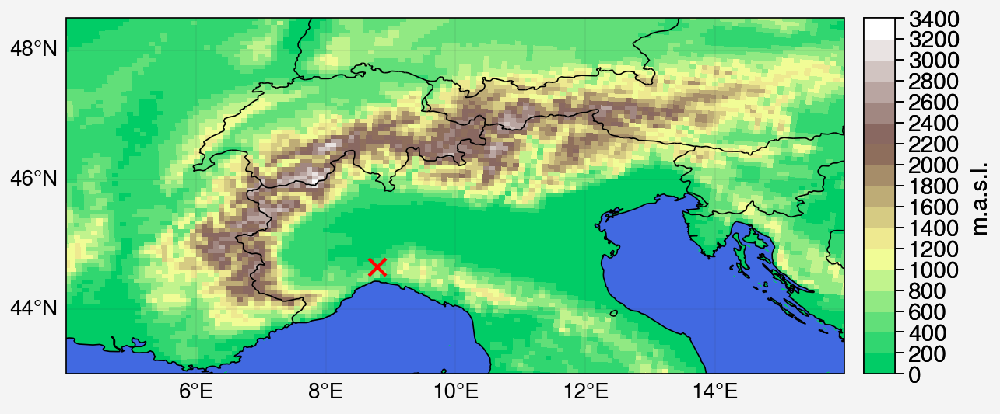

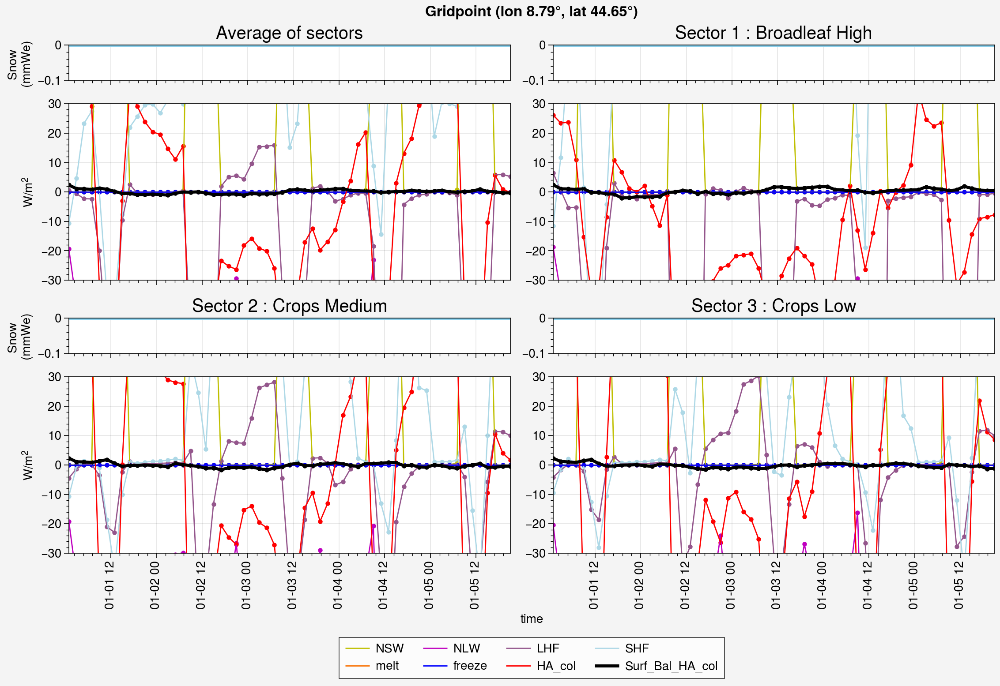

In [30]:
plot_by_mosaic(ds_var = ds_e15_k, ds_var_ave = ds_e15_ave, first=0, last=-1, iloc = i2, jloc = j2, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

[68] [104]
529.2269


/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2266328/1935158804.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  longitude_point = round(float(lon[iloc,jloc]),2)
/tmp/ipykernel_2266328/1935158804.py:17: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  latitude_point = round(float(lat[iloc,jloc]),2)
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize'

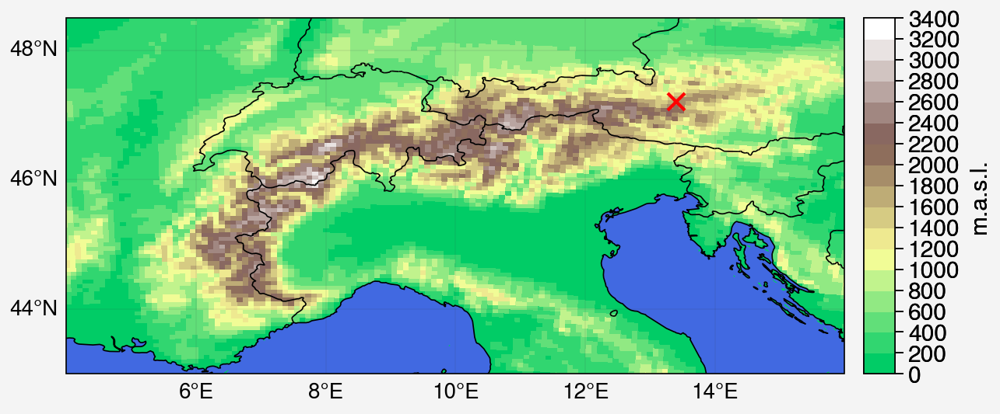

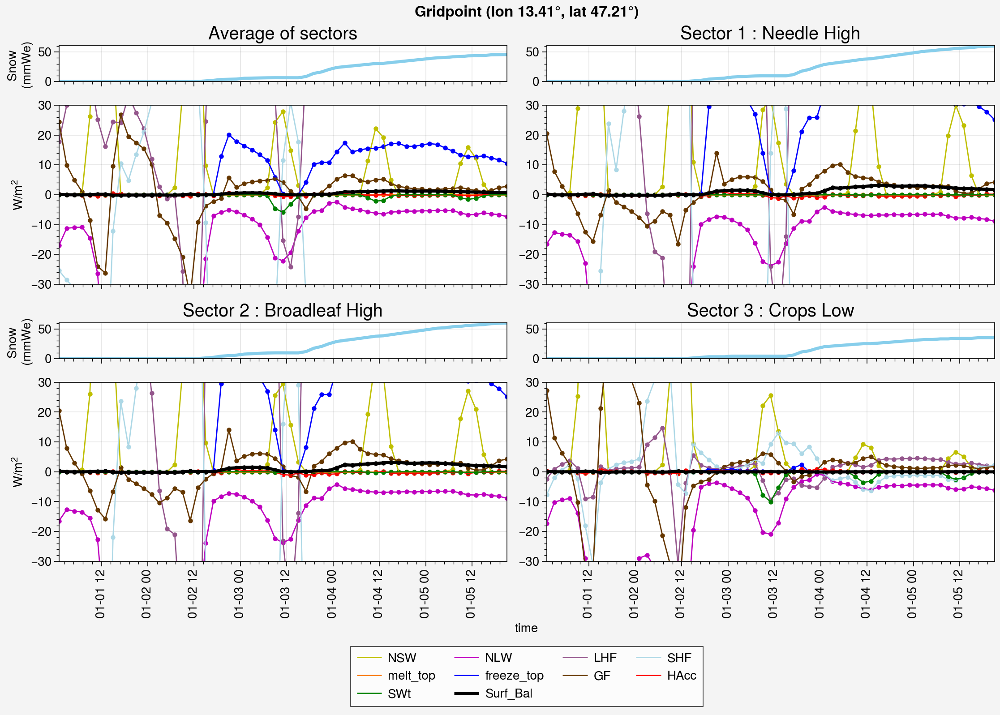

In [31]:
arr_e15_totfreeze = np.array(ds_e15_ave.freeze.sum(axis=0))
i_f, j_f = np.where(arr_e15_totfreeze==arr_e15_totfreeze.max())
print(i_f,j_f)
print(arr_e15_totfreeze.max())

plot_by_mosaic(ds_var = ds_e15_k, ds_var_ave = ds_e15_ave, first=0, last=-1, iloc = i_f, jloc = j_f, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2266328/1935158804.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  longitude_point = round(float(lon[iloc,jloc]),2)
/tmp/ipykernel_2266328/1935158804.py:17: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  latitude_point = round(float(lat[iloc,jloc]),2)
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize'

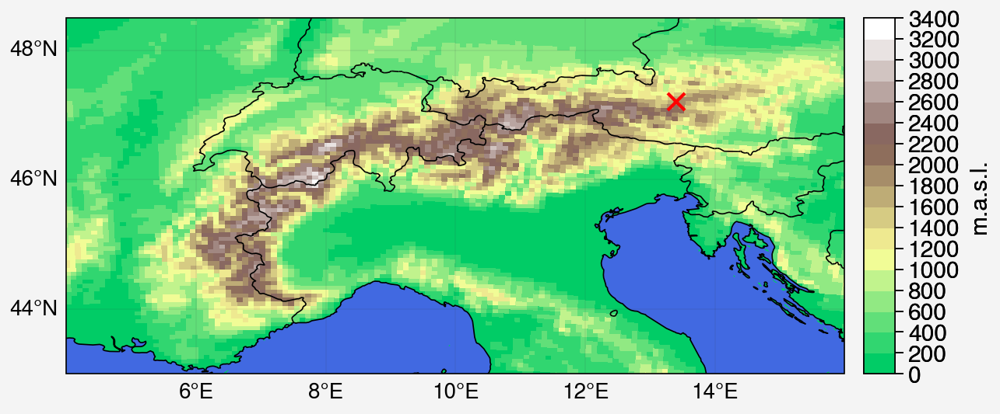

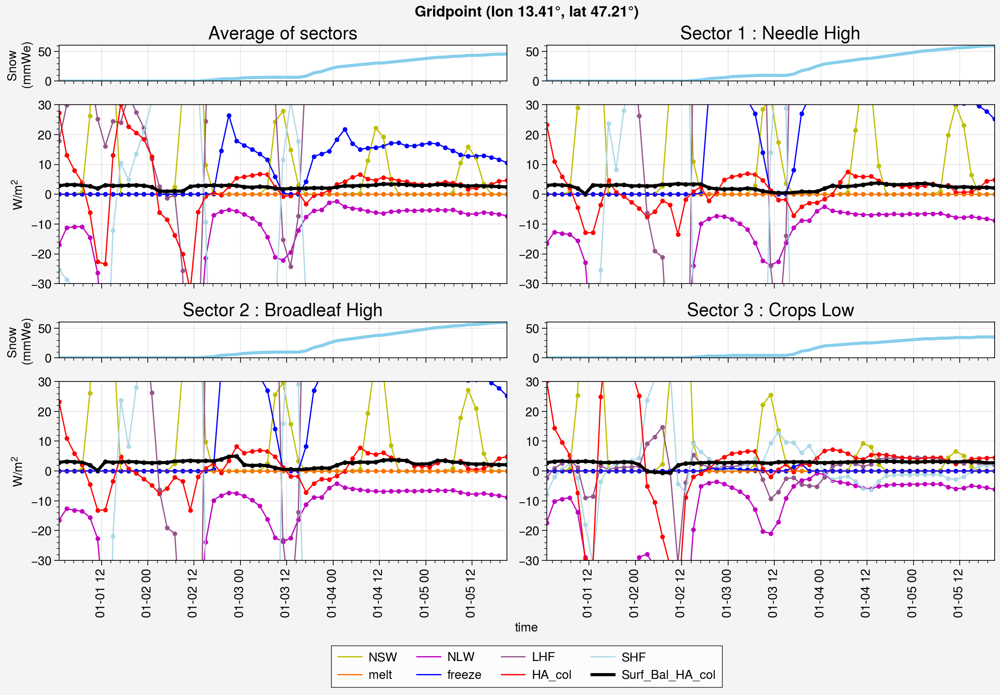

In [32]:
plot_by_mosaic(ds_var = ds_e15_k, ds_var_ave = ds_e15_ave, first=0, last=-1, iloc = i_f, jloc = j_f, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

[84] [92]
-443.32892


/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2266328/1935158804.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  longitude_point = round(float(lon[iloc,jloc]),2)
/tmp/ipykernel_2266328/1935158804.py:17: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  latitude_point = round(float(lat[iloc,jloc]),2)
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize'

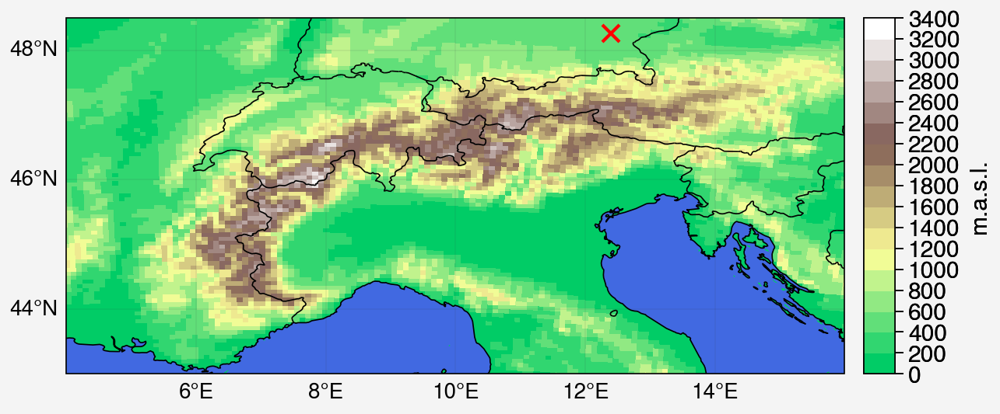

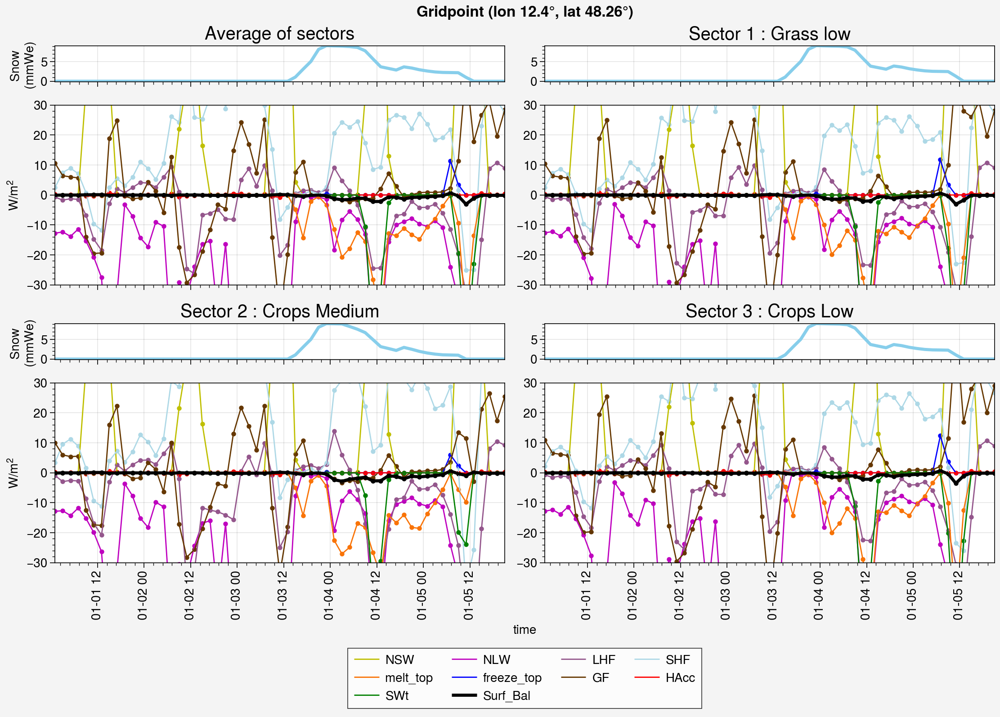

In [33]:
arr_e15_totmelt = np.array(ds_e15_ave.melt.sum(axis=0))
i_m, j_m = np.where(arr_e15_totmelt==arr_e15_totmelt.min())
print(i_m,j_m)
print(arr_e15_totmelt.min())

plot_by_mosaic(ds_var = ds_e15_k, ds_var_ave = ds_e15_ave, first=0, last=-1, iloc = i_m, jloc = j_m, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2266328/1935158804.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  longitude_point = round(float(lon[iloc,jloc]),2)
/tmp/ipykernel_2266328/1935158804.py:17: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  latitude_point = round(float(lat[iloc,jloc]),2)
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize'

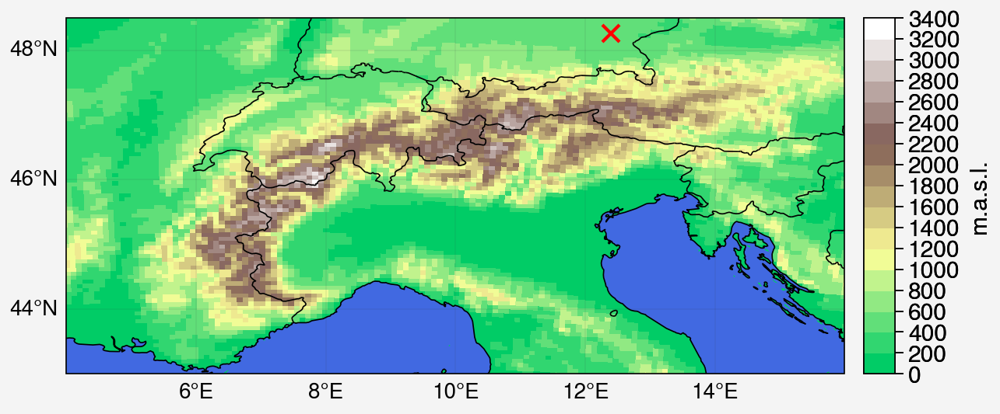

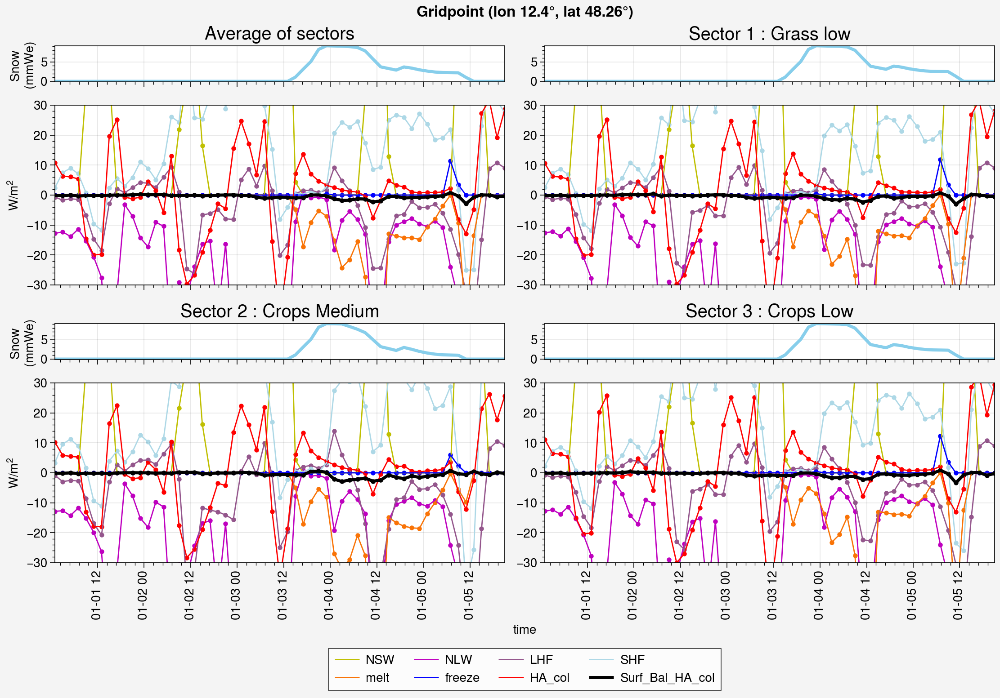

In [34]:
plot_by_mosaic(ds_var = ds_e15_k, ds_var_ave = ds_e15_ave, first=0, last=-1, iloc = i_m, jloc = j_m, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

#### e16 : July 01-05, with limit

In [ ]:
ds_e16_k = open_monthly_data_k(year='2015',month='07',days_in_month='05',sim='e16',day_average=False,HA_col=True,timestep_in_hours = 2)
ds_e16_ave = open_monthly_data_ave(year='2015',month='07',days_in_month='05',sim='e16',day_average=False,HA_col=True,timestep_in_hours = 2)

In [ ]:
ds_day = xr.open_dataset('/bettik/castelli/MARout/EUe/e16/2015/ICE.e16.2015.07.01-05.nc')[["ST2"]].isel(x=slice(imin,imax),y=slice(jmin,jmax))
ds_e16_k["ST2"] = ds_day["ST2"]

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_3496625/1228014436.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_3496625/1228014436.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


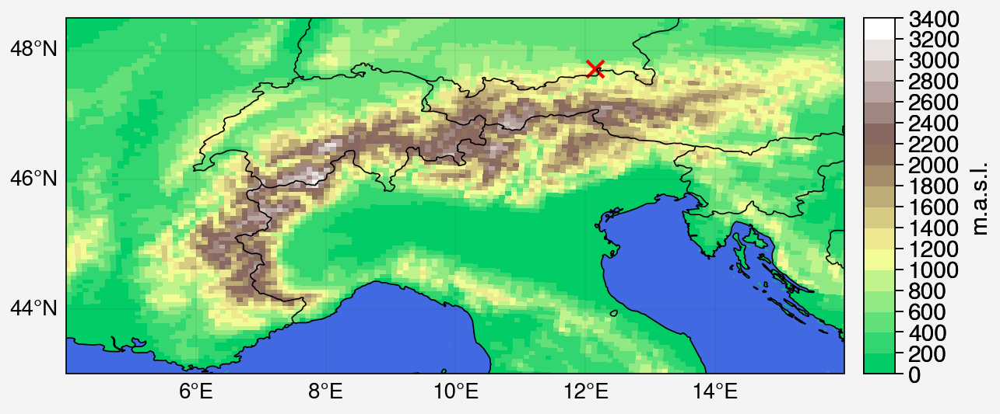

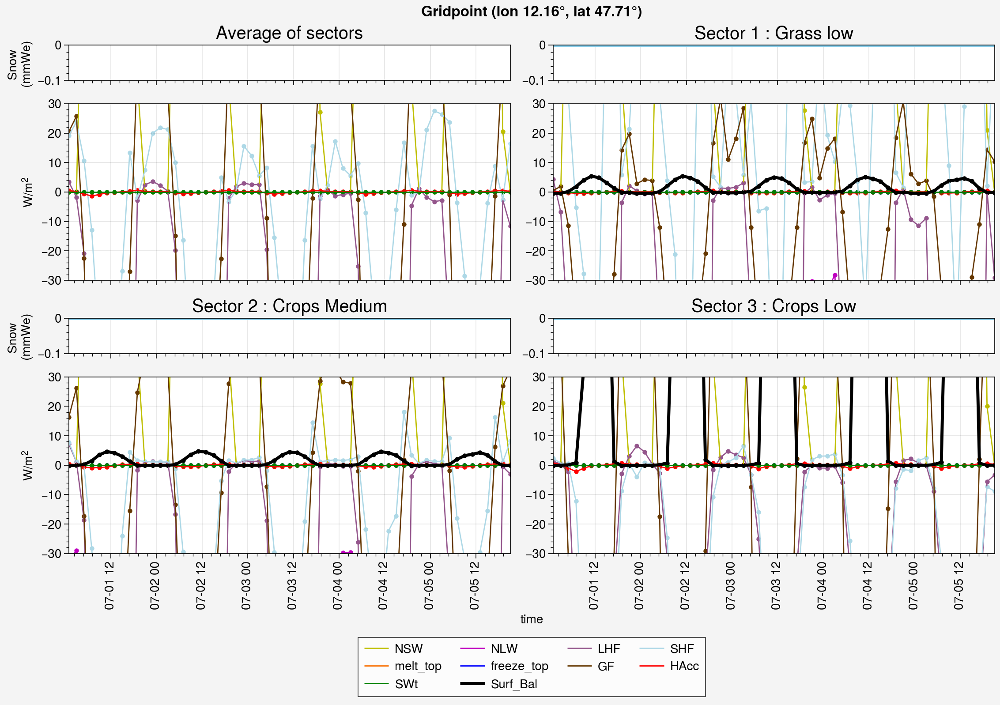

In [32]:
plot_by_mosaic(ds_var = ds_e16_k, ds_var_ave = ds_e16_ave, first=0, last=-1, iloc = i1, jloc = j1, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_3496625/1228014436.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_3496625/1228014436.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


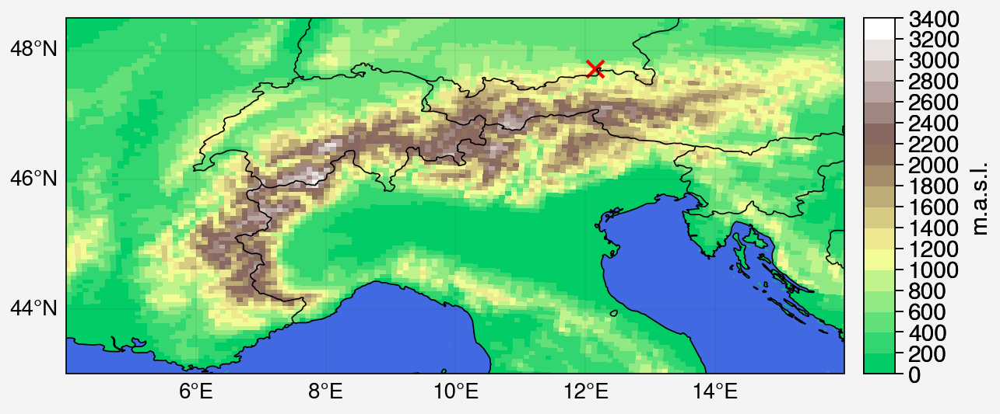

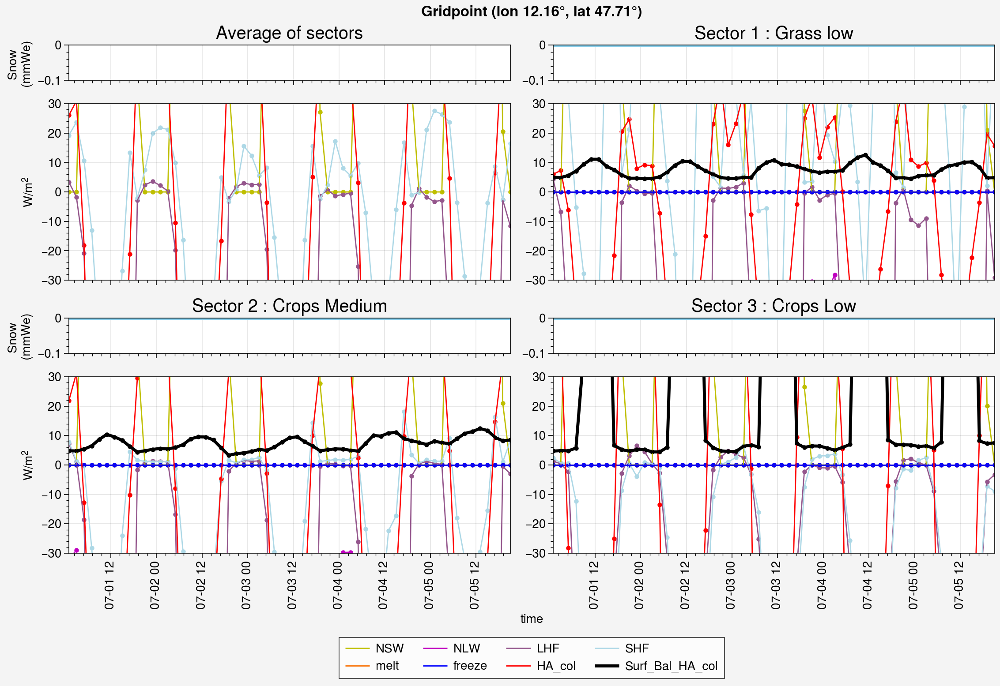

In [33]:
plot_by_mosaic(ds_var = ds_e16_k, ds_var_ave = ds_e16_ave, first=0, last=-1, iloc = i1, jloc = j1, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_3496625/1228014436.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_3496625/1228014436.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


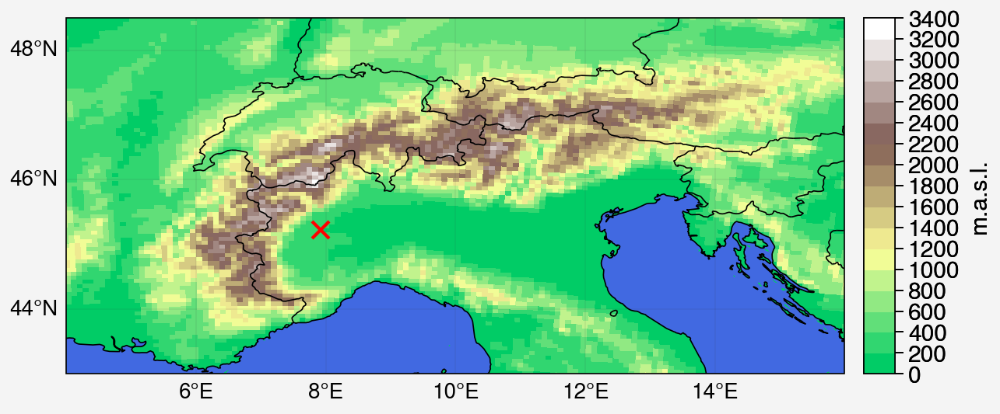

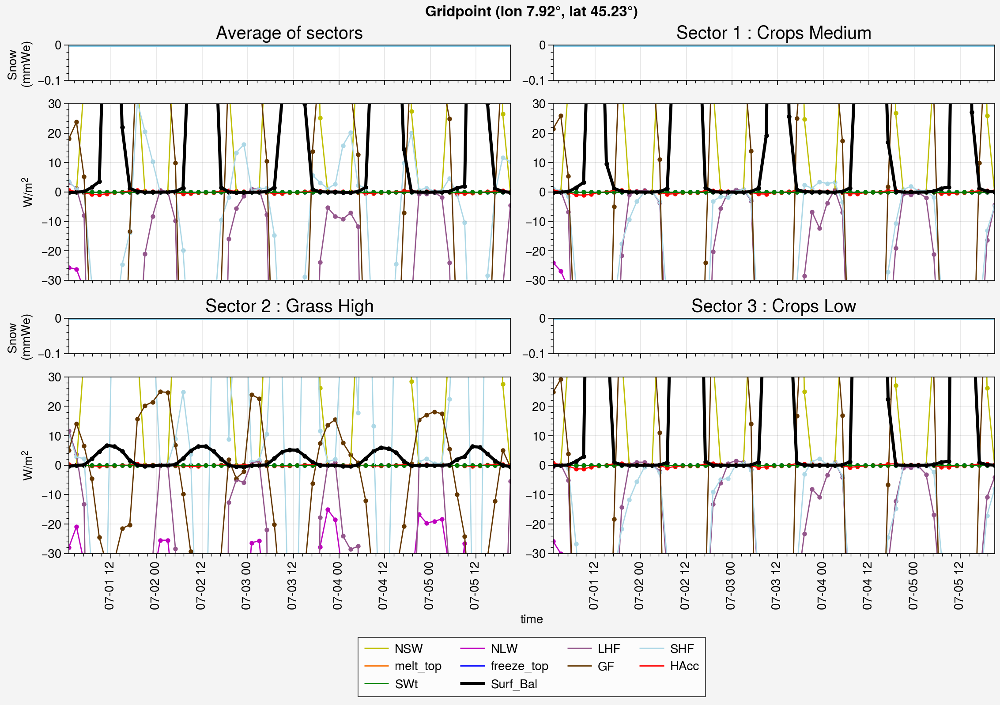

In [34]:
plot_by_mosaic(ds_var = ds_e16_k, ds_var_ave = ds_e16_ave, first=0, last=-1, iloc = i2, jloc = j2, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_3496625/1228014436.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_3496625/1228014436.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


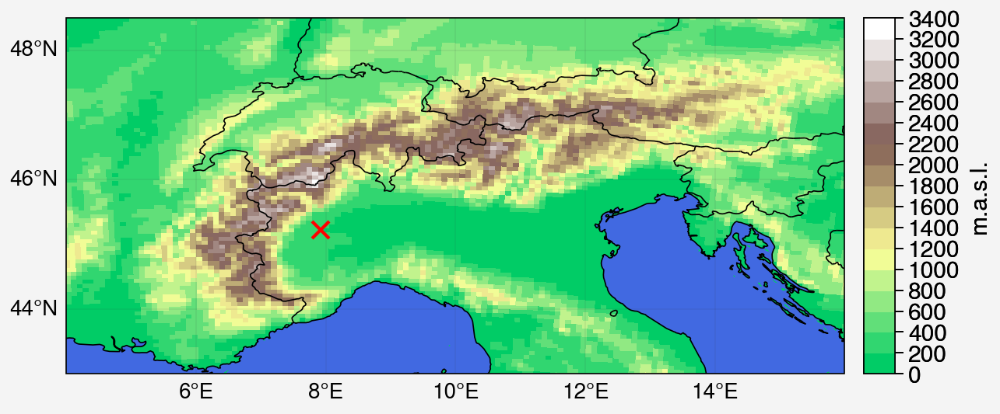

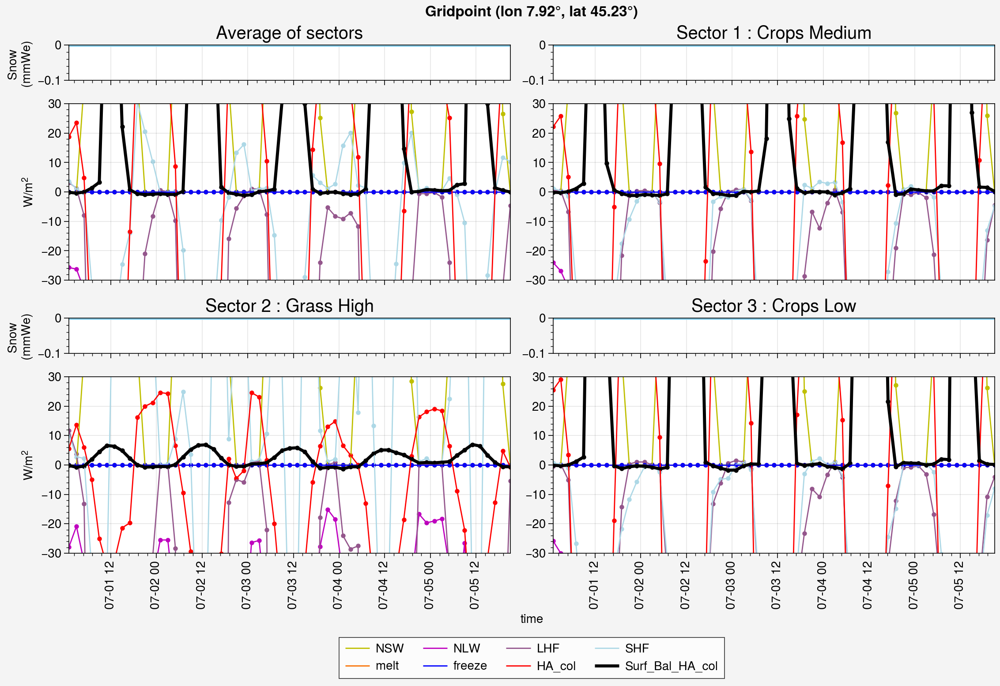

In [35]:
plot_by_mosaic(ds_var = ds_e16_k, ds_var_ave = ds_e16_ave, first=0, last=-1, iloc = i2, jloc = j2, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_3496625/1228014436.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_3496625/1228014436.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


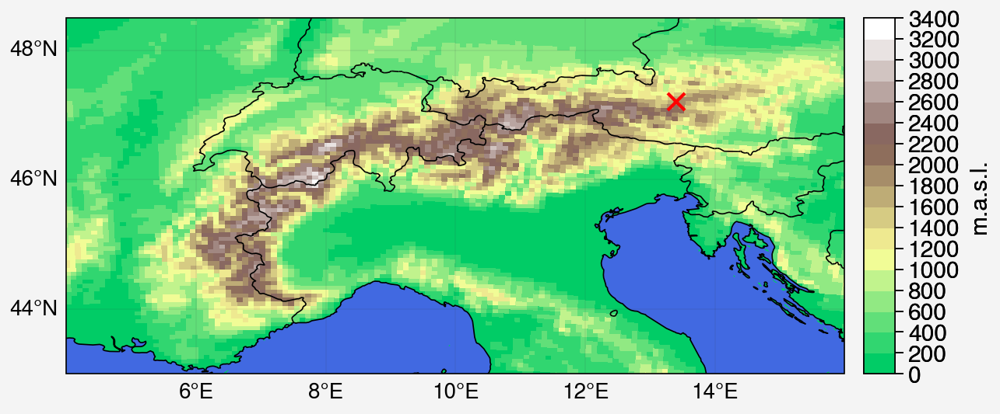

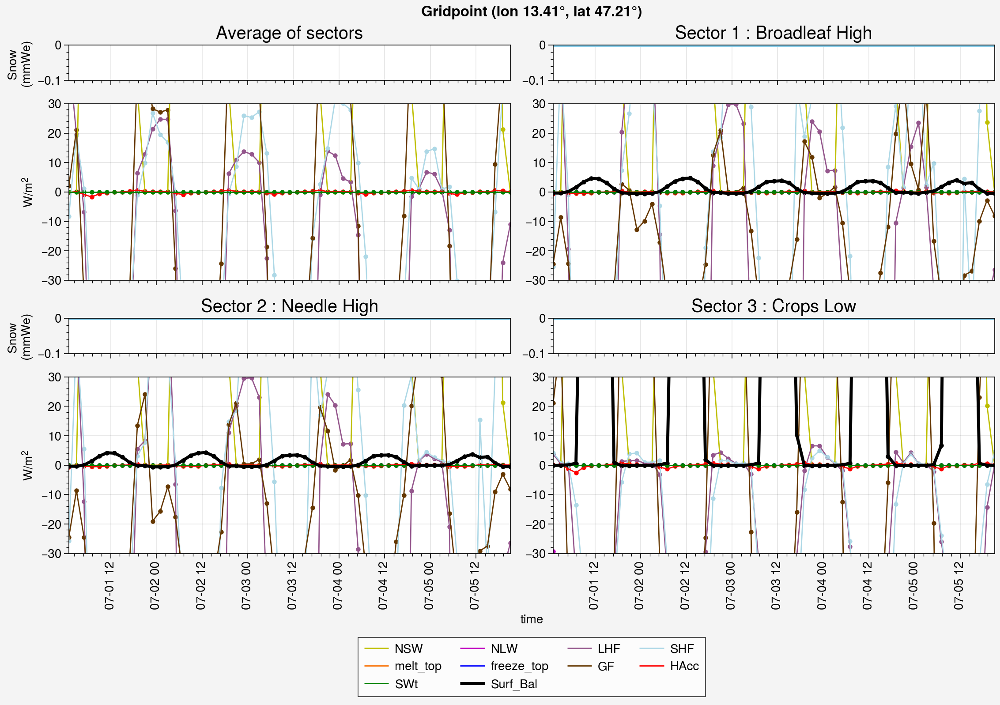

In [36]:
plot_by_mosaic(ds_var = ds_e16_k, ds_var_ave = ds_e16_ave, first=0, last=-1, iloc = i_f, jloc = j_f, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

In [ ]:
plot_by_mosaic(ds_var = ds_e16_k, ds_var_ave = ds_e16_ave, first=0, last=-1, iloc = i_f, jloc = j_f, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

In [ ]:
plot_by_mosaic(ds_var = ds_e16_k, ds_var_ave = ds_e16_ave, first=0, last=-1, iloc = i_m, jloc = j_m, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

In [ ]:
plot_by_mosaic(ds_var = ds_e16_k, ds_var_ave = ds_e16_ave, first=0, last=-1, iloc = i_m, jloc = j_m, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

#### e17 : July 01-05, without limit

In [ ]:
ds_e17_k = open_monthly_data_k(year='2015',month='07',days_in_month='05',sim='e17',day_average=False,HA_col=True,timestep_in_hours = 2)
ds_e17_ave = open_monthly_data_ave(year='2015',month='07',days_in_month='05',sim='e17',day_average=False,HA_col=True,timestep_in_hours = 2)

In [ ]:
ds_day = xr.open_dataset('/bettik/castelli/MARout/EUe/e17/2015/ICE.e17.2015.07.01-05.nc')[["ST2"]].isel(x=slice(imin,imax),y=slice(jmin,jmax))
ds_e17_k["ST2"] = ds_day["ST2"]

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


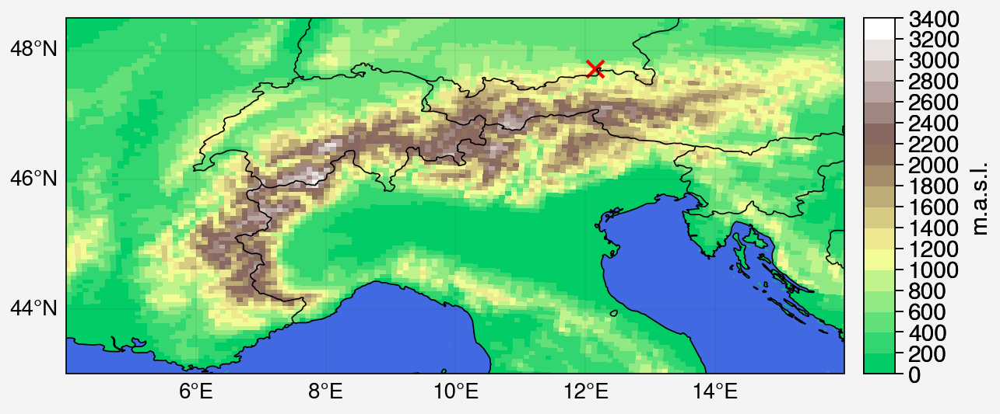

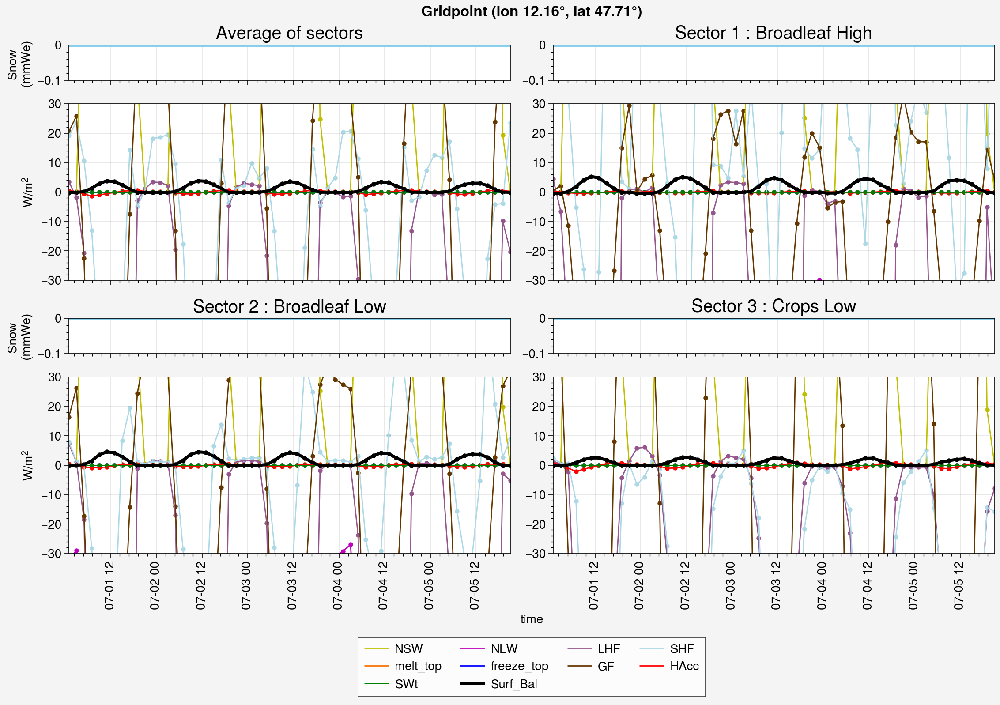

In [47]:
plot_by_mosaic(ds_var = ds_e17_k, ds_var_ave = ds_e17_ave, first=0, last=-1, iloc = i1, jloc = j1, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


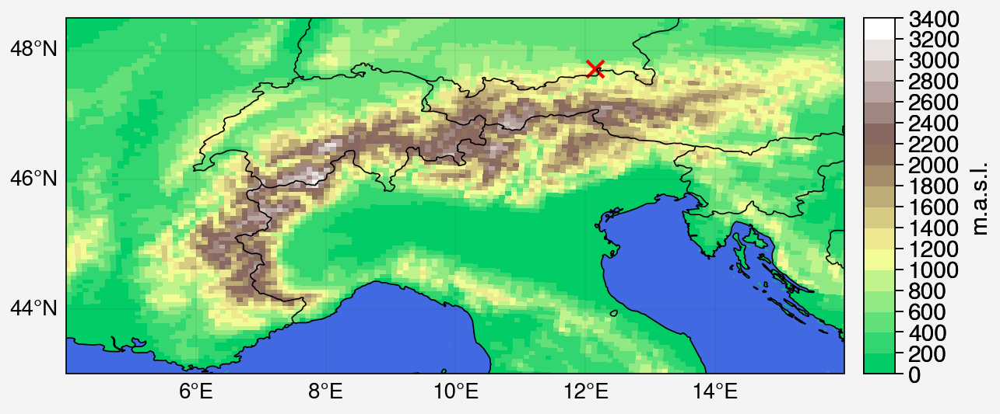

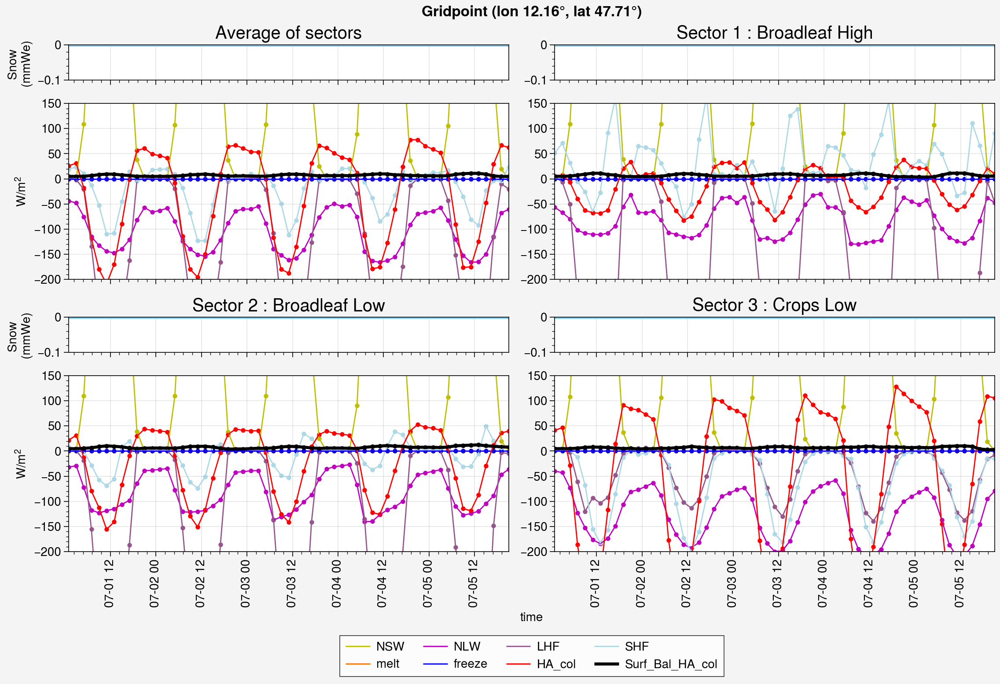

In [48]:
plot_by_mosaic(ds_var = ds_e17_k, ds_var_ave = ds_e17_ave, first=0, last=-1, iloc = i1, jloc = j1, ymin = -200, ymax = 150,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


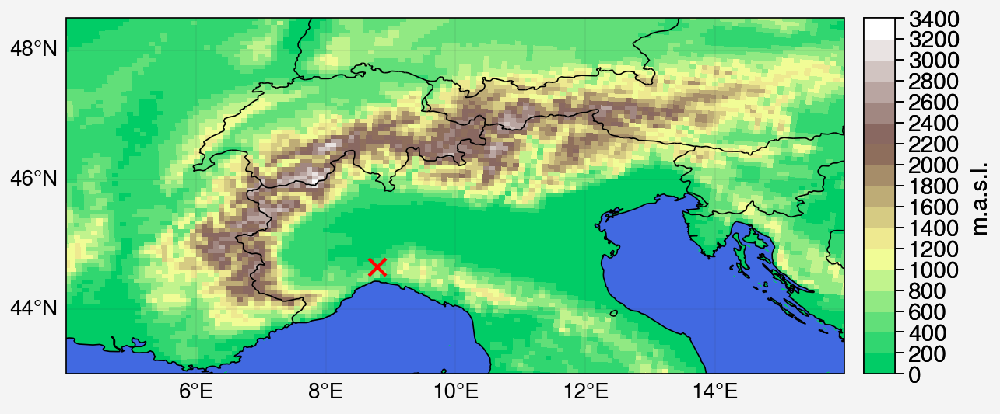

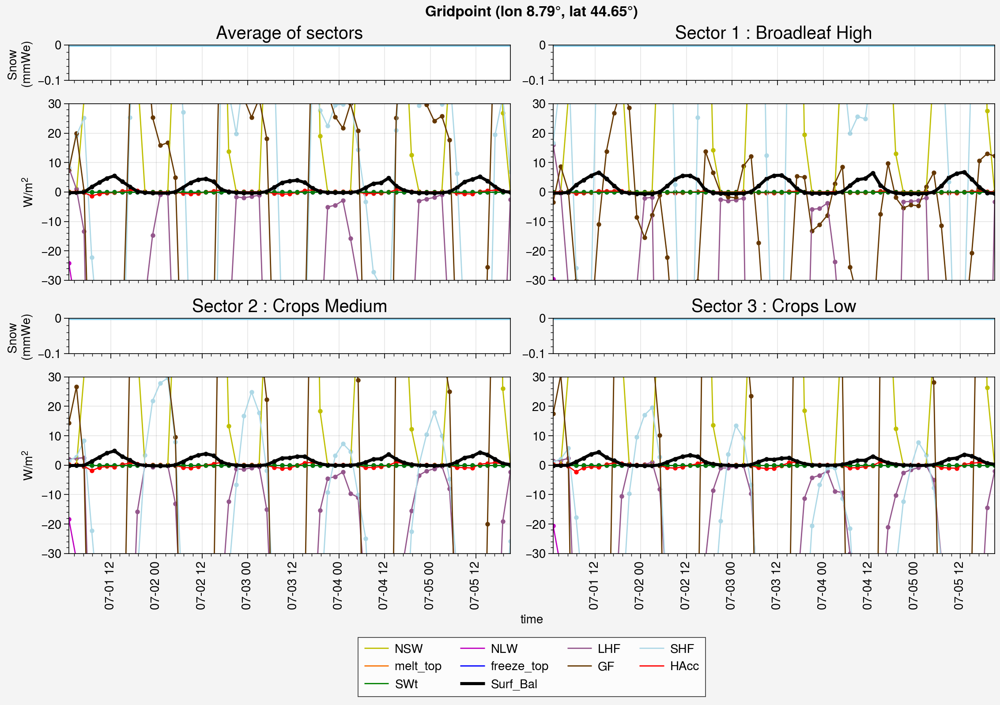

In [49]:
plot_by_mosaic(ds_var = ds_e17_k, ds_var_ave = ds_e17_ave, first=0, last=-1, iloc = i2, jloc = j2, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


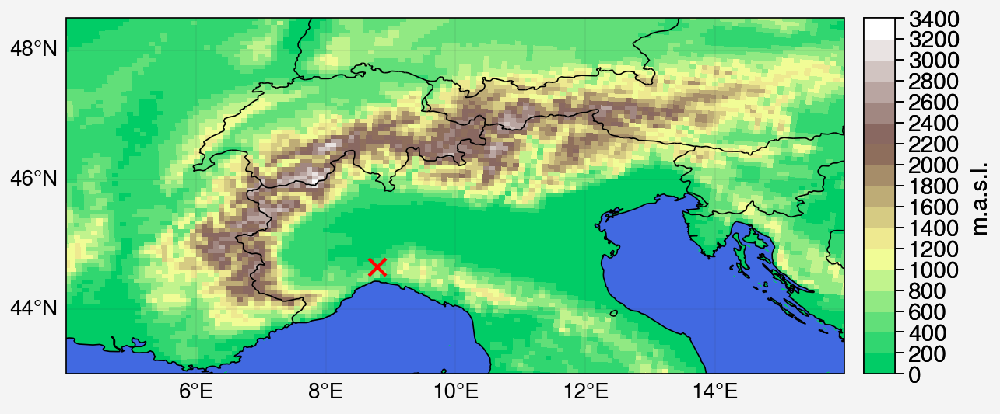

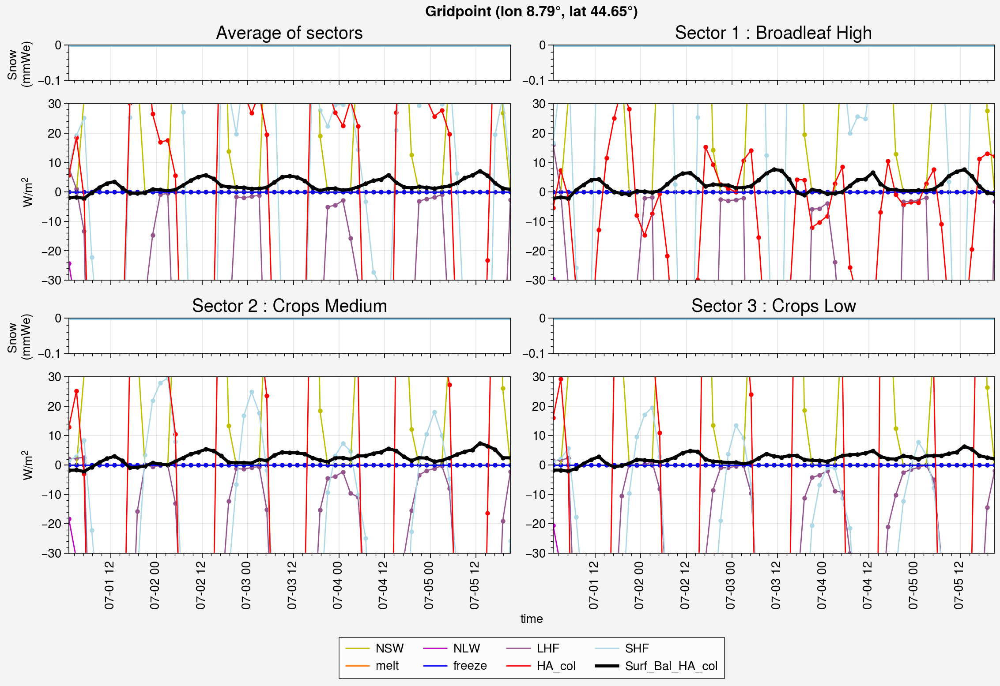

In [50]:
plot_by_mosaic(ds_var = ds_e17_k, ds_var_ave = ds_e17_ave, first=0, last=-1, iloc = i2, jloc = j2, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2266328/1935158804.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  longitude_point = round(float(lon[iloc,jloc]),2)
/tmp/ipykernel_2266328/1935158804.py:17: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  latitude_point = round(float(lat[iloc,jloc]),2)
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize'

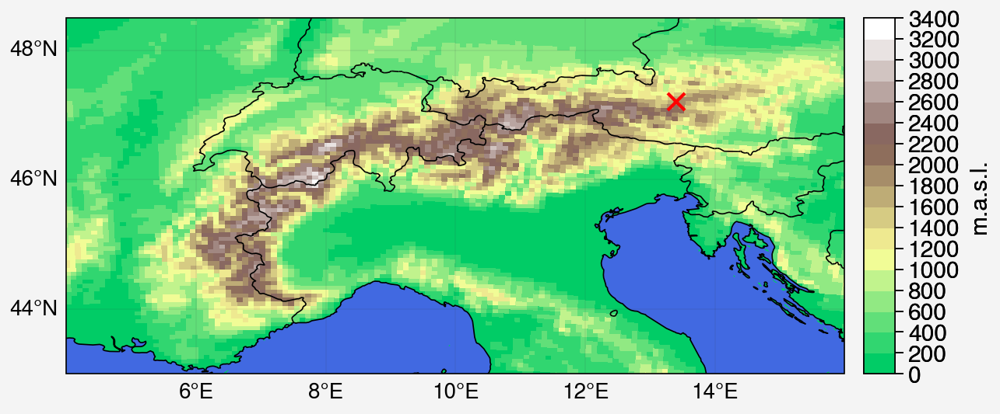

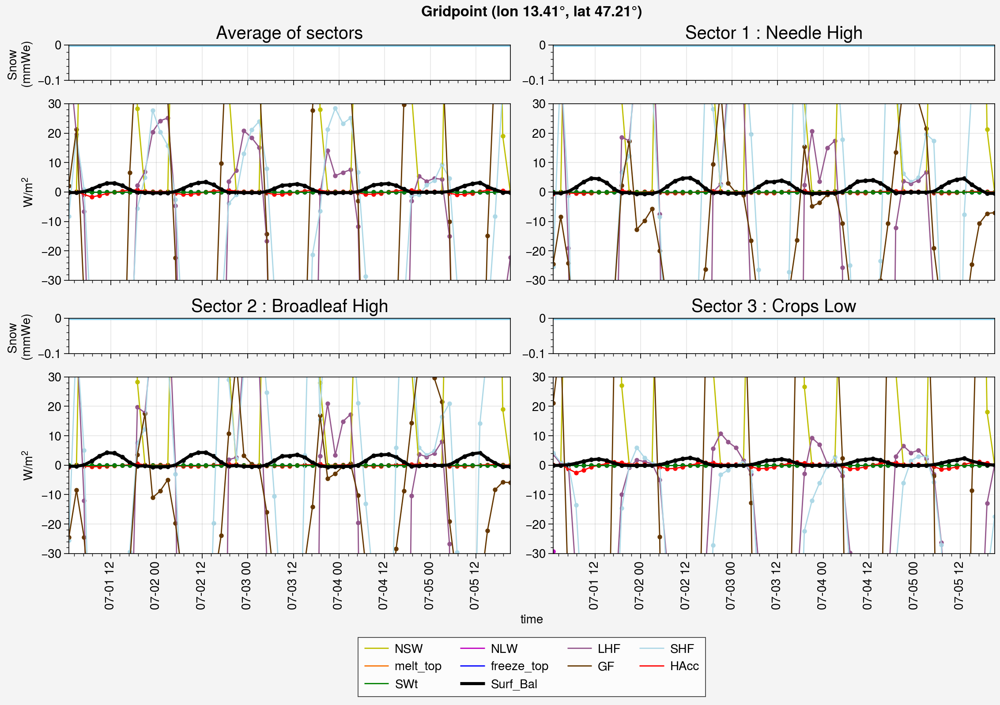

In [51]:
plot_by_mosaic(ds_var = ds_e17_k, ds_var_ave = ds_e17_ave, first=0, last=-1, iloc = i_f, jloc = j_f, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2266328/1935158804.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  longitude_point = round(float(lon[iloc,jloc]),2)
/tmp/ipykernel_2266328/1935158804.py:17: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  latitude_point = round(float(lat[iloc,jloc]),2)
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize'

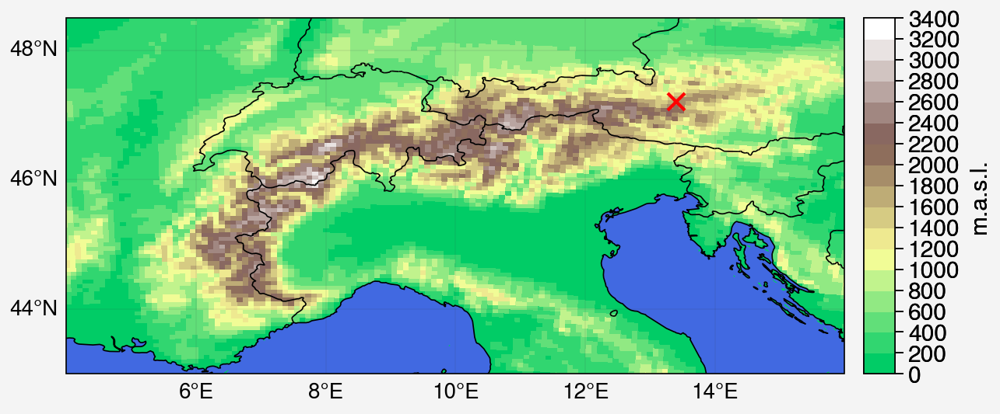

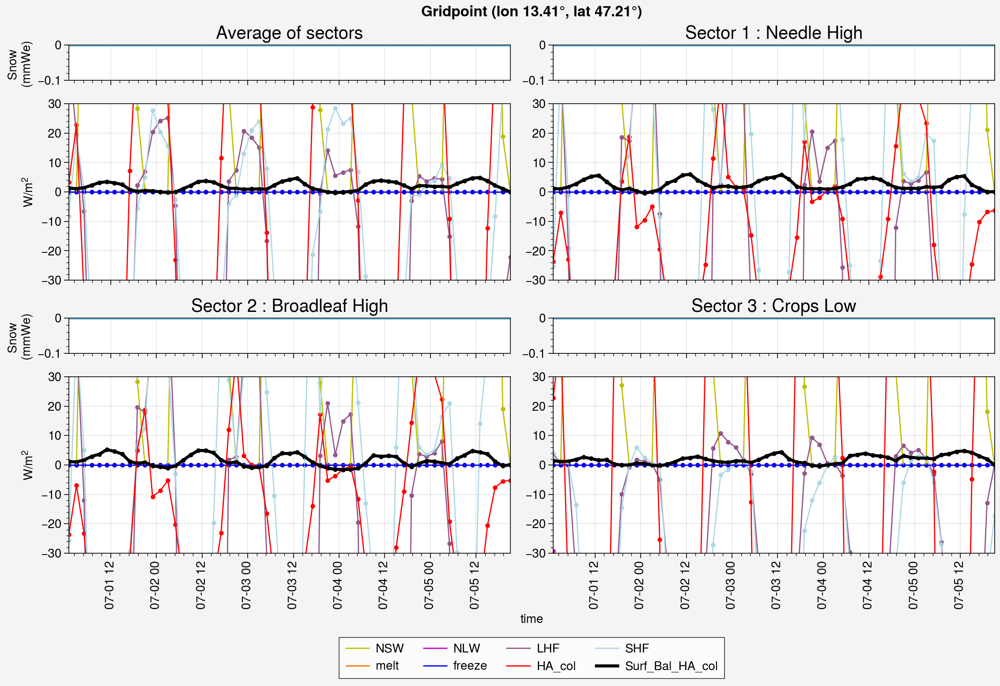

In [52]:
plot_by_mosaic(ds_var = ds_e17_k, ds_var_ave = ds_e17_ave, first=0, last=-1, iloc = i_f, jloc = j_f, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2266328/1935158804.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  longitude_point = round(float(lon[iloc,jloc]),2)
/tmp/ipykernel_2266328/1935158804.py:17: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  latitude_point = round(float(lat[iloc,jloc]),2)
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize'

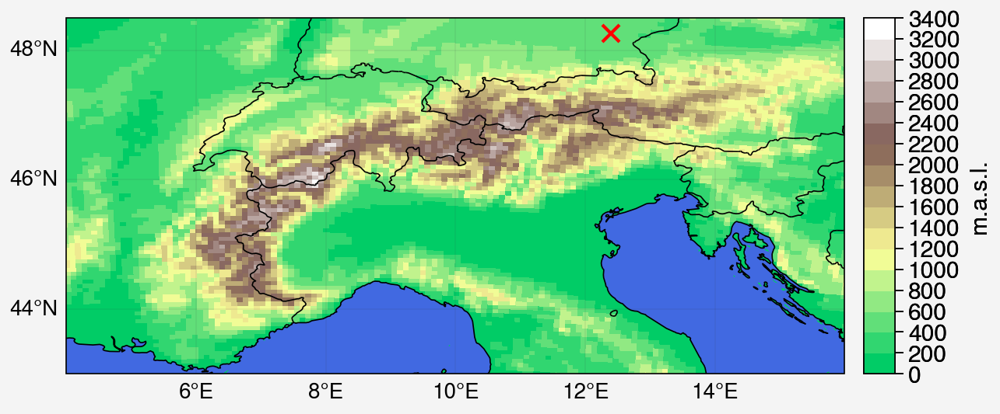

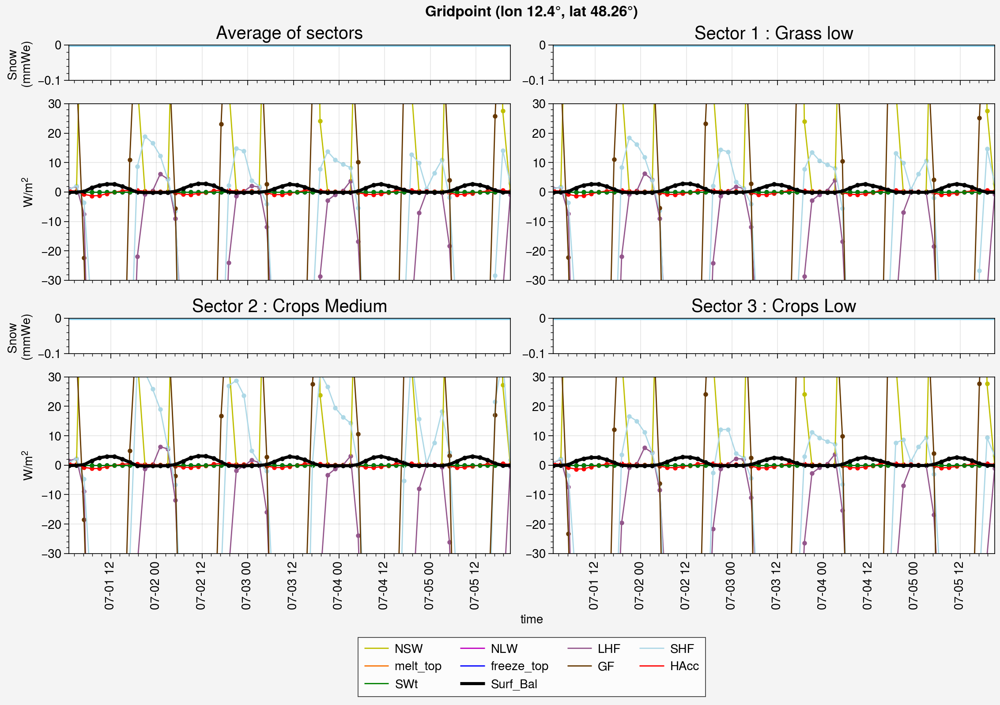

In [53]:
plot_by_mosaic(ds_var = ds_e17_k, ds_var_ave = ds_e17_ave, first=0, last=-1, iloc = i_m, jloc = j_m, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2266328/1935158804.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  longitude_point = round(float(lon[iloc,jloc]),2)
/tmp/ipykernel_2266328/1935158804.py:17: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  latitude_point = round(float(lat[iloc,jloc]),2)
/tmp/ipykernel_2266328/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize'

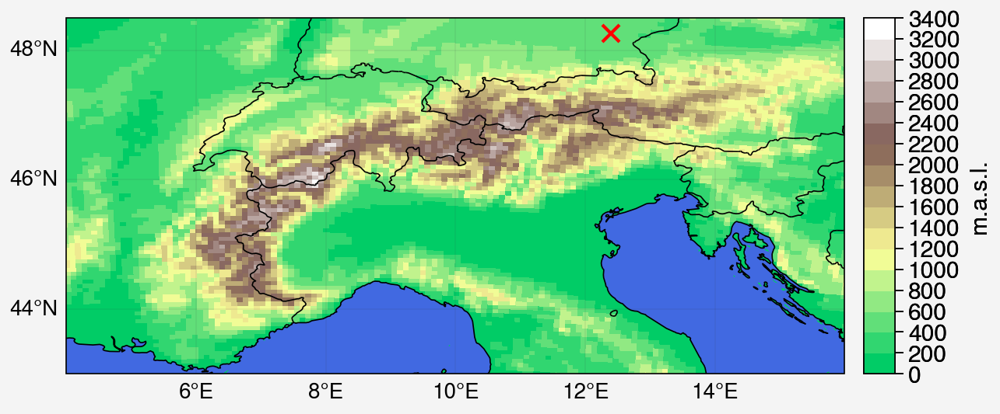

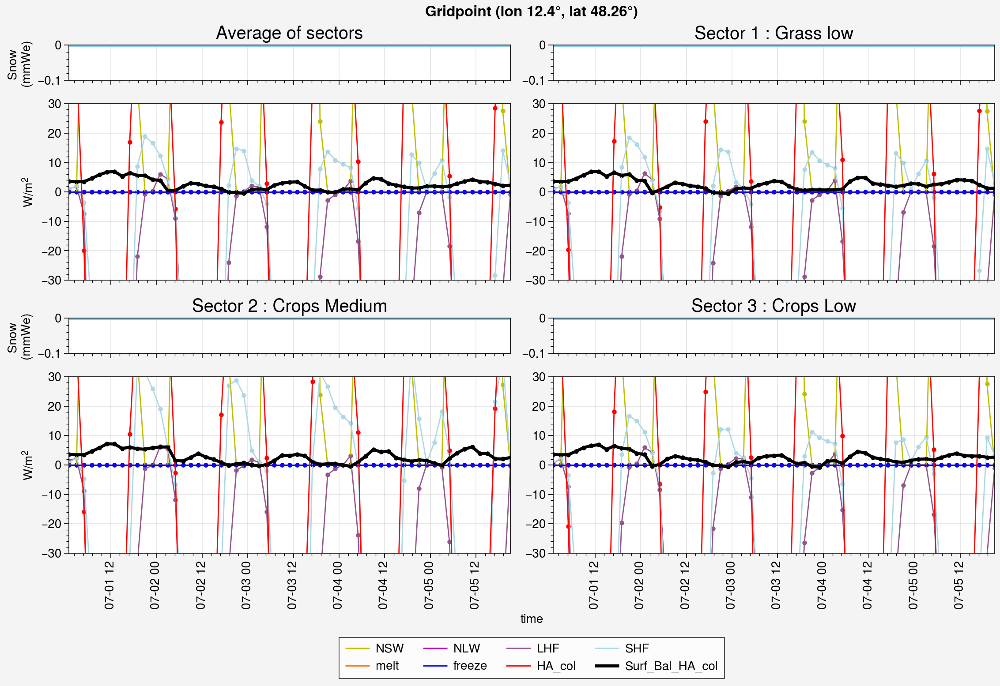

In [54]:
plot_by_mosaic(ds_var = ds_e17_k, ds_var_ave = ds_e17_ave, first=0, last=-1, iloc = i_m, jloc = j_m, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

In [69]:
itest = i1
jtest = j1

print(ds_e14_k.FRV[:,itest,jtest].values)

print(ds_e14_k.VEG[:,itest,jtest].values)

[32.478634 18.803417 48.71795 ]
[9. 7. 1.]


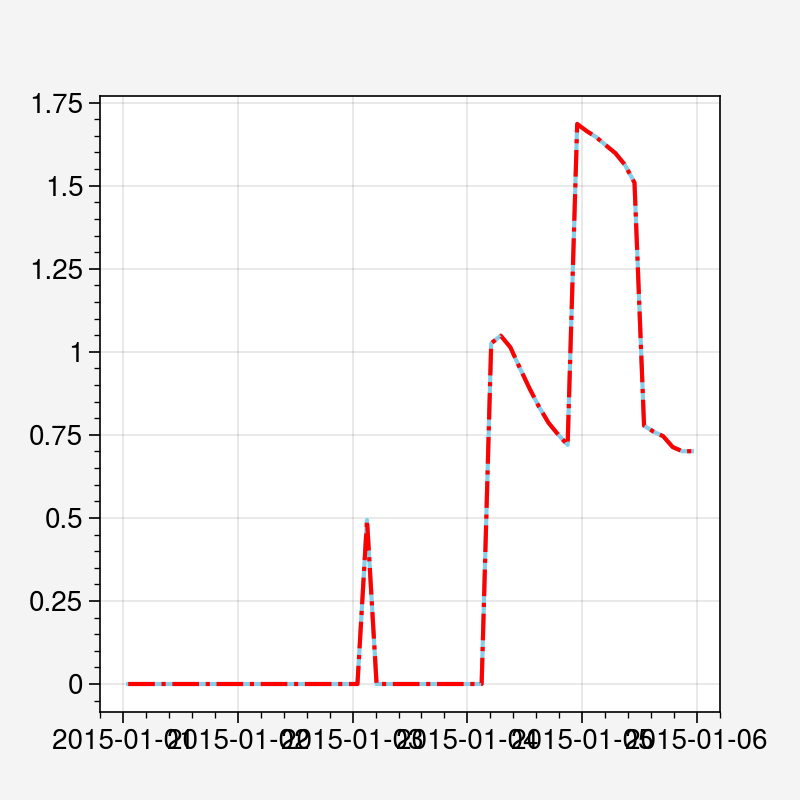

In [81]:
iloc = i1
jloc = j1

plt.plot(ds_e14_ave.time[:], np.array(ds_e14_ave['MBave'])[:,iloc,jloc], c='skyblue')
    
#plt.plot(ds_e14_k.time[:], np.array(ds_e14_k['MB'].sel(sector="1.0"))[:,iloc,jloc], c='skyblue',linestyle=':')
#plt.plot(ds_e14_k.time[:], np.array(ds_e14_k['MB'].sel(sector="2.0"))[:,iloc,jloc], c='skyblue',linestyle='--')
#plt.plot(ds_e14_k.time[:], np.array(ds_e14_k['MB'].sel(sector="3.0"))[:,iloc,jloc], c='skyblue',linestyle='-.')

plt.plot(ds_e14_k.time[:], np.array(ds_e14_k['MB'].sel(sector="3.0"))[:,iloc,jloc]*np.array(ds_e14_k.FRV.sel(sector="3.0")[itest,jtest]/100) \
         + np.array(ds_e14_k['MB'].sel(sector="2.0"))[:,iloc,jloc]*np.array(ds_e14_k.FRV.sel(sector="2.0")[itest,jtest]/100) \
         + np.array(ds_e14_k['MB'].sel(sector="1.0"))[:,iloc,jloc]*np.array(ds_e14_k.FRV.sel(sector="1.0")[itest,jtest]/100), c='red',linestyle='-.')


### EUf : 60x60 domain

In [19]:
ds = xr.open_dataset('/bettik/castelli/MARout/EUf/f29/2100/ICE.f29.2100.01.01-31.nc')[["LON","LAT","SH","FRV","VEG"]]

ds

<xarray.Dataset>
Dimensions:  (y: 60, x: 60, sector: 3)
Coordinates:
  * x        (x) float32 -203.0 -196.0 -189.0 -182.0 ... 189.0 196.0 203.0 210.0
  * y        (y) float32 -203.0 -196.0 -189.0 -182.0 ... 189.0 196.0 203.0 210.0
  * sector   (sector) float32 1.0 2.0 3.0
Data variables:
    LON      (y, x) float32 ...
    LAT      (y, x) float32 ...
    SH       (y, x) float32 ...
    FRV      (sector, y, x) float32 ...
    VEG      (sector, y, x) float32 ...
Attributes:
    title:        ICE - Exp: f29 - 21000101
    institution:  ULg (Xavier Fettweis)
    history:      libUN (2005.04.08) - Tue May 20 17:22:26 2025
    netcdf:       4.8.0 of May  2 2023 12:43:48 $

In [20]:
vars = ["LON", "LAT", "FRV", "VEG", "SH", "GF", "SWD", "SWU", "LWD", "LWU", "SHF", "LHF", "HAcc", "HA_col", "SWt", "MB", "MBm", "MBmTop", "MBr", "MBrTop"]

ds_2100 = open_yearly_data(year = '2100', sim = 'EUf', vars = vars, timestep_in_hours = 4)

In [21]:
ds_2100

<xarray.Dataset>
Dimensions:     (time: 2190, ztqlev: 3, y: 60, x: 60, sector: 3)
Coordinates:
  * time        (time) datetime64[ns] 2100-01-01T02:00:00 ... 2100-12-31T22:0...
  * x           (x) float32 -203.0 -196.0 -189.0 -182.0 ... 196.0 203.0 210.0
  * y           (y) float32 -203.0 -196.0 -189.0 -182.0 ... 196.0 203.0 210.0
  * ztqlev      (ztqlev) float32 2.0 10.0 100.0
  * sector      (sector) float32 1.0 2.0 3.0
Data variables: (12/30)
    TTz         (time, ztqlev, y, x) float32 ...
    LON         (y, x) float32 ...
    LAT         (y, x) float32 ...
    FRV         (sector, y, x) float32 ...
    VEG         (sector, y, x) float32 ...
    SH          (y, x) float32 ...
    ...          ...
    freeze      (time, y, x) float32 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    melt_top    (time, y, x) float32 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    freeze_top  (time, y, x) float32 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    TT2         (time, y, x) float32 ...
    MBave       (time, y, x) float32 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    Surf_Bal    (time, y, x) float32 0.0 310.4 310.5 310.6 ... 216.1 215.5 0.0
Attributes:
    title:        ICE - Exp: f29 - 21000101
    institution:  ULg (Xavier Fettweis)
    history:      Wed May 21 12:34:39 2025: ncks -v TTz /bettik/castelli/MARo...
    netcdf:       4.8.0 of May  2 2023 12:43:48 $
    NCO:          netCDF Operators version 5.0.6 (Homepage = http://nco.sf.ne...

In [22]:
ds_2100_month = ds_2100.groupby('time.month').mean(dim="time")

ds_2100_month

<xarray.Dataset>
Dimensions:     (month: 12, ztqlev: 3, y: 60, x: 60, sector: 3)
Coordinates:
  * x           (x) float32 -203.0 -196.0 -189.0 -182.0 ... 196.0 203.0 210.0
  * y           (y) float32 -203.0 -196.0 -189.0 -182.0 ... 196.0 203.0 210.0
  * ztqlev      (ztqlev) float32 2.0 10.0 100.0
  * sector      (sector) float32 1.0 2.0 3.0
  * month       (month) int64 1 2 3 4 5 6 7 8 9 10 11 12
Data variables: (12/30)
    TTz         (month, ztqlev, y, x) float32 16.12 16.14 ... -5.447 -5.558
    LON         (month, y, x) float32 4.501 4.587 4.673 ... 9.574 9.666 9.758
    LAT         (month, y, x) float32 43.15 43.15 43.15 ... 46.86 46.86 46.85
    FRV         (month, sector, y, x) float32 100.0 100.0 100.0 ... 58.97 64.1
    VEG         (month, sector, y, x) float32 0.0 0.0 0.0 0.0 ... 1.0 1.0 1.0
    SH          (month, y, x) float32 0.0 0.0 0.0 ... 1.628e+03 1.643e+03
    ...          ...
    freeze      (month, y, x) float32 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
    melt_top    (month, y, x) float32 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
    freeze_top  (month, y, x) float32 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
    TT2         (month, y, x) float32 16.12 16.14 16.16 ... -4.283 -4.471 -4.583
    MBave       (month, y, x) float32 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
    Surf_Bal    (month, y, x) float32 0.0 382.3 382.4 382.6 ... 274.8 274.1 0.0
Attributes:
    title:        ICE - Exp: f29 - 21000101
    institution:  ULg (Xavier Fettweis)
    history:      Wed May 21 12:34:39 2025: ncks -v TTz /bettik/castelli/MARo...
    netcdf:       4.8.0 of May  2 2023 12:43:48 $
    NCO:          netCDF Operators version 5.0.6 (Homepage = http://nco.sf.ne...

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_4051249/3309161639.py:20: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_4051249/3309161639.py:20: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


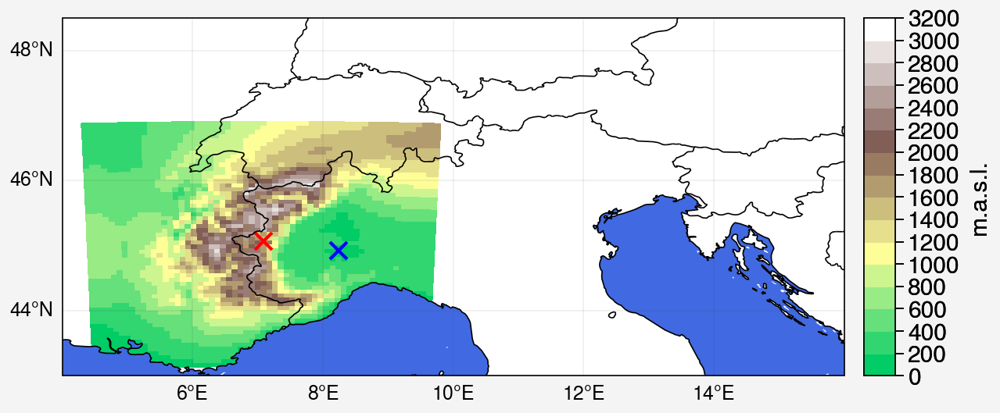

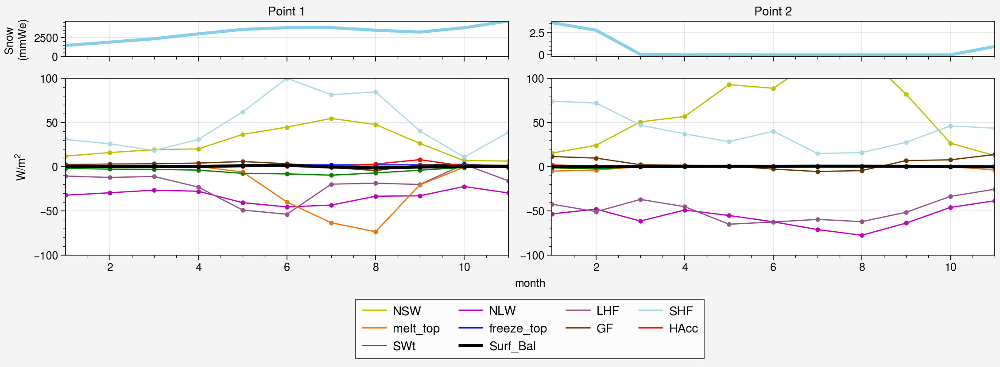

In [23]:
plot_monthly_2points(ds_var = ds_2100_month, first=0, last=-1, iloc1 = 30, jloc1 = 30, iloc2 = 28, jloc2 = 43, ymin = -100, ymax = 100,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

In [24]:
ds_EUf2100_k = open_monthly_data_k(year='2100',month='01',days_in_month='31',sim='f29',day_average=False,HA_col=True,timestep_in_hours = 4,
                                   imin = 0, imax = -1, jmin = 0, jmax = -1)
ds_EUf2100_ave = open_monthly_data_ave(year='2100',month='01',days_in_month='31',sim='f29',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

test
test
test
test
test
test
test
test


/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_4051249/2692505537.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_4051249/2692505537.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


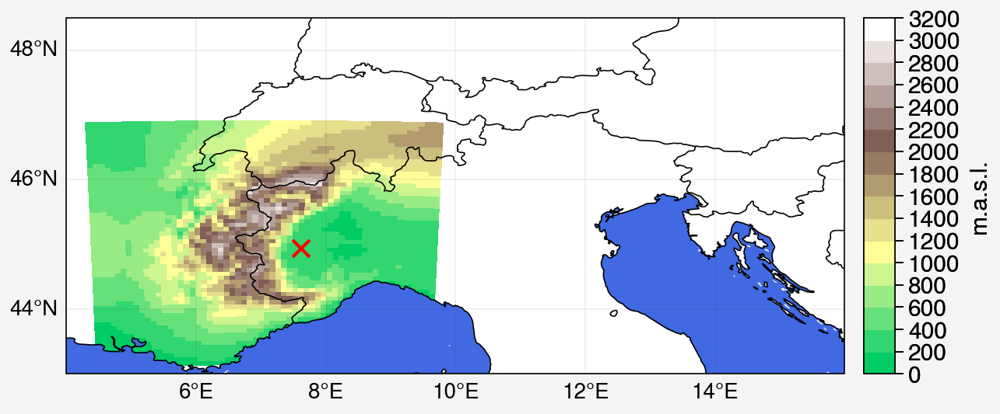

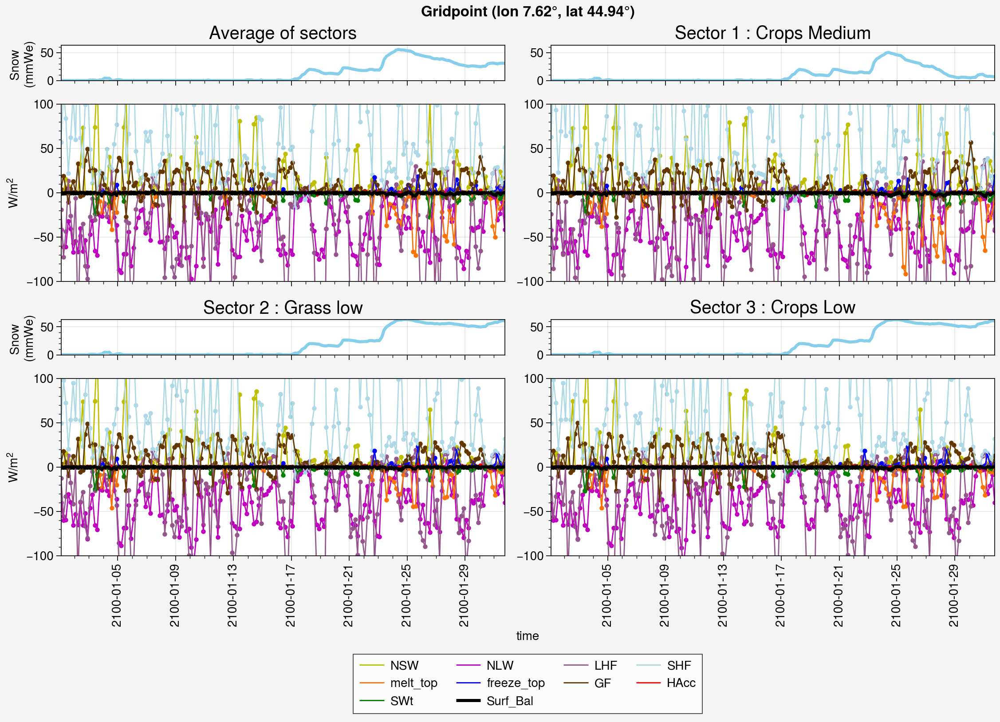

In [25]:
plot_by_mosaic2(ds_var = ds_EUf2100_k, ds_var_ave = ds_EUf2100_ave, first=0, last=-1, iloc = 28, jloc = 36, ymin = -100, ymax = 100,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

In [23]:
ds_EUf2100_k = open_monthly_data_k(year='2100',month='08',days_in_month='31',sim='f29',day_average=False,HA_col=True,timestep_in_hours = 4,
                                   imin = 0, imax = -1, jmin = 0, jmax = -1)
ds_EUf2100_ave = open_monthly_data_ave(year='2100',month='08',days_in_month='31',sim='f29',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_411682/2891066162.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_411682/2891066162.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


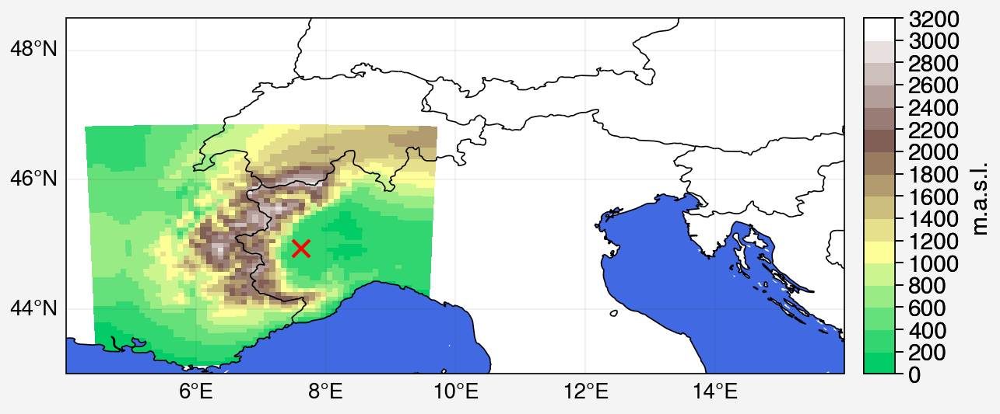

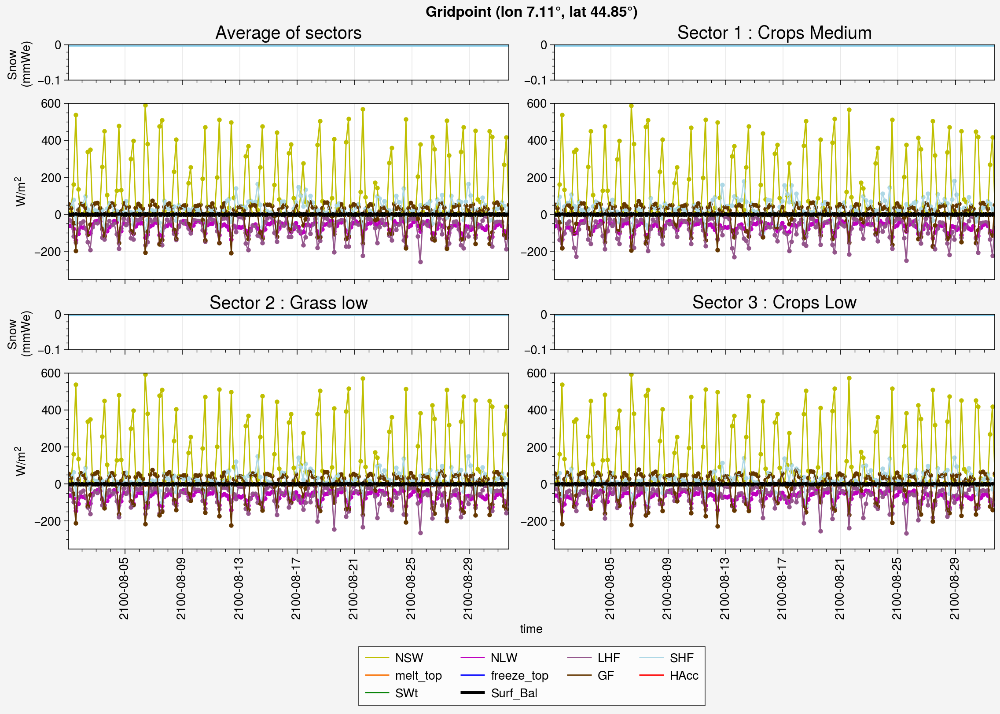

In [32]:
plot_by_mosaic2(ds_var = ds_EUf2100_k, ds_var_ave = ds_EUf2100_ave, first=0, last=-1, iloc = 28, jloc = 36, ymin = -350, ymax = 600,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

In [29]:
ds_EUf2099_09_ave = open_monthly_data_ave(year='2099',month='09',days_in_month='30',sim='f29',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUf2099_10_ave = open_monthly_data_ave(year='2099',month='10',days_in_month='31',sim='f29',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUf2099_11_ave = open_monthly_data_ave(year='2099',month='11',days_in_month='30',sim='f29',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUf2099_12_ave = open_monthly_data_ave(year='2099',month='12',days_in_month='31',sim='f29',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUf2100_01_ave = open_monthly_data_ave(year='2100',month='01',days_in_month='31',sim='f29',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUf2100_02_ave = open_monthly_data_ave(year='2100',month='02',days_in_month='28',sim='f29',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUf2100_03_ave = open_monthly_data_ave(year='2100',month='03',days_in_month='31',sim='f29',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUf2100_04_ave = open_monthly_data_ave(year='2100',month='04',days_in_month='30',sim='f29',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUf2100_05_ave = open_monthly_data_ave(year='2100',month='05',days_in_month='31',sim='f29',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUf2100_06_ave = open_monthly_data_ave(year='2100',month='06',days_in_month='30',sim='f29',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUf2100_07_ave = open_monthly_data_ave(year='2100',month='07',days_in_month='31',sim='f29',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUf2100_08_ave = open_monthly_data_ave(year='2100',month='08',days_in_month='31',sim='f29',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

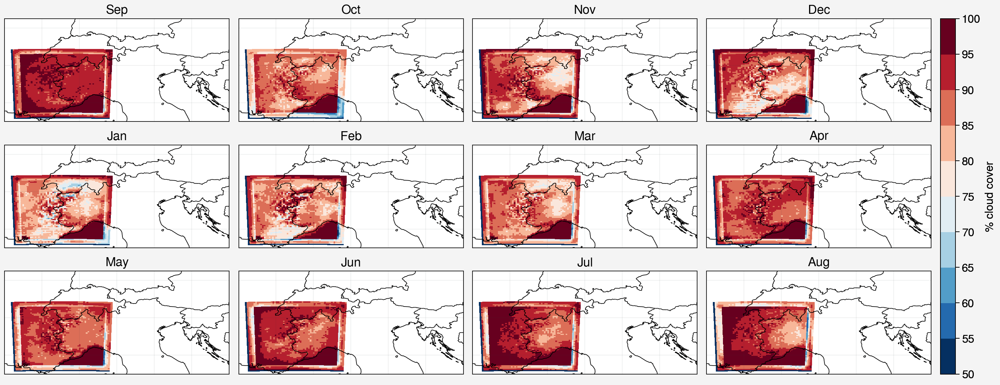

In [30]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)#axheight=0.8

list_ds = [ds_EUf2099_09_ave, ds_EUf2099_10_ave, ds_EUf2099_11_ave, ds_EUf2099_12_ave, ds_EUf2100_01_ave, ds_EUf2100_02_ave, ds_EUf2100_03_ave, ds_EUf2100_04_ave,
          ds_EUf2100_05_ave, ds_EUf2100_06_ave, ds_EUf2100_07_ave, ds_EUf2100_08_ave]
months = ['Sep','Oct','Nov','Dec','Jan','Feb','Mar','Apr','May','Jun','Jul','Aug']

for mon in range(len(list_ds)):
    ax=axs[mon]
    m = ax.pcolormesh(ds.LON,ds.LAT,100*list_ds[mon].CC.mean(axis=0),levels=np.linspace(50,100,11),cmap='RdBu_r')
    ax.format(title=months[mon])


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format)

### EUh : 80x80 domain

In [16]:
vars = ["LON", "LAT", "FRV", "VEG", "SH", "GF", "SWD", "SWU", "LWD", "LWU", "SHF", "LHF", "HAcc", "HA_col", "SWt", "MB", "MBm", "MBmTop", "MBr", "MBrTop"]

ds_2100 = open_yearly_data(year = '2100', sim = 'EUh', vars = vars, timestep_in_hours = 4)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_408442/3309161639.py:20: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_408442/3309161639.py:20: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


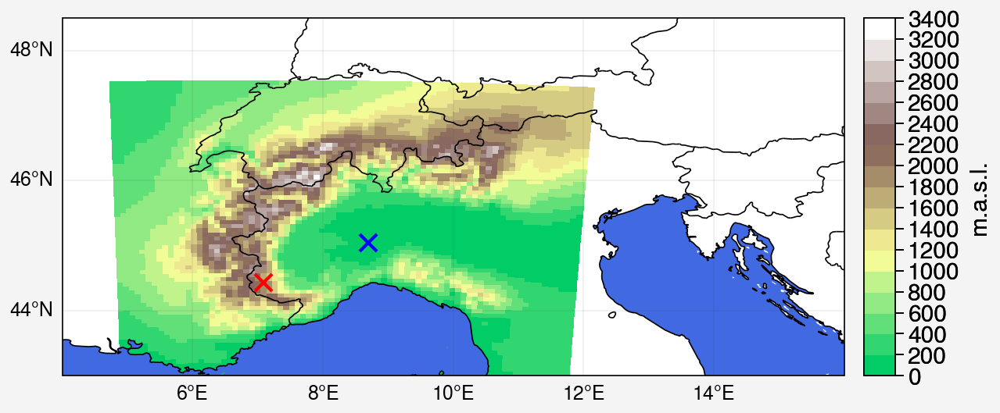

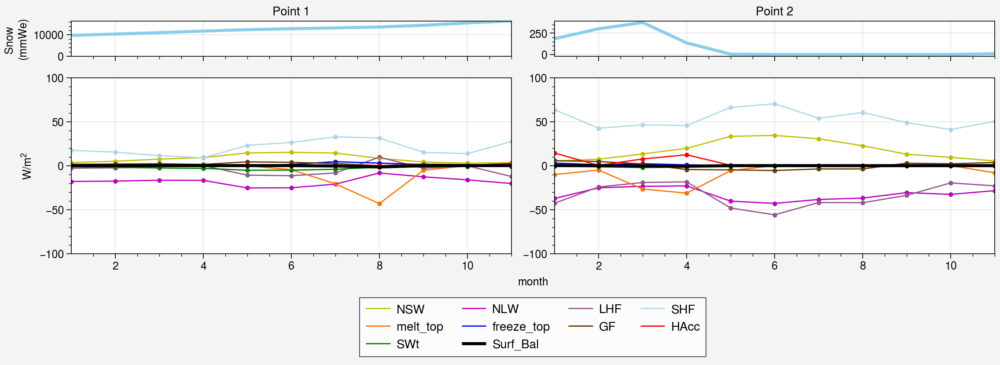

In [17]:
ds_2100_month = ds_2100.groupby('time.month').mean(dim="time")

plot_monthly_2points(ds_var = ds_2100_month, first=0, last=-1, iloc1 = 30, jloc1 = 25, iloc2 = 40, jloc2 = 43, ymin = -100, ymax = 100,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

In [18]:
ds_EUh2100_k = open_monthly_data_k(year='2100',month='08',days_in_month='31',sim='h29',day_average=False,HA_col=True,timestep_in_hours = 4,
                                   imin = 0, imax = -1, jmin = 0, jmax = -1)
ds_EUh2100_ave = open_monthly_data_ave(year='2100',month='08',days_in_month='31',sim='h29',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_408442/2692505537.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_408442/2692505537.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


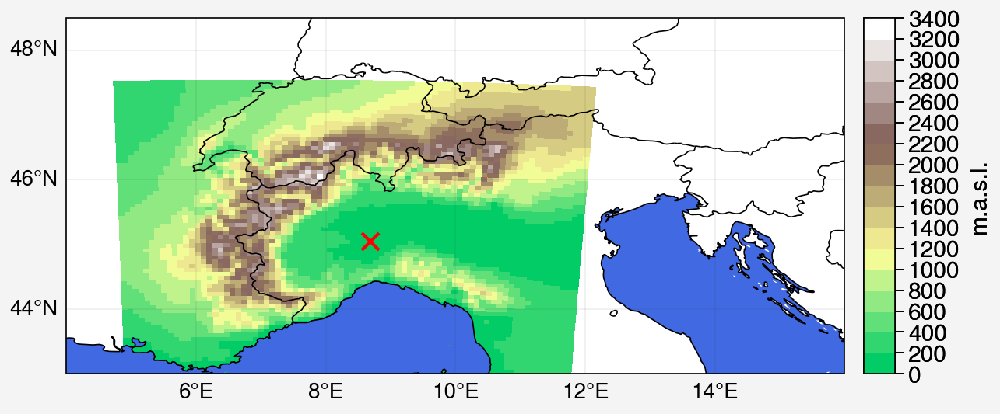

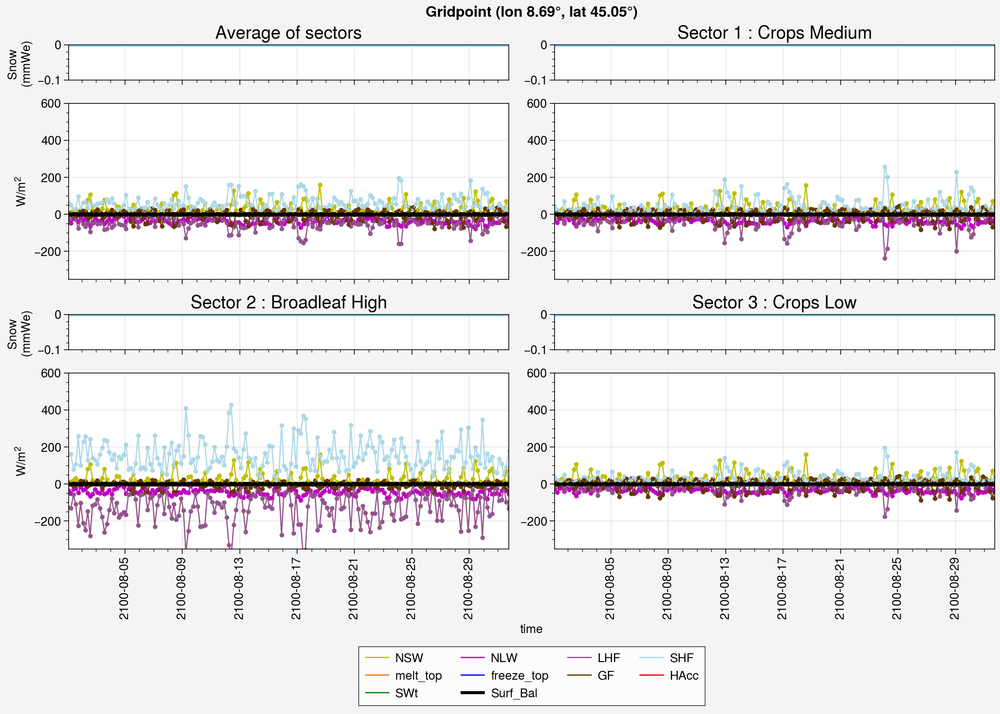

In [19]:
plot_by_mosaic2(ds_var = ds_EUh2100_k, ds_var_ave = ds_EUh2100_ave, first=0, last=-1, iloc = 40, jloc = 43, ymin = -350, ymax = 600,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

#### 2014/2015

In [28]:
#vars = ["LON", "LAT", "FRV", "VEG", "SH", "GF", "SWD", "SWU", "LWD", "LWU", "SHF", "LHF", "HAcc", "HA_col", "SWt", "MB", "MBm", "MBmTop", "MBr", "MBrTop"]
vars = ["GF", "SWD", "SWU", "LWD", "LWU", "SHF", "LHF", "HAcc", "HA_col", "SWt", "MB", "MBm", "MBmTop", "MBr", "MBrTop", "CC", "ST", "TTz"]

ds_2015 = open_yearly_data(year = '2015', sim = 'EUh', vars = vars, timestep_in_hours = 4)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_461594/3309161639.py:20: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_461594/3309161639.py:20: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


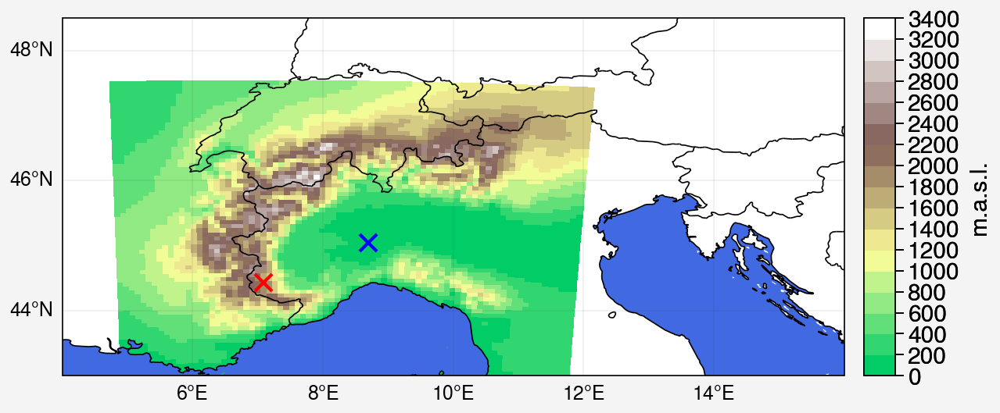

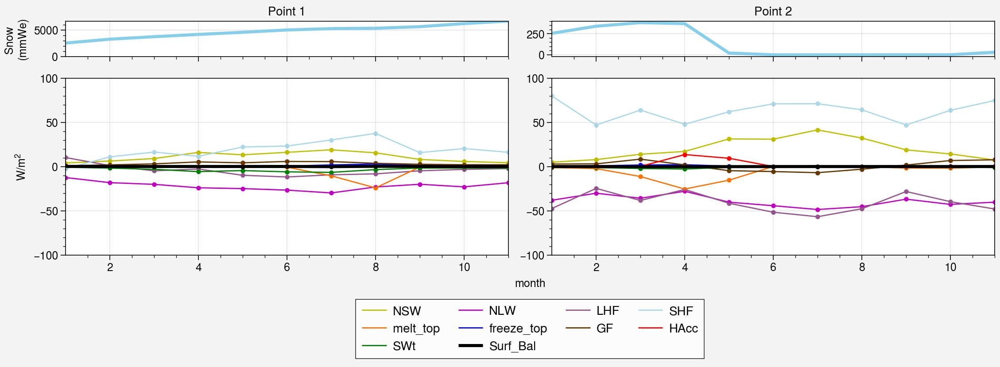

In [29]:
ds_2015_month = ds_2015.groupby('time.month').mean(dim="time")

plot_monthly_2points(ds_var = ds_2015_month, first=0, last=-1, iloc1 = 30, jloc1 = 25, iloc2 = 40, jloc2 = 43, ymin = -100, ymax = 100,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

In [22]:
ds_EUh2015_k = open_monthly_data_k(year='2015',month='07',days_in_month='31',sim='h01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                   imin = 0, imax = -1, jmin = 0, jmax = -1)
ds_EUh2015_ave = open_monthly_data_ave(year='2015',month='07',days_in_month='31',sim='h01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_408442/2692505537.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_408442/2692505537.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


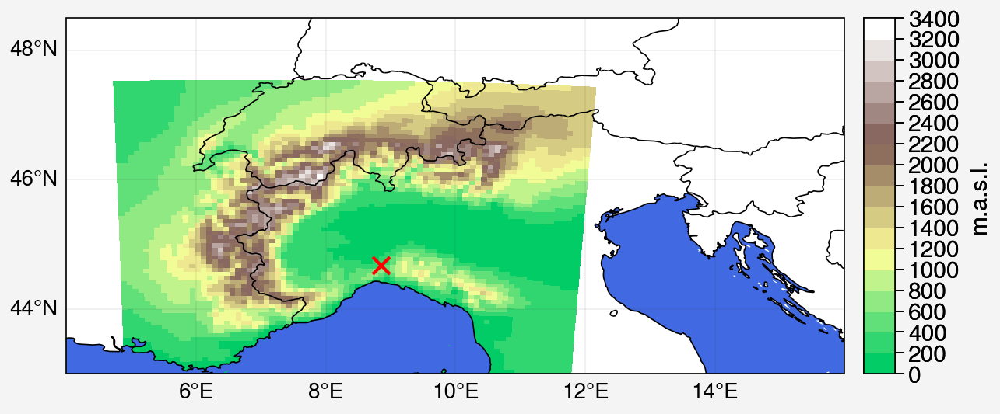

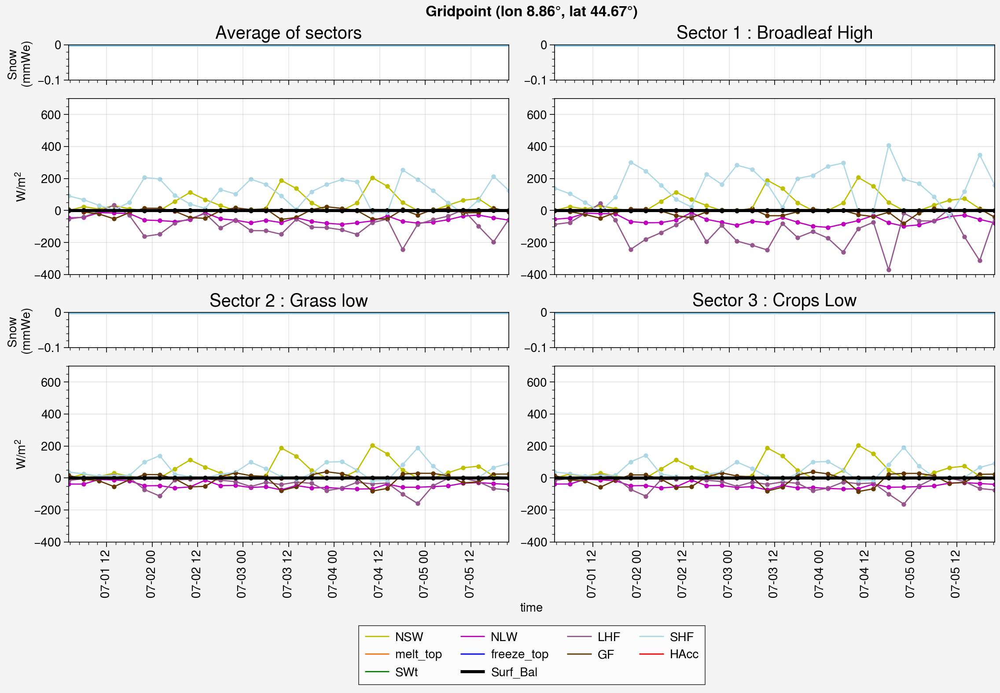

In [23]:
plot_by_mosaic2(ds_var = ds_EUh2015_k, ds_var_ave = ds_EUh2015_ave, first=0, last=30, iloc = i2, jloc = j2, ymin = -400, ymax = 700,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

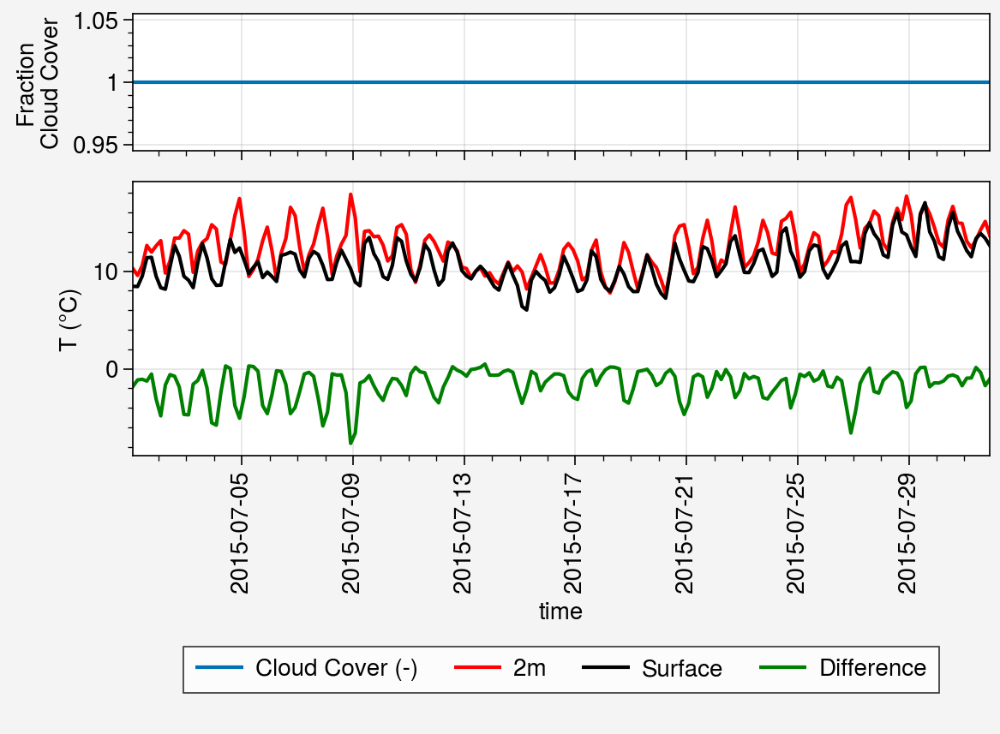

In [29]:
f, axs = pplt.subplots(axwidth=5,axheight=0.8,ncols=1,nrows=2,hratios=(1,2),ref=1,sharey=False)

axs[0].plot(ds_EUh2015_ave.time, ds_EUh2015_ave.CC[:,i2,j2])
axs[0].format(ylabel='Fraction\nCloud Cover')

axs[1].plot(ds_EUh2015_ave.time, ds_EUh2015_ave.TT2[:,i2,j2],label = '2m', c='r')
axs[1].plot(ds_EUh2015_ave.time, ds_EUh2015_ave.ST[:,i2,j2], label = 'Surface', c='k')
axs[1].plot(ds_EUh2015_ave.time, ds_EUh2015_ave.ST[:,i2,j2] - ds_EUh2015_ave.TT2[:,i2,j2], label = 'Difference', c='green')
axs[1].format(ylabel='T (°C)')

f.legend(loc='b',prop = { "size": 10 },ncols=4)

In [17]:
#ds_2015_month.CC

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

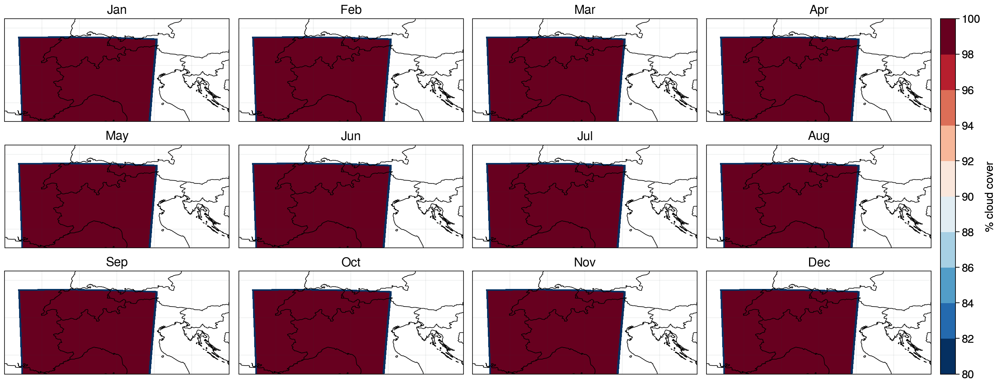

In [52]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)#axheight=0.8

ds_var = ds_2015_month
months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    ax=axs[mon]
    m = ax.pcolormesh(ds.LON,ds.LAT,100*ds_var.CC[mon],levels=np.linspace(80,100,11),cmap='RdBu_r')
    ax.format(title=months[mon])


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format)

In [ ]:
ds_2015_month


In [42]:
ds_EUh2014_09_ave = open_monthly_data_ave(year='2014',month='09',days_in_month='30',sim='h01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUh2014_10_ave = open_monthly_data_ave(year='2014',month='10',days_in_month='31',sim='h01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUh2014_11_ave = open_monthly_data_ave(year='2014',month='11',days_in_month='30',sim='h01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUh2014_12_ave = open_monthly_data_ave(year='2014',month='12',days_in_month='31',sim='h01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUh2015_01_ave = open_monthly_data_ave(year='2015',month='01',days_in_month='31',sim='h01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUh2015_02_ave = open_monthly_data_ave(year='2015',month='02',days_in_month='28',sim='h01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUh2015_03_ave = open_monthly_data_ave(year='2015',month='03',days_in_month='31',sim='h01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUh2015_04_ave = open_monthly_data_ave(year='2015',month='04',days_in_month='30',sim='h01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

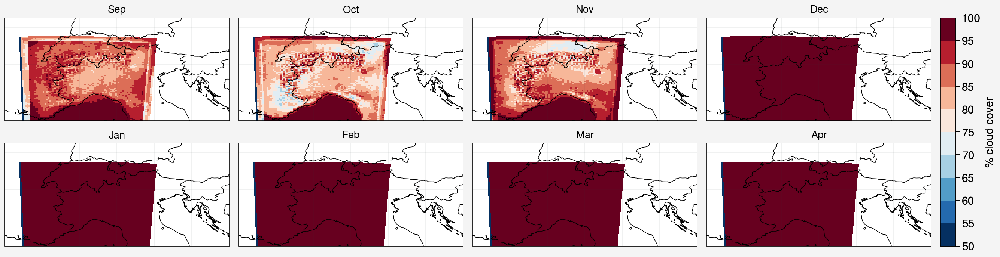

In [32]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=2)#axheight=0.8

list_ds = [ds_EUh2014_09_ave, ds_EUh2014_10_ave, ds_EUh2014_11_ave, ds_EUh2014_12_ave, ds_EUh2015_01_ave, ds_EUh2015_02_ave, ds_EUh2015_03_ave, ds_EUh2015_04_ave]
months = ['Sep','Oct','Nov','Dec','Jan','Feb','Mar','Apr']

for mon in range(len(list_ds)):
    ax=axs[mon]
    m = ax.pcolormesh(ds.LON,ds.LAT,100*list_ds[mon].CC.mean(axis=0),levels=np.linspace(50,100,11),cmap='RdBu_r')
    ax.format(title=months[mon])


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format)

In [35]:
ds_EUh2017_09_ave = open_monthly_data_ave(year='2017',month='09',days_in_month='30',sim='h02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUh2017_10_ave = open_monthly_data_ave(year='2017',month='10',days_in_month='31',sim='h02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUh2017_11_ave = open_monthly_data_ave(year='2017',month='11',days_in_month='30',sim='h02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUh2017_12_ave = open_monthly_data_ave(year='2017',month='12',days_in_month='31',sim='h02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)


ds_EUh2018_01_ave = open_monthly_data_ave(year='2018',month='01',days_in_month='31',sim='h02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUh2018_02_ave = open_monthly_data_ave(year='2018',month='02',days_in_month='28',sim='h02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUh2018_03_ave = open_monthly_data_ave(year='2018',month='03',days_in_month='31',sim='h02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUh2018_04_ave = open_monthly_data_ave(year='2018',month='04',days_in_month='30',sim='h02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

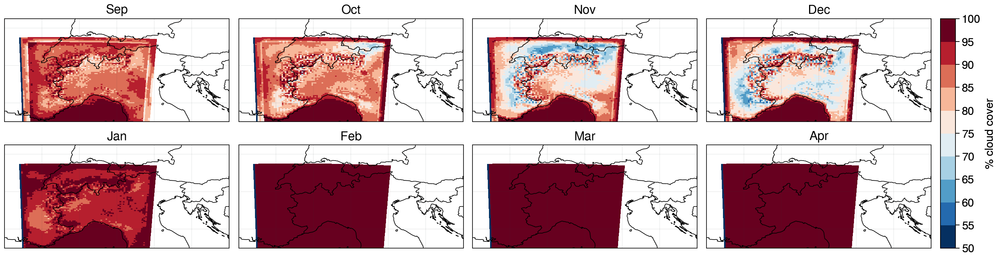

In [54]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=2)#axheight=0.8

list_ds = [ds_EUh2017_09_ave, ds_EUh2017_10_ave, ds_EUh2017_11_ave, ds_EUh2017_12_ave, ds_EUh2018_01_ave, ds_EUh2018_02_ave, ds_EUh2018_03_ave, ds_EUh2018_04_ave]
months = ['Sep','Oct','Nov','Dec','Jan','Feb','Mar','Apr']

for mon in range(8):
    ax=axs[mon]
    m = ax.pcolormesh(ds.LON,ds.LAT,100*list_ds[mon].CC.mean(axis=0),levels=np.linspace(50,100,11),cmap='RdBu_r')
    ax.format(title=months[mon])


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format)

In [18]:
ds_EUh2020_09_ave = open_monthly_data_ave(year='2020',month='09',days_in_month='30',sim='h03',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUh2020_10_ave = open_monthly_data_ave(year='2020',month='10',days_in_month='31',sim='h03',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUh2020_11_ave = open_monthly_data_ave(year='2020',month='11',days_in_month='30',sim='h03',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUh2020_12_ave = open_monthly_data_ave(year='2020',month='12',days_in_month='31',sim='h03',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)


ds_EUh2021_01_ave = open_monthly_data_ave(year='2021',month='01',days_in_month='31',sim='h03',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUh2021_02_ave = open_monthly_data_ave(year='2021',month='02',days_in_month='28',sim='h03',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUh2021_03_ave = open_monthly_data_ave(year='2021',month='03',days_in_month='31',sim='h03',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUh2021_04_ave = open_monthly_data_ave(year='2021',month='04',days_in_month='30',sim='h03',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

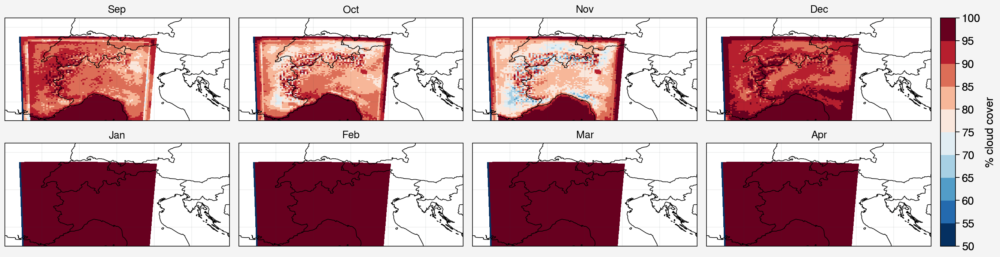

In [19]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=2)#axheight=0.8

list_ds = [ds_EUh2020_09_ave, ds_EUh2020_10_ave, ds_EUh2020_11_ave, ds_EUh2020_12_ave, ds_EUh2021_01_ave, ds_EUh2021_02_ave, ds_EUh2021_03_ave, ds_EUh2021_04_ave]
months = ['Sep','Oct','Nov','Dec','Jan','Feb','Mar','Apr']

for mon in range(8):
    ax=axs[mon]
    m = ax.pcolormesh(ds.LON,ds.LAT,100*list_ds[mon].CC.mean(axis=0),levels=np.linspace(50,100,11),cmap='RdBu_r')
    ax.format(title=months[mon])


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format)

#### Compare to e01

In [56]:
ds_EUe2014_09_ave = open_monthly_data_ave_1var(year='2014',month='09',days_in_month='30',sim='e01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUe2014_10_ave = open_monthly_data_ave_1var(year='2014',month='10',days_in_month='31',sim='e01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUe2014_11_ave = open_monthly_data_ave_1var(year='2014',month='11',days_in_month='30',sim='e01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUe2014_12_ave = open_monthly_data_ave_1var(year='2014',month='12',days_in_month='31',sim='e01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)


ds_EUe2015_01_ave = open_monthly_data_ave_1var(year='2015',month='01',days_in_month='31',sim='e01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUe2015_02_ave = open_monthly_data_ave_1var(year='2015',month='02',days_in_month='28',sim='e01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUe2015_03_ave = open_monthly_data_ave_1var(year='2015',month='03',days_in_month='31',sim='e01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUe2015_04_ave = open_monthly_data_ave_1var(year='2015',month='04',days_in_month='30',sim='e01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

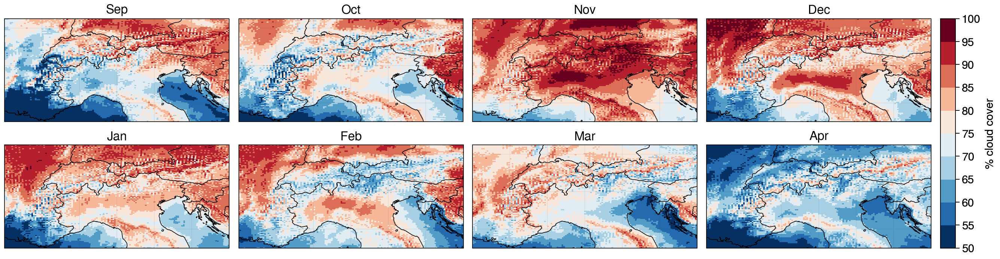

In [58]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=2)#axheight=0.8

ds_big = xr.open_dataset('/bettik/beaumetj/MARout/MAR-EC-Earth3/MARgrid_EUe.nc')

list_ds = [ds_EUe2014_09_ave, ds_EUe2014_10_ave, ds_EUe2014_11_ave, ds_EUe2014_12_ave,ds_EUe2015_01_ave,ds_EUe2015_02_ave,ds_EUe2015_03_ave,ds_EUe2015_04_ave]
months = ['Sep','Oct','Nov','Dec','Jan','Feb','Mar','Apr']

for mon in range(8):
    ax=axs[mon]
    m = ax.pcolormesh(ds_big.LON,ds_big.LAT,100*list_ds[mon].CC.mean(axis=0),levels=np.linspace(50,100,11),cmap='RdBu_r')
    ax.format(title=months[mon])


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format)

#### Any year

In [31]:
vars = ["GF", "SWD", "SWU", "LWD", "LWU", "SHF", "LHF", "HAcc", "HA_col", "SWt", "MB", "MBm", "MBmTop", "MBr", "MBrTop", "CC", "ST", "TTz"]

ds_yr = open_yearly_data(year = '2018', sim = 'EUh', vars = vars, timestep_in_hours = 4)

In [32]:
ds_yr_month = ds_yr.groupby('time.month').mean(dim="time")


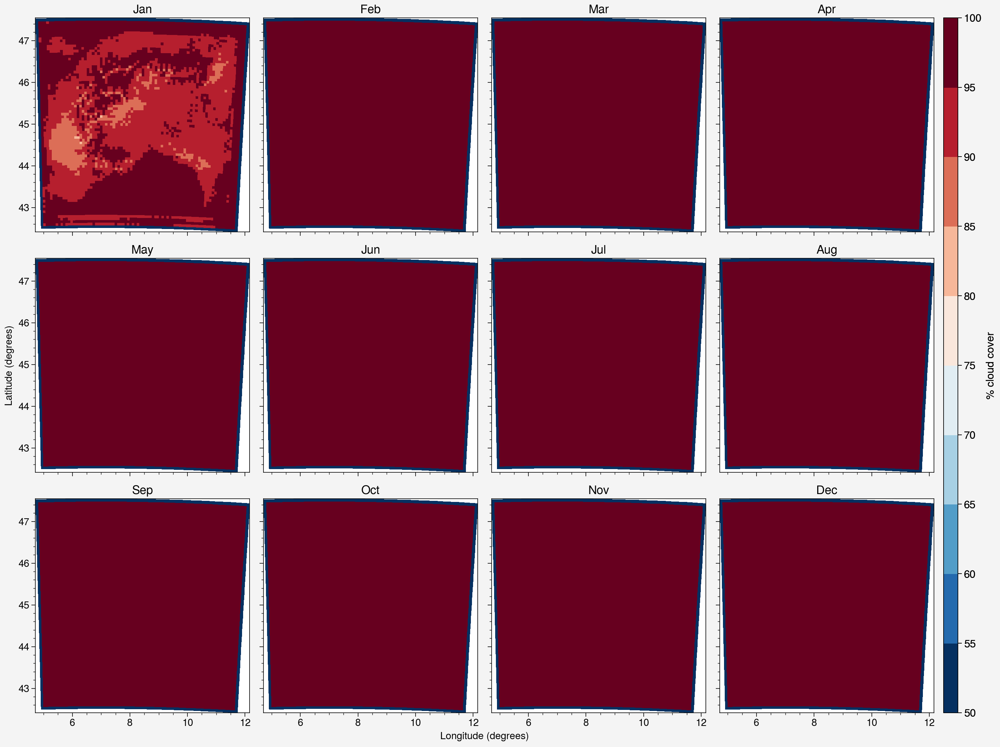

In [33]:
f, axs = pplt.subplots(axwidth=3,ncols=4,nrows=3)#axheight=0.8

ds_var = ds_yr_month
months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    ax=axs[mon]
    m = ax.pcolormesh(ds.LON,ds.LAT,100*ds_var.CC[mon],levels=np.linspace(50,100,11),cmap='RdBu_r')
    ax.format(title=months[mon])


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')

### Whole period : 2015-2100

In [61]:
# wp = whole period

# first_year = 2015
# last_year = 2100
# wp_meanseason_CC = np.zeros(((last_year-first_year+1),4,80,80))

# for year in list(range(first_year,last_year+1)):
#     print(year,end=' ')
#     ds_CC = xr.open_dataset('/bettik/castelli/data/MAR-EC-Earth3/small_domain/SSP245/ICE.EC-Earth3_SSP245.EUh.CC.'+str(year)+'.nc').resample(time="1D").mean()
    
#     season_mean_year=season_mean(ds_CC.CC).sortby(xr.DataArray(['DJF','MAM','JJA', 'SON'],dims=['season']))
#     wp_meanseason_CC[year-first_year] = season_mean_year


2015 2016 2017 2018 2019 2020 2021 2022 2023 2024 2025 2026 2027 2028 2029 2030 2031 2032 2033 2034 2035 2036 2037 2038 2039 2040 2041 2042 2043 2044 2045 2046 2047 2048 2049 2050 2051 2052 2053 2054 2055 2056 2057 2058 2059 2060 2061 2062 2063 2064 2065 2066 2067 2068 2069 2070 2071 2072 2073 2074 2075 2076 2077 2078 2079 2080 2081 2082 2083 2084 2085 2086 2087 2088 2089 2090 2091 2092 2093 2094 2095 2096 2097 2098 2099 2100 

In [62]:
# np.save('/bettik/castelli/data/saved_data_MAR_ECEarth3/small_domain/wp_meanseason_CC_EUh.npy', wp_meanseason_CC)


In [70]:
# wp = whole period

# first_year = 2015
# last_year = 2100
# wp_meanseason_meanT = np.zeros(((last_year-first_year+1),4,80,80))
# for year in list(range(first_year,last_year+1)):
#     print(year,end=' ')
#     ds_mean = xr.open_dataset('/bettik/castelli/data/MAR-EC-Earth3/small_domain/SSP245/ICE.EC-Earth3_SSP245.EUh.TTz.'+str(year)+'.nc').resample(time="1D").mean()
#     season_mean_year=season_mean(ds_mean.TTz.isel(ztqlev=0)).sortby(xr.DataArray(['DJF','MAM','JJA', 'SON'],dims=['season']))
#     wp_meanseason_meanT[year-first_year] = season_mean_year


2015 2016 2017 2018 2019 2020 2021 2022 2023 2024 2025 2026 2027 2028 2029 2030 2031 2032 2033 2034 2035 2036 2037 2038 2039 2040 2041 2042 2043 2044 2045 2046 2047 2048 2049 2050 2051 2052 2053 2054 2055 2056 2057 2058 2059 2060 2061 2062 2063 2064 2065 2066 2067 2068 2069 2070 2071 2072 2073 2074 2075 2076 2077 2078 2079 2080 2081 2082 2083 2084 2085 2086 2087 2088 2089 2090 2091 2092 2093 2094 2095 2096 2097 2098 2099 2100 

In [71]:
# np.save('/bettik/castelli/data/saved_data_MAR_ECEarth3/small_domain/wp_meanseason_meanT_EUh.npy', wp_meanseason_meanT)


In [20]:
wp_meanseason_CC = np.load('/bettik/castelli/data/saved_data_MAR_ECEarth3/small_domain/wp_meanseason_CC_EUh.npy')
wp_meanseason_meanT = np.load('/bettik/castelli/data/saved_data_MAR_ECEarth3/small_domain/wp_meanseason_meanT_EUh.npy')


In [21]:
wp_meanseason_CC.shape

(86, 4, 80, 80)

/tmp/ipykernel_2452346/2418081681.py:12: ProplotWarning: Ignoring unused projection-specific format() keyword argument(s): {'lonlim': [4.0, 16.0], 'latlim': [43.0, 48.5], 'lonlines': 2, 'latlines': 2, 'labels': False}
  axs.format(**multiplot_format)


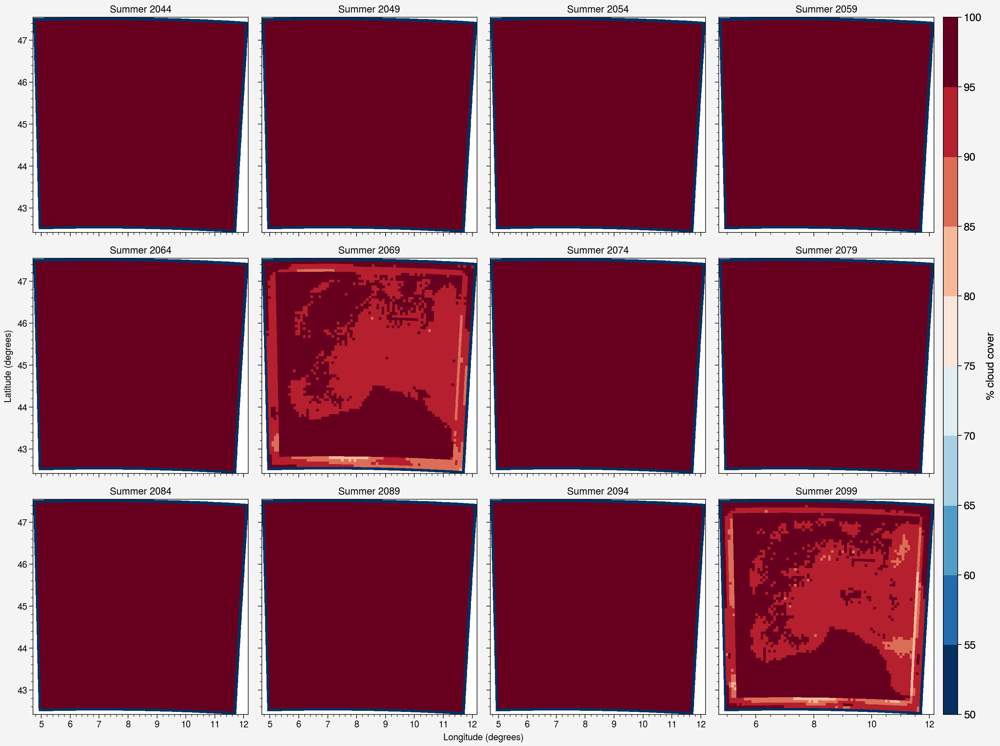

In [25]:
f, axs = pplt.subplots(axwidth=3,ncols=4,nrows=3)#axheight=0.8


for yr in range(12):
    ax=axs[yr]
    m = ax.pcolormesh(ds.LON,ds.LAT,100*wp_meanseason_CC[yr*5+29,2],levels=np.linspace(50,100,11),cmap='RdBu_r')
    ax.format(title=f'Summer {2015+yr*5+29}')


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')

axs.format(**multiplot_format)

/tmp/ipykernel_2452346/1386999291.py:12: ProplotWarning: Ignoring unused projection-specific format() keyword argument(s): {'lonlim': [4.0, 16.0], 'latlim': [43.0, 48.5], 'lonlines': 2, 'latlines': 2, 'labels': False}
  axs.format(**multiplot_format,suptitle="Seasonal mean temp JJA")


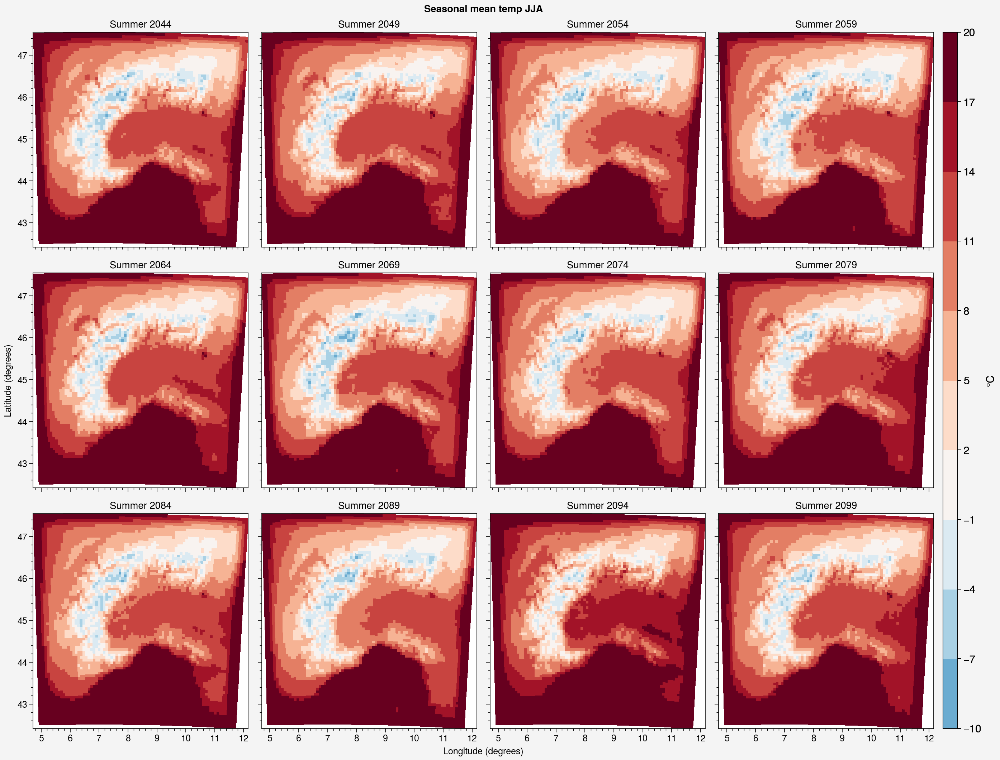

In [26]:
f, axs = pplt.subplots(axwidth=3,ncols=4,nrows=3)#axheight=0.8


for yr in range(12):
    ax=axs[yr]
    m = ax.pcolormesh(ds.LON,ds.LAT,wp_meanseason_meanT[yr*5+29,2],levels=np.linspace(-10,20,11),cmap='RdBu_r')
    ax.format(title=f'Summer {2015+yr*5+29}')


f.colorbar(m,label= '°C',labelsize='large',ticklabelsize='large')

axs.format(**multiplot_format,suptitle="Seasonal mean temp JJA")

### EUi and EUj
Both 80x80, EUi forced by EC-Earth3 with 10% humidity correction and EUj forced by ERA5 with 15% humidity correction

In [18]:
ds_EUi2014_09_ave = open_monthly_data_ave_1var(year='2014',month='09',days_in_month='30',sim='i01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2014_10_ave = open_monthly_data_ave_1var(year='2014',month='10',days_in_month='31',sim='i01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2014_11_ave = open_monthly_data_ave_1var(year='2014',month='11',days_in_month='30',sim='i01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2014_12_ave = open_monthly_data_ave_1var(year='2014',month='12',days_in_month='31',sim='i01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2015_01_ave = open_monthly_data_ave_1var(year='2015',month='01',days_in_month='31',sim='i01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2015_02_ave = open_monthly_data_ave_1var(year='2015',month='02',days_in_month='28',sim='i01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2015_03_ave = open_monthly_data_ave_1var(year='2015',month='03',days_in_month='31',sim='i01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2015_04_ave = open_monthly_data_ave_1var(year='2015',month='04',days_in_month='30',sim='i01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

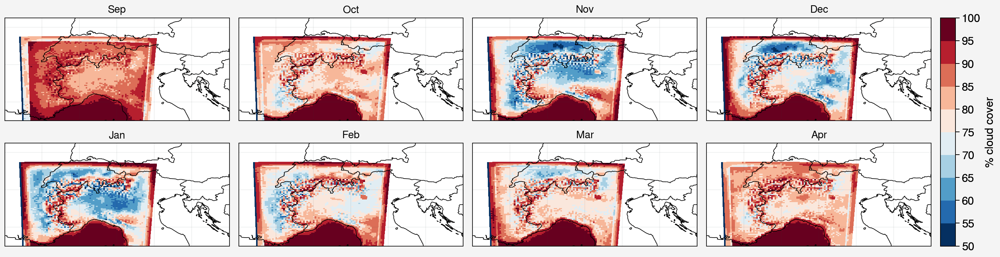

In [30]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=2)#axheight=0.8

list_ds = [ds_EUi2014_09_ave, ds_EUi2014_10_ave, ds_EUi2014_11_ave, ds_EUi2014_12_ave, ds_EUi2015_01_ave, ds_EUi2015_02_ave, ds_EUi2015_03_ave, ds_EUi2015_04_ave]
months = ['Sep','Oct','Nov','Dec','Jan','Feb','Mar','Apr']

for mon in range(len(list_ds)):
    ax=axs[mon]
    m = ax.pcolormesh(ds.LON,ds.LAT,100*list_ds[mon].CC.mean(axis=0),levels=np.linspace(50,100,11),cmap='RdBu_r')
    ax.format(title=months[mon])


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format)

In [19]:
ds_EUi2015_02_ave = open_monthly_data_ave(year='2015',month='02',days_in_month='28',sim='i01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2015_02_k = open_monthly_data_k(year='2015',month='02',days_in_month='28',sim='i01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_1790543/2692505537.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_1790543/2692505537.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


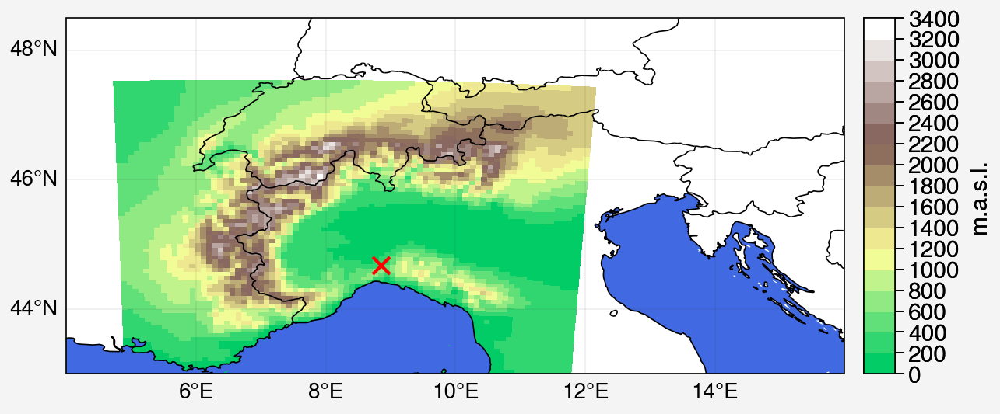

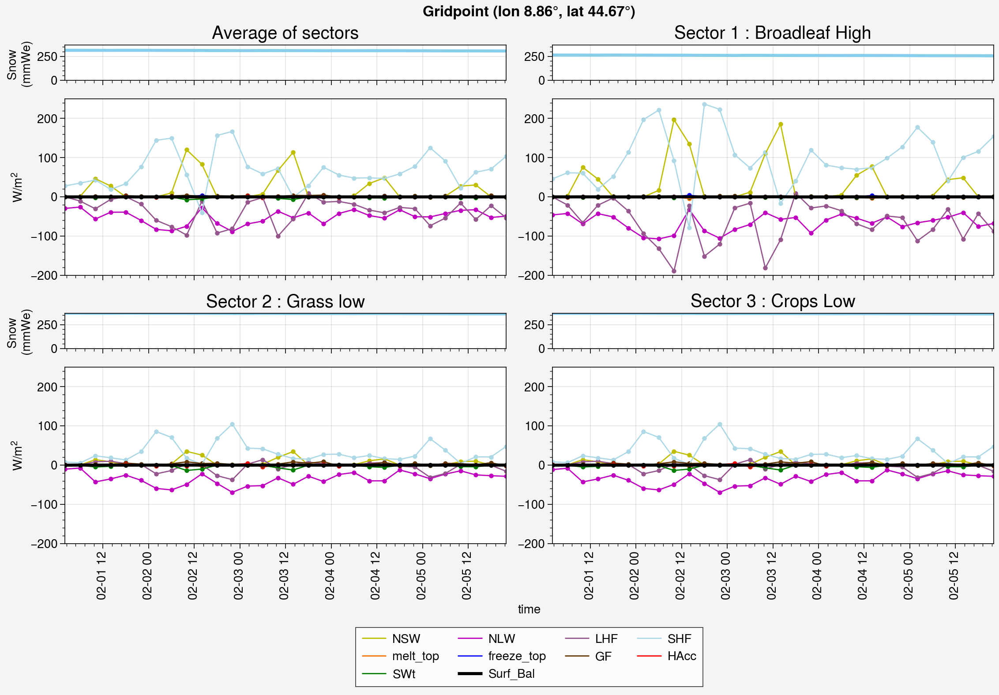

In [30]:
plot_by_mosaic2(ds_var = ds_EUi2015_02_k, ds_var_ave = ds_EUi2015_02_ave, first=0, last=30, iloc = i2, jloc = j2, ymin = -200, ymax = 250,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

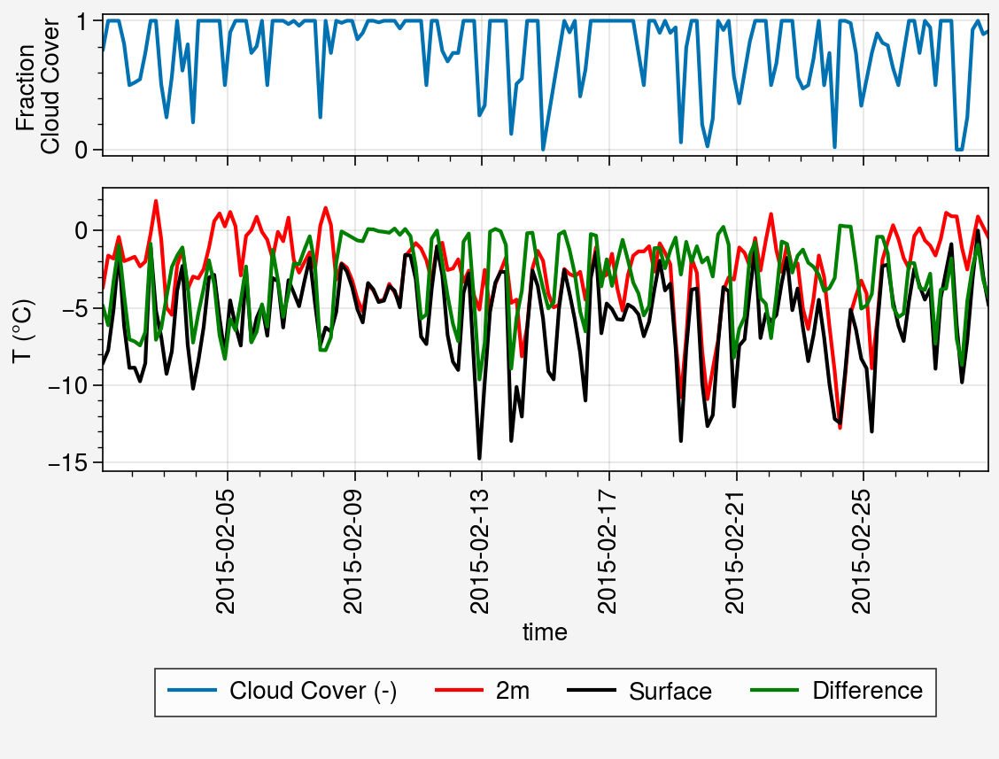

In [27]:
f, axs = pplt.subplots(axwidth=5,axheight=0.8,ncols=1,nrows=2,hratios=(1,2),ref=1,sharey=False)

axs[0].plot(ds_EUi2015_02_ave.time, ds_EUi2015_02_ave.CC[:,i2,j2])
axs[0].format(ylabel='Fraction\nCloud Cover')

axs[1].plot(ds_EUi2015_02_ave.time, ds_EUi2015_02_ave.TT2[:,i2,j2],label = '2m', c='r')
axs[1].plot(ds_EUi2015_02_ave.time, ds_EUi2015_02_ave.ST[:,i2,j2], label = 'Surface', c='k')
axs[1].plot(ds_EUi2015_02_ave.time, ds_EUi2015_02_ave.ST[:,i2,j2] - ds_EUi2015_02_ave.TT2[:,i2,j2], label = 'Difference', c='green')
axs[1].format(ylabel='T (°C)')

f.legend(loc='b',prop = { "size": 10 },ncols=4)

In [ ]:
len(list_ds)

In [25]:
ds_EUj2014_09_ave = open_monthly_data_ave(year='2014',month='09',days_in_month='30',sim='j01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUj2014_10_ave = open_monthly_data_ave(year='2014',month='10',days_in_month='31',sim='j01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUj2014_11_ave = open_monthly_data_ave(year='2014',month='11',days_in_month='30',sim='j01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUj2014_12_ave = open_monthly_data_ave(year='2014',month='12',days_in_month='31',sim='j01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUj2015_01_ave = open_monthly_data_ave(year='2015',month='01',days_in_month='31',sim='j01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUj2015_02_ave = open_monthly_data_ave(year='2015',month='02',days_in_month='28',sim='j01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUj2015_03_ave = open_monthly_data_ave(year='2015',month='03',days_in_month='31',sim='j01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUj2015_04_ave = open_monthly_data_ave(year='2015',month='04',days_in_month='30',sim='j01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

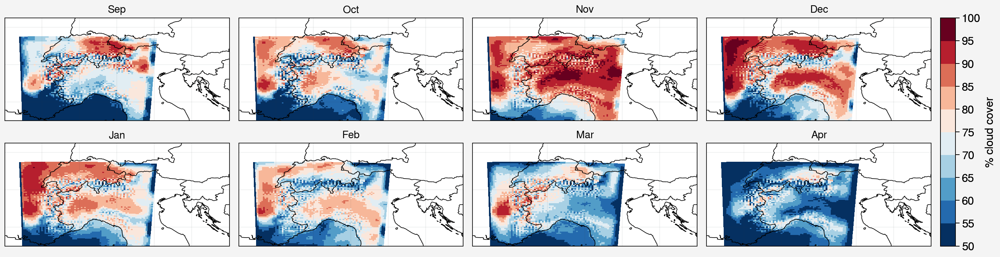

In [24]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=2)#axheight=0.8

list_ds = [ds_EUj2014_09_ave, ds_EUj2014_10_ave, ds_EUj2014_11_ave, ds_EUj2014_12_ave, ds_EUj2015_01_ave, ds_EUj2015_02_ave, ds_EUj2015_03_ave, ds_EUj2015_04_ave]
months = ['Sep','Oct','Nov','Dec','Jan','Feb','Mar','Apr']

for mon in range(len(list_ds)):
    ax=axs[mon]
    m = ax.pcolormesh(ds.LON,ds.LAT,100*list_ds[mon].CC.mean(axis=0),levels=np.linspace(50,100,11),cmap='RdBu_r')
    ax.format(title=months[mon])


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format)

#### Compare MAR-ERA5 v3.14 vs v3.10

In [27]:
# MARv3.10
name_GCM = 'ERA5'
code_GCM = 'ERA5_v1'
scenario = 'HIST'
sim = 'EUl'
sim2 = 'EUl'
data_freq = 'daily'
data_freq_prefix = 'ICE' # ICE for daily, MON for monthly
year = 2015

ssp585_path = '/bettik/beaumetj/MARout/MAR-'+name_GCM+'/'+data_freq+'/'+data_freq_prefix+'.'+code_GCM+'.'+sim2+'.TTz.'+str(year)+'.nc'

ds_EUl2015_TTz = xr.open_dataset(ssp585_path)

ssp585_path = '/bettik/beaumetj/MARout/MAR-'+name_GCM+'/'+data_freq+'/'+data_freq_prefix+'.'+code_GCM+'.'+sim2+'.CC.'+str(year)+'.nc'

ds_EUl2015_CC = xr.open_dataset(ssp585_path)

ssp585_path = '/bettik/beaumetj/MARout/MAR-'+name_GCM+'/'+data_freq+'/'+data_freq_prefix+'.'+code_GCM+'.'+sim2+'.MBrr.'+str(year)+'.nc'

ds_EUl2015_MBrr = xr.open_dataset(ssp585_path)

ssp585_path = '/bettik/beaumetj/MARout/MAR-'+name_GCM+'/'+data_freq+'/'+data_freq_prefix+'.'+code_GCM+'.'+sim2+'.SWD.'+str(year)+'.nc'

ds_EUl2015_SWD = xr.open_dataset(ssp585_path)

In [28]:
ds_EUl2015_MBrr_month = ds_EUl2015_MBrr.groupby('time.month').mean()

In [37]:
ds_EUl2015_MBrr_month.median()

<xarray.Dataset>
Dimensions:  ()
Data variables:
    MBrr     float32 2.203

In [38]:
ds_EUj2015_01_ave.MBrr.median()

<xarray.DataArray 'MBrr' ()>
array(0., dtype=float32)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

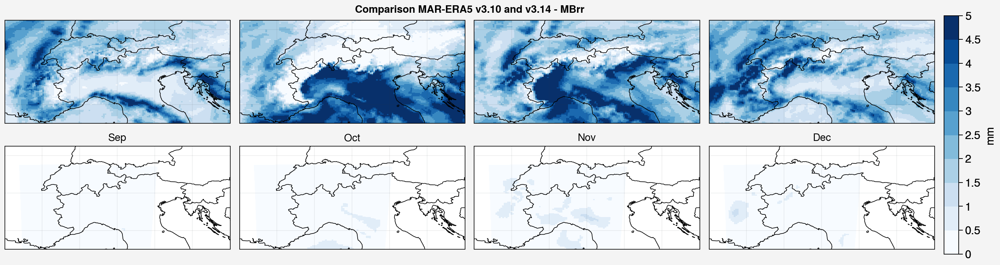

In [32]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=2,axheight=1.5)

list_ds = [ds_EUj2015_01_ave, ds_EUj2015_02_ave, ds_EUj2015_03_ave,ds_EUj2015_04_ave]
months = ['Sep','Oct','Nov','Dec']
ds_big = xr.open_dataset('/bettik/beaumetj/MARout/MAR-EC-Earth3/MARgrid_EUe.nc')


for mon in range(len(list_ds)):
    ax=axs[mon]
    m = ax.pcolormesh(ds_big.LON,ds_big.LAT,ds_EUl2015_MBrr_month.MBrr[mon],levels=np.linspace(0,5,11),cmap='Blues')
    
    ax=axs[mon+4]
    m = ax.pcolormesh(ds.LON,ds.LAT,list_ds[mon].MBrr.mean(axis=0),levels=np.linspace(0,5,11),cmap='Blues')
    ax.format(title=months[mon])


f.colorbar(m,label= 'mm',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format,suptitle='Comparison MAR-ERA5 v3.10 and v3.14 - MBrr')

#### New EUi simulation, i45 : has the exact same parameters as old MAR-EC-Earth simulation, including marmagic_mod params : humidity_magic = 20, cloud_magic = 0.00

Since it did not relaunch and save the nc file at the end of the first month, have to get the file from MARrun

In [22]:
ds = xr.open_dataset('/bettik/castelli/MARout/EUh/h01/2015/ICE.h01.2015.01.01-31.nc')[["LON","LAT","SH","FRV","VEG"]]


In [24]:
ds_day = xr.open_dataset('/bettik/castelli/MARrun/MAR_EUi45.14.09.01-30/ICE.20140901.i45.nc')[["GFk","SWUk","SWD",
                                                                                               "HAcck","LWUk","LWD","SHFk","LHFk",
                                                                                               "MBm","MBr","MBmTop","MBrTop","MB",
                                                                                               "SAbs_vk","SAbs","CC","CU","CM","CD",
                                                                                               "TTz","ST","SWtk"]]

timestep_in_hours = 4
# Melt
Lf = 3.34*10**5 # J.kg**(-1) the latent heat of fusion of water
t_timestep = 60*60*timestep_in_hours
ds_day_melt = ds_day.MBm * Lf / t_timestep # kg.m**(-2) * J.kg**(-1) / s = J/s.m**(-2) = W.m**(-2)
ds_day_freez = ds_day.MBr * Lf / t_timestep
ds_day_melt_top = ds_day.MBmTop * Lf / t_timestep
ds_day_freez_top = ds_day.MBrTop * Lf / t_timestep

ds_day['NSWk'] = ds_day.SWD - ds_day.SWUk
ds_day['NLWk'] = ds_day.LWD - ds_day.LWUk
ds_day['meltk'] = -ds_day_melt # minus sign because energy is LOST by surface in order to melt snow
ds_day['freezek'] = ds_day_freez
ds_day['melt_topk'] = -ds_day_melt_top
ds_day['freeze_topk'] = ds_day_freez_top
ds_day['TT2'] = ds_day.TTz.sel(ztqlev=2.0)
ds_day['SWtk'] = -ds_day['SWtk'] # - sign because the energy transmitted to lower layers is LOST by the surface

ds_day_surf_balance = ds_day.NSWk + ds_day.NLWk + ds_day.SHFk + ds_day.LHFk + ds_day.melt_topk + ds_day.freeze_topk + ds_day.GFk + ds_day.HAcck + ds_day.SWtk

ds_day['Surf_Balk'] = ds_day_surf_balance
ds_EUi45_2014_09_ave = ds_day

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

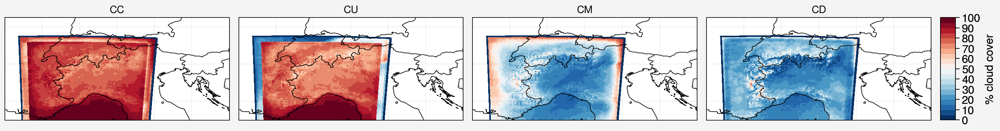

In [26]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4)#axheight=0.8

vars = ['CC','CU','CM','CD']

for var in range(len(vars)):
    ax=axs[var]
    m = ax.pcolormesh(ds.LON,ds.LAT,100*ds_EUi45_2014_09_ave[vars[var]].mean(axis=0),levels=np.linspace(0,100,21),cmap='RdBu_r')
    ax.format(title=vars[var])


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format)

#### i46 : humidity_magic = 10, cloud_magic = 0.00

In [28]:
ds_EUi46_2014_09_ave = open_monthly_data_ave(year='2014',month='09',days_in_month='30',sim='i46',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)


/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

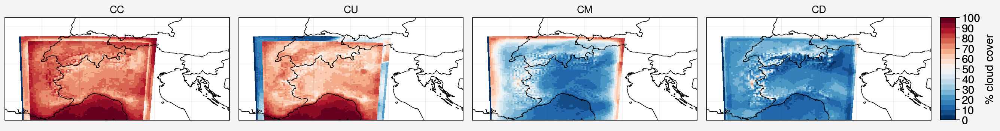

In [29]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4)#axheight=0.8

vars = ['CC','CU','CM','CD']

for var in range(len(vars)):
    ax=axs[var]
    m = ax.pcolormesh(ds.LON,ds.LAT,100*ds_EUi46_2014_09_ave[vars[var]].mean(axis=0),levels=np.linspace(0,100,21),cmap='RdBu_r')
    ax.format(title=vars[var])


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

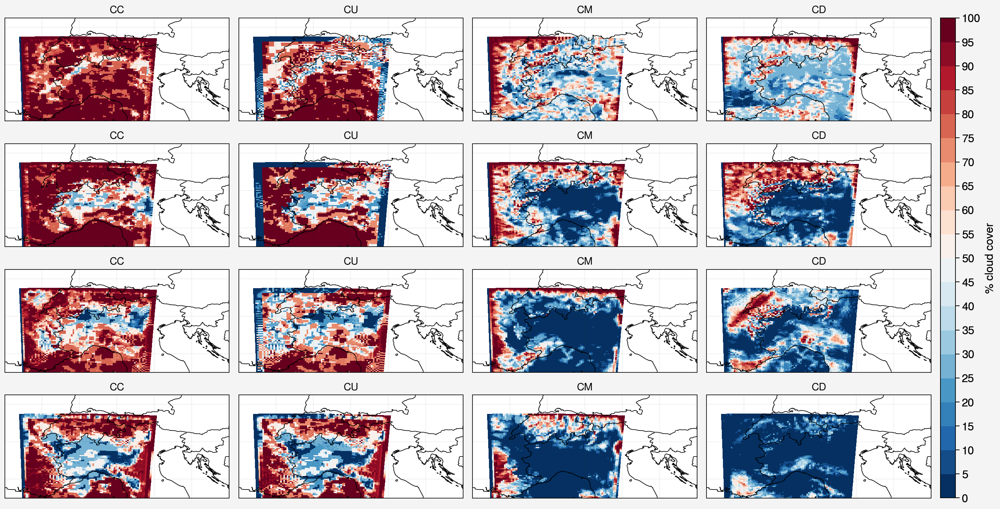

In [30]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=4)#axheight=0.8


for timestep in range(4):
    for var in range(len(vars)):
        ax=axs[4*timestep+var]
        m = ax.pcolormesh(ds.LON,ds.LAT,100*ds_EUi46_2014_09_ave[vars[var]][timestep],levels=np.linspace(0,100,21),cmap='RdBu_r')
        ax.format(title=vars[var])


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format)

#### Comparison EUi and MAR3.10-ECEarth by Julien Beaumet

In [20]:
name_GCM = 'EC-Earth3'
scenario = 'SSP245'
sim = 'EUe'

data_freq = 'daily'
data_freq_prefix = 'ICE' # ICE for daily, MON for monthly

first_year = 1961
last_year = 2100

In [21]:
year = 2014
ds_2014_MAR310 = xr.open_dataset('/bettik/beaumetj/MARout/MAR-'+name_GCM+'/HIST/'+data_freq+'/'+data_freq_prefix+'.'+name_GCM+'_HIST.EUe.CC.'+str(year)+'.nc')
ds_2014_MAR310_monthly = ds_2014_MAR310.groupby('time.month').mean()

year = 2015
ds_2015_MAR310 = xr.open_dataset('/bettik/beaumetj/MARout/MAR-'+name_GCM+'/SSP245/'+data_freq+'/'+data_freq_prefix+'.'+name_GCM+'_SSP245.EUe.CC.'+str(year)+'.nc')
ds_2015_MAR310_monthly = ds_2015_MAR310.groupby('time.month').mean()


In [22]:
ds_2014_MAR310_monthly.sel(month=9)

<xarray.Dataset>
Dimensions:  (y: 126, x: 201)
Coordinates:
  * x        (x) float32 -483.0 -476.0 -469.0 -462.0 ... 896.0 903.0 910.0 917.0
  * y        (y) float32 -308.0 -301.0 -294.0 -287.0 ... 546.0 553.0 560.0 567.0
    month    int64 9
Data variables:
    CC       (y, x) float32 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0 0.0
Attributes:
    title:        ICE - Exp: e11 - 20140101
    institution:  ULg (Xavier Fettweis)
    history:      Tue Dec 14 02:06:28 2021: ncks -v CC ICE.e11.2014.01.01-31....
    netcdf:       4.1.1 of Feb 12 2011 08:44:29 $
    NCO:          netCDF Operators version 4.9.1 (Homepage = http://nco.sf.ne...

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

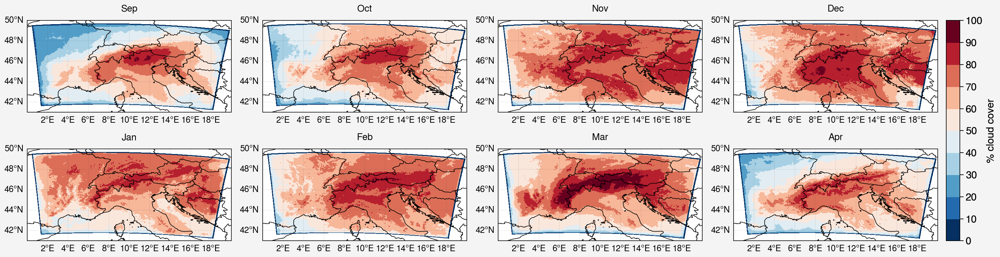

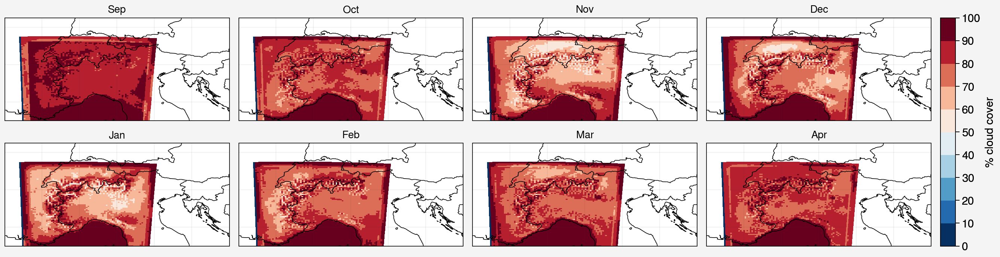

In [27]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=2)#axheight=0.8

ds_big = xr.open_dataset('/bettik/beaumetj/MARout/MAR-EC-Earth3/MARgrid_EUe.nc')

list_ds = [ds_2014_MAR310_monthly.sel(month=9), ds_2014_MAR310_monthly.sel(month=10), ds_2014_MAR310_monthly.sel(month=11), ds_2014_MAR310_monthly.sel(month=12),
           ds_2015_MAR310_monthly.sel(month=1), ds_2015_MAR310_monthly.sel(month=2), ds_2015_MAR310_monthly.sel(month=3), ds_2015_MAR310_monthly.sel(month=4)]
months = ['Sep','Oct','Nov','Dec','Jan','Feb','Mar','Apr']

for mon in range(len(list_ds)):
    ax=axs[mon]
    m = ax.pcolormesh(ds_big.LON,ds_big.LAT,100*list_ds[mon].CC,levels=np.linspace(0,100,11),cmap='RdBu_r')
    ax.format(title=months[mon])


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')
axs.format(**big_format)

# -------------- Small domain -------------------------------

f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=2)#axheight=0.8

list_ds = [ds_EUi2014_09_ave, ds_EUi2014_10_ave, ds_EUi2014_11_ave, ds_EUi2014_12_ave, ds_EUi2015_01_ave, ds_EUi2015_02_ave, ds_EUi2015_03_ave, ds_EUi2015_04_ave]
months = ['Sep','Oct','Nov','Dec','Jan','Feb','Mar','Apr']

for mon in range(len(list_ds)):
    ax=axs[mon]
    m = ax.pcolormesh(ds.LON,ds.LAT,100*list_ds[mon].CC.mean(axis=0),levels=np.linspace(0,100,11),cmap='RdBu_r')
    ax.format(title=months[mon])


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

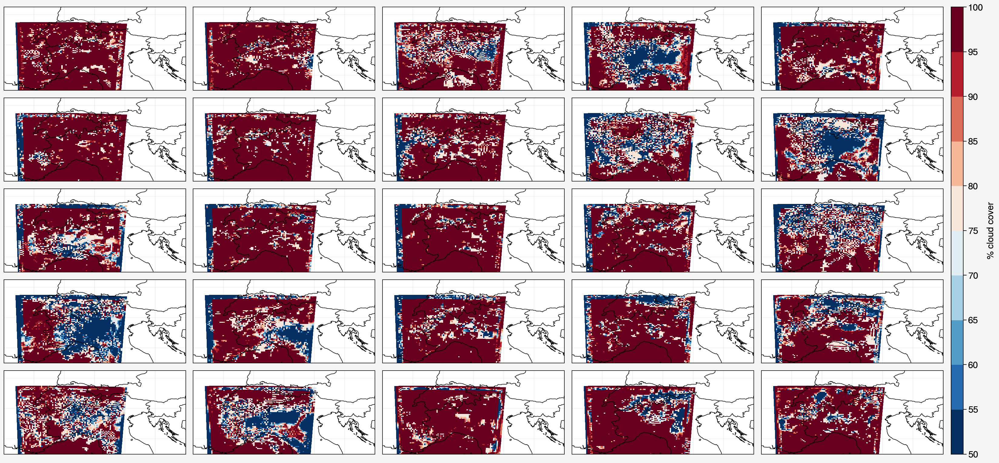

In [38]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=5,nrows=5)#axheight=0.8

months = ['Sep','Oct','Nov','Dec','Jan','Feb','Mar','Apr']

for day in range(25):
    ax=axs[day]
    #m = ax.pcolormesh(ds.LON,ds.LAT,100*ds_EUi2014_09_ave.groupby('time.day').mean().CC[day],levels=np.linspace(50,100,11),cmap='RdBu_r')
    m = ax.pcolormesh(ds.LON,ds.LAT,100*ds_EUi2014_09_ave.CC[day],levels=np.linspace(50,100,11),cmap='RdBu_r')
    #ax.format(title=months[mon])


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format)

In [40]:
ds_EUi2014_09_ave2 = open_monthly_data_ave_1var(year='2014',month='09',days_in_month='30',sim='i02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2014_10_ave2 = open_monthly_data_ave_1var(year='2014',month='10',days_in_month='31',sim='i02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2014_11_ave2 = open_monthly_data_ave_1var(year='2014',month='11',days_in_month='30',sim='i02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2014_12_ave2 = open_monthly_data_ave_1var(year='2014',month='12',days_in_month='31',sim='i02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2015_01_ave2 = open_monthly_data_ave(year='2015',month='01',days_in_month='31',sim='i02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2015_02_ave2 = open_monthly_data_ave(year='2015',month='02',days_in_month='28',sim='i02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2015_03_ave2 = open_monthly_data_ave(year='2015',month='03',days_in_month='31',sim='i02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2015_04_ave2 = open_monthly_data_ave(year='2015',month='04',days_in_month='30',sim='i02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

# ds_EUi2015_05_ave2 = open_monthly_data_ave(year='2015',month='05',days_in_month='31',sim='i02',day_average=False,HA_col=True,timestep_in_hours = 4,
#                                       imin = 0, imax = -1, jmin = 0, jmax = -1)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

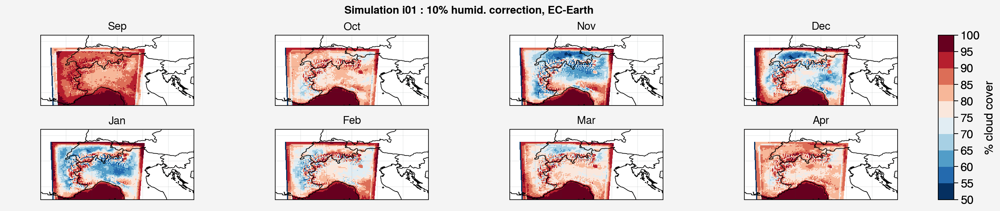

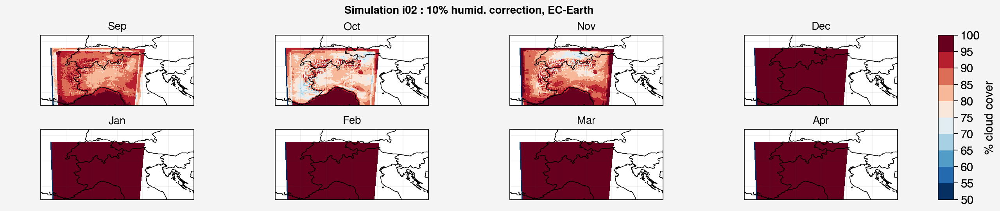

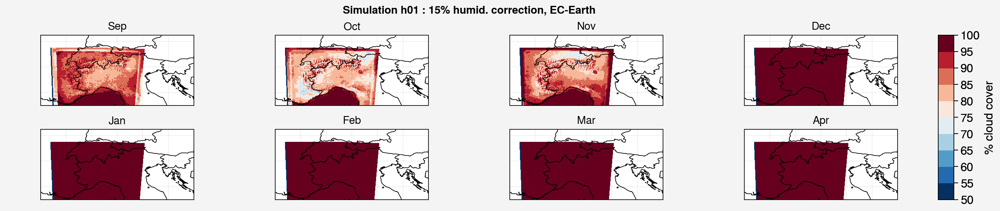

In [47]:
# -------------------- i01, short (8 months) simulation ----------------------------


f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=2,axheight=0.9)

list_ds = [ds_EUi2014_09_ave, ds_EUi2014_10_ave, ds_EUi2014_11_ave, ds_EUi2014_12_ave, ds_EUi2015_01_ave, ds_EUi2015_02_ave, ds_EUi2015_03_ave, ds_EUi2015_04_ave]
months = ['Sep','Oct','Nov','Dec','Jan','Feb','Mar','Apr']

for mon in range(len(list_ds)):
    ax=axs[mon]
    m = ax.pcolormesh(ds.LON,ds.LAT,100*list_ds[mon].CC.mean(axis=0),levels=np.linspace(50,100,11),cmap='RdBu_r')
    ax.format(title=months[mon])


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format,suptitle='Simulation i01 : 10% humid. correction, EC-Earth')


# -------------------- i02, long simulation ----------------------------

f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=2,axheight=0.9)#axheight=0.8

list_ds = [ds_EUi2014_09_ave2, ds_EUi2014_10_ave2, ds_EUi2014_11_ave2, ds_EUi2014_12_ave2, ds_EUi2015_01_ave2, ds_EUi2015_02_ave2, ds_EUi2015_03_ave2, ds_EUi2015_04_ave2]

for mon in range(len(list_ds)):
    ax=axs[mon]
    m = ax.pcolormesh(ds.LON,ds.LAT,100*list_ds[mon].CC.mean(axis=0),levels=np.linspace(50,100,11),cmap='RdBu_r')
    ax.format(title=months[mon])


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format,suptitle='Simulation i02 : 10% humid. correction, EC-Earth')


# -------------------- h02, long simulation ----------------------------

f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=2,axheight=0.9)#axheight=0.8

list_ds = [ds_EUh2014_09_ave, ds_EUh2014_10_ave, ds_EUh2014_11_ave, ds_EUh2014_12_ave, ds_EUh2015_01_ave, ds_EUh2015_02_ave, ds_EUh2015_03_ave, ds_EUh2015_04_ave]

for mon in range(len(list_ds)):
    ax=axs[mon]
    m = ax.pcolormesh(ds.LON,ds.LAT,100*list_ds[mon].CC.mean(axis=0),levels=np.linspace(50,100,11),cmap='RdBu_r')
    ax.format(title=months[mon])


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format,suptitle='Simulation h01 : 15% humid. correction, EC-Earth')

In [20]:
ds_EUi2016_09_ave = open_monthly_data_ave_1var(year='2016',month='09',days_in_month='30',sim='i03',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2016_10_ave = open_monthly_data_ave_1var(year='2016',month='10',days_in_month='31',sim='i03',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2016_11_ave = open_monthly_data_ave_1var(year='2016',month='11',days_in_month='30',sim='i03',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2016_12_ave = open_monthly_data_ave_1var(year='2016',month='12',days_in_month='31',sim='i03',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2017_01_ave = open_monthly_data_ave(year='2017',month='01',days_in_month='31',sim='i03',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2017_02_ave = open_monthly_data_ave(year='2017',month='02',days_in_month='28',sim='i03',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2017_03_ave = open_monthly_data_ave(year='2017',month='03',days_in_month='31',sim='i03',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2017_04_ave = open_monthly_data_ave(year='2017',month='04',days_in_month='30',sim='i03',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

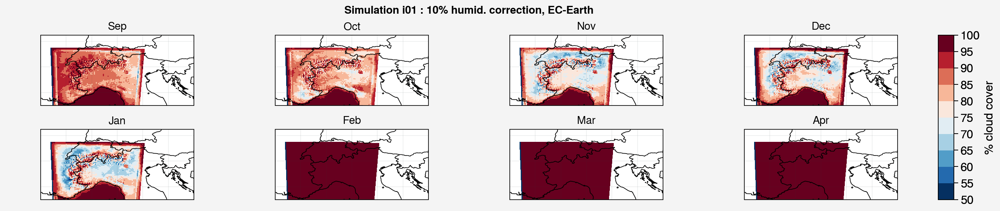

In [21]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=2,axheight=0.9)

list_ds = [ds_EUi2016_09_ave, ds_EUi2016_10_ave, ds_EUi2016_11_ave, ds_EUi2016_12_ave, ds_EUi2017_01_ave, ds_EUi2017_02_ave, ds_EUi2017_03_ave, ds_EUi2017_04_ave]
months = ['Sep','Oct','Nov','Dec','Jan','Feb','Mar','Apr']

for mon in range(len(list_ds)):
    ax=axs[mon]
    m = ax.pcolormesh(ds.LON,ds.LAT,100*list_ds[mon].CC.mean(axis=0),levels=np.linspace(50,100,11),cmap='RdBu_r')
    ax.format(title=months[mon])


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format,suptitle='Simulation i01 : 10% humid. correction, EC-Earth')

In [23]:
ds_EUi2050_09_ave = open_monthly_data_ave_1var(year='2050',month='09',days_in_month='30',sim='i20',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2050_10_ave = open_monthly_data_ave_1var(year='2050',month='10',days_in_month='31',sim='i20',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2050_11_ave = open_monthly_data_ave_1var(year='2050',month='11',days_in_month='30',sim='i20',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2050_12_ave = open_monthly_data_ave_1var(year='2050',month='12',days_in_month='31',sim='i20',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2051_01_ave = open_monthly_data_ave_1var(year='2051',month='01',days_in_month='31',sim='i20',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2051_02_ave = open_monthly_data_ave_1var(year='2051',month='02',days_in_month='28',sim='i20',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2051_03_ave = open_monthly_data_ave_1var(year='2051',month='03',days_in_month='31',sim='i20',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2051_04_ave = open_monthly_data_ave_1var(year='2051',month='04',days_in_month='30',sim='i20',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2051_05_ave = open_monthly_data_ave_1var(year='2051',month='05',days_in_month='31',sim='i20',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2051_06_ave = open_monthly_data_ave_1var(year='2051',month='06',days_in_month='30',sim='i20',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2051_07_ave = open_monthly_data_ave_1var(year='2051',month='07',days_in_month='31',sim='i20',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUi2051_08_ave = open_monthly_data_ave_1var(year='2051',month='08',days_in_month='31',sim='i20',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

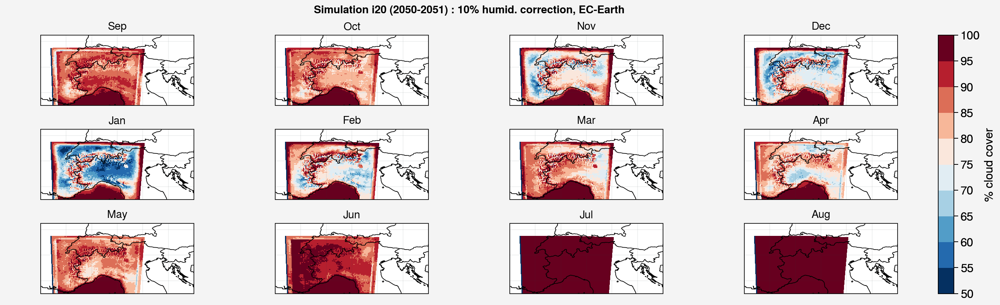

In [24]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3,axheight=0.9)

list_ds = [ds_EUi2050_09_ave, ds_EUi2050_10_ave, ds_EUi2050_11_ave, ds_EUi2050_12_ave, ds_EUi2051_01_ave, ds_EUi2051_02_ave, ds_EUi2051_03_ave, ds_EUi2051_04_ave,
          ds_EUi2051_05_ave, ds_EUi2051_06_ave, ds_EUi2051_07_ave, ds_EUi2051_08_ave]
months = ['Sep','Oct','Nov','Dec','Jan','Feb','Mar','Apr','May','Jun','Jul','Aug']

for mon in range(len(list_ds)):
    ax=axs[mon]
    m = ax.pcolormesh(ds.LON,ds.LAT,100*list_ds[mon].CC.mean(axis=0),levels=np.linspace(50,100,11),cmap='RdBu_r')
    ax.format(title=months[mon])


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format,suptitle='Simulation i20 (2050-2051) : 10% humid. correction, EC-Earth')

#### EUk

In [18]:
ds_EUk2014_09_ave = open_monthly_data_ave_1var(year='2014',month='09',days_in_month='30',sim='k01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUk2014_10_ave = open_monthly_data_ave_1var(year='2014',month='10',days_in_month='31',sim='k01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUk2014_11_ave = open_monthly_data_ave_1var(year='2014',month='11',days_in_month='30',sim='k01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUk2014_12_ave = open_monthly_data_ave_1var(year='2014',month='12',days_in_month='31',sim='k01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUk2015_01_ave = open_monthly_data_ave_1var(year='2015',month='01',days_in_month='31',sim='k01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUk2015_02_ave = open_monthly_data_ave_1var(year='2015',month='02',days_in_month='28',sim='k01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUk2015_03_ave = open_monthly_data_ave_1var(year='2015',month='03',days_in_month='31',sim='k01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUk2015_04_ave = open_monthly_data_ave_1var(year='2015',month='04',days_in_month='30',sim='k01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUk2015_05_ave = open_monthly_data_ave_1var(year='2015',month='05',days_in_month='31',sim='k01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUk2015_06_ave = open_monthly_data_ave_1var(year='2015',month='06',days_in_month='30',sim='k01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUk2015_07_ave = open_monthly_data_ave_1var(year='2015',month='07',days_in_month='31',sim='k01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUk2015_08_ave = open_monthly_data_ave_1var(year='2015',month='08',days_in_month='31',sim='k01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUk2015_09_ave = open_monthly_data_ave_1var(year='2015',month='09',days_in_month='30',sim='k01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

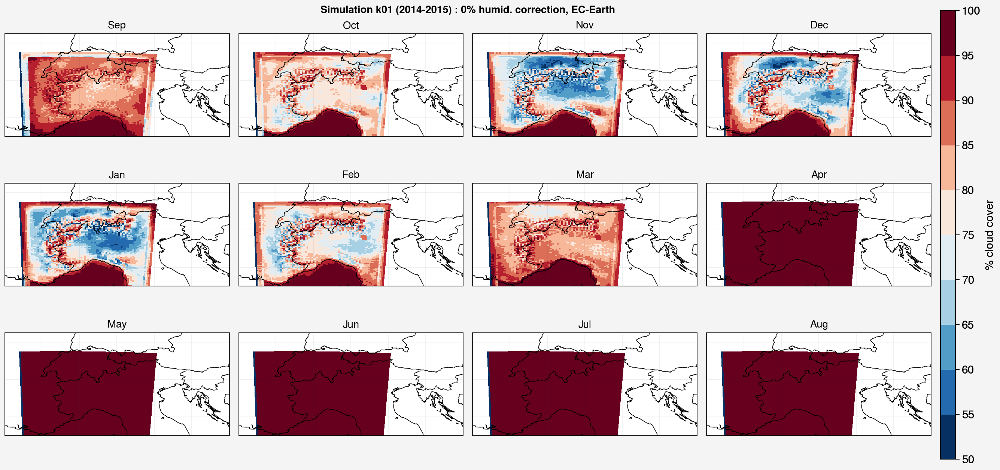

In [25]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3,axheight=2)

list_ds = [ds_EUk2014_09_ave, ds_EUk2014_10_ave, ds_EUk2014_11_ave, ds_EUk2014_12_ave, ds_EUk2015_01_ave, ds_EUk2015_02_ave, ds_EUk2015_03_ave, ds_EUk2015_04_ave,
          ds_EUk2015_05_ave, ds_EUk2015_06_ave, ds_EUk2015_07_ave, ds_EUk2015_08_ave]
months = ['Sep','Oct','Nov','Dec','Jan','Feb','Mar','Apr','May','Jun','Jul','Aug']

for mon in range(len(list_ds)):
    ax=axs[mon]
    m = ax.pcolormesh(ds.LON,ds.LAT,100*list_ds[mon].CC.mean(axis=0),levels=np.linspace(50,100,11),cmap='RdBu_r')
    ax.format(title=months[mon])


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format,suptitle='Simulation k01 (2014-2015) : 0% humid. correction, EC-Earth')

### MARv3.10 EUe (EC-Earth3)

In [22]:
ds_EUe2015_01_ave = open_monthly_data_ave_1var(year='2015',month='01',days_in_month='31',sim='e12',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1, whichpath='menegozm')

ds_EUe2015_02_ave = open_monthly_data_ave_1var(year='2015',month='02',days_in_month='28',sim='e12',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1, whichpath='menegozm')

ds_EUe2015_03_ave = open_monthly_data_ave_1var(year='2015',month='03',days_in_month='31',sim='e12',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1, whichpath='menegozm')

ds_EUe2015_04_ave = open_monthly_data_ave_1var(year='2015',month='04',days_in_month='30',sim='e12',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1, whichpath='menegozm')

ds_EUe2015_05_ave = open_monthly_data_ave_1var(year='2015',month='05',days_in_month='31',sim='e12',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1, whichpath='menegozm')

ds_EUe2015_06_ave = open_monthly_data_ave_1var(year='2015',month='06',days_in_month='30',sim='e12',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1, whichpath='menegozm')

ds_EUe2015_07_ave = open_monthly_data_ave_1var(year='2015',month='07',days_in_month='31',sim='e12',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1, whichpath='menegozm')

ds_EUe2015_08_ave = open_monthly_data_ave_1var(year='2015',month='08',days_in_month='31',sim='e12',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1, whichpath='menegozm')

ds_EUe2015_09_ave = open_monthly_data_ave_1var(year='2015',month='09',days_in_month='30',sim='e12',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1, whichpath='menegozm')

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

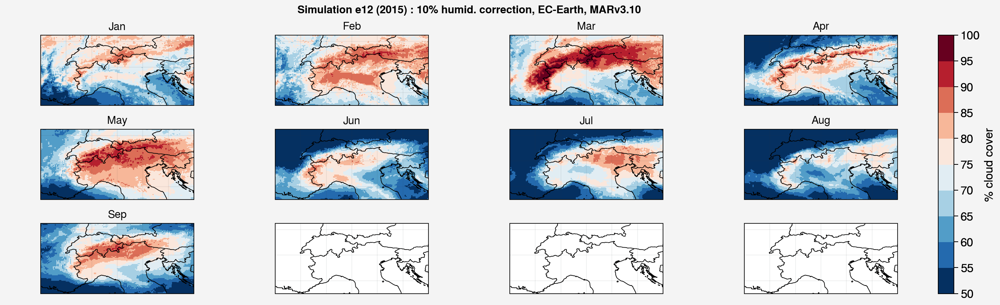

In [24]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3,axheight=0.9)

ds_big = xr.open_dataset('/bettik/beaumetj/MARout/MAR-EC-Earth3/MARgrid_EUe.nc')
list_ds = [ds_EUe2015_01_ave, ds_EUe2015_02_ave, ds_EUe2015_03_ave, ds_EUe2015_04_ave, ds_EUe2015_05_ave, ds_EUe2015_06_ave, ds_EUe2015_07_ave, ds_EUe2015_08_ave,
          ds_EUe2015_09_ave]
months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep']

for mon in range(len(list_ds)):
    ax=axs[mon]
    m = ax.pcolormesh(ds_big.LON,ds_big.LAT,100*list_ds[mon].CC.mean(axis=0),levels=np.linspace(50,100,11),cmap='RdBu_r')
    ax.format(title=months[mon])


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format,suptitle='Simulation e12 (2015) : 10% humid. correction, EC-Earth, MARv3.10')

#### EUj long (ERA5, 80x80 domain)

In [19]:
ds_EUj1960_09_ave = open_monthly_data_ave(year='1960',month='09',days_in_month='30',sim='j02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUj1960_10_ave = open_monthly_data_ave(year='1960',month='10',days_in_month='31',sim='j02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUj1960_11_ave = open_monthly_data_ave(year='1960',month='11',days_in_month='30',sim='j02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUj1960_12_ave = open_monthly_data_ave(year='1960',month='12',days_in_month='31',sim='j02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUj1961_01_ave = open_monthly_data_ave(year='1961',month='01',days_in_month='31',sim='j02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUj1961_02_ave = open_monthly_data_ave(year='1961',month='02',days_in_month='28',sim='j02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUj1961_03_ave = open_monthly_data_ave(year='1961',month='03',days_in_month='31',sim='j02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUj1961_04_ave = open_monthly_data_ave(year='1961',month='04',days_in_month='30',sim='j02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUj1961_05_ave = open_monthly_data_ave(year='1961',month='05',days_in_month='31',sim='j02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUj1961_06_ave = open_monthly_data_ave(year='1961',month='06',days_in_month='30',sim='j02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUj1961_07_ave = open_monthly_data_ave(year='1961',month='07',days_in_month='31',sim='j02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

ds_EUj1961_08_ave = open_monthly_data_ave(year='1961',month='08',days_in_month='31',sim='j02',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

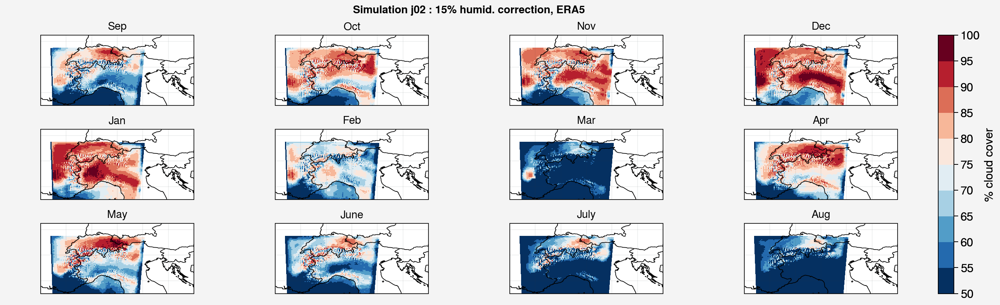

In [21]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3,axheight=0.9)

list_ds = [ds_EUj1960_09_ave, ds_EUj1960_10_ave, ds_EUj1960_11_ave, ds_EUj1960_12_ave, ds_EUj1961_01_ave, ds_EUj1961_02_ave, ds_EUj1961_03_ave, ds_EUj1961_04_ave,
          ds_EUj1961_05_ave, ds_EUj1961_06_ave, ds_EUj1961_07_ave, ds_EUj1961_08_ave]
months = ['Sep','Oct','Nov','Dec','Jan','Feb','Mar','Apr','May','June','July','Aug']

for mon in range(len(list_ds)):
    ax=axs[mon]
    m = ax.pcolormesh(ds.LON,ds.LAT,100*list_ds[mon].CC.mean(axis=0),levels=np.linspace(50,100,11),cmap='RdBu_r')
    ax.format(title=months[mon])


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format,suptitle='Simulation j02 : 15% humid. correction, ERA5')

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

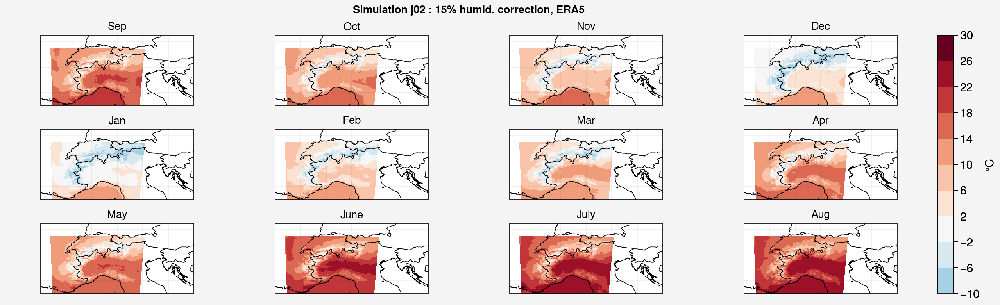

In [28]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3,axheight=0.9)

list_ds = [ds_EUj1960_09_ave, ds_EUj1960_10_ave, ds_EUj1960_11_ave, ds_EUj1960_12_ave, ds_EUj1961_01_ave, ds_EUj1961_02_ave, ds_EUj1961_03_ave, ds_EUj1961_04_ave,
          ds_EUj1961_05_ave, ds_EUj1961_06_ave, ds_EUj1961_07_ave, ds_EUj1961_08_ave]
months = ['Sep','Oct','Nov','Dec','Jan','Feb','Mar','Apr','May','June','July','Aug']

for mon in range(len(list_ds)):
    ax=axs[mon]
    m = ax.pcolormesh(ds.LON,ds.LAT,list_ds[mon].TT2.mean(axis=0),levels=np.linspace(-10,30,11),cmap='RdBu_r')
    ax.format(title=months[mon])


f.colorbar(m,label= '°C',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format,suptitle='Simulation j02 : 15% humid. correction, ERA5')

In [27]:
ds_EUj1960_09_ave.TT2

<xarray.DataArray 'TT2' (time: 180, y: 79, x: 79)>
array([[[19.551908, 19.544828, ..., 19.983564, 19.641031],
        [19.453669, 19.574848, ..., 18.90339 , 18.830654],
        ...,
        [11.165663, 11.136133, ...,  4.891418,  4.620886],
        [11.231896, 11.172812, ...,  5.215185,  5.277147]],

       [[18.933558, 18.941277, ..., 19.755407, 19.32598 ],
        [18.816236, 19.11147 , ..., 18.860844, 18.677097],
        ...,
        [10.942462, 11.258724, ...,  5.518838,  5.290491],
        [11.019876, 11.256945, ...,  5.671139,  5.69852 ]],

       ...,

       [[19.471714, 19.449228, ..., 19.197874, 18.918776],
        [19.417316, 20.040459, ..., 19.670393, 19.315924],
        ...,
        [11.508137, 12.652939, ...,  7.805038,  7.806256],
        [11.497517, 12.541579, ...,  8.271189,  8.126937]],

       [[18.457485, 18.556538, ..., 19.31414 , 18.986055],
        [18.403234, 18.845097, ..., 19.796453, 19.532114],
        ...,
        [ 9.310017, 10.727607, ...,  6.95112 ,  6.41932 ],
        [ 9.327914, 10.593879, ...,  7.002499,  6.719449]]], dtype=float32)
Coordinates:
  * time     (time) datetime64[ns] 1960-09-01T02:00:00 ... 1960-09-30T22:00:00
  * x        (x) float32 -168.0 -161.0 -154.0 -147.0 ... 357.0 364.0 371.0 378.0
  * y        (y) float32 -273.0 -266.0 -259.0 -252.0 ... 252.0 259.0 266.0 273.0
Attributes:
    units:          C
    long_name:      Temperature
    standard_name:  Temperature
    actual_range:   [-10.30229   29.673502]

In [22]:
ds_ERA5_Jan01_05_T = xr.open_dataset('/bettik/castelli/MARin/input/ERA5-EU/1961/ECM.1961.01.01-05.EUR.nc')[["T"]].groupby("time.day").mean()

In [24]:
ds_ERA5_Jan01_05_T

<xarray.Dataset>
Dimensions:  (day: 5, level: 40, lat: 171, lon: 347)
Coordinates:
  * level    (level) int32 40 43 46 49 52 57 59 ... 124 126 128 131 133 134 137
  * lon      (lon) float32 -43.0 -42.7 -42.4 -42.1 -41.8 ... 59.9 60.2 60.5 60.8
  * lat      (lat) float32 23.0 23.3 23.6 23.9 24.2 ... 72.8 73.1 73.4 73.7 74.0
  * day      (day) int64 1 2 3 4 5
Data variables:
    T        (day, level, lat, lon) float32 214.4 214.4 214.4 ... 262.0 262.3
Attributes:
    history:       FERRET V7.6 (optimized) 13-Oct-23
    Conventions:   CF-1.6
    institute_id:  ULg
    institution:   University of Liege - Belgium
    contact:       xavierfettweis@ulg.ac.be
    reanalyse:     ea - era5 - 0.3x0.3
    date:          1961-01-01 to 1961-01-05
    domain:        (-43,23) -> (61,74)

### MAR-MPI SSP5-8.5 (EUy for MARv3.10 sim, EUl for MARv3.14)

In [23]:
ds_EUl2014_09_ave = open_monthly_data_ave(year='2014',month='09',days_in_month='30',sim='l01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1, whichpath='castelli')

ds_EUl2014_10_ave = open_monthly_data_ave(year='2014',month='10',days_in_month='31',sim='l01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1, whichpath='castelli')

ds_EUl2014_11_ave = open_monthly_data_ave(year='2014',month='11',days_in_month='30',sim='l01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1, whichpath='castelli')

ds_EUl2014_12_ave = open_monthly_data_ave(year='2014',month='12',days_in_month='31',sim='l01',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1, whichpath='castelli')

In [21]:
ds_EUl032014_09_ave = open_monthly_data_ave(year='2014',month='09',days_in_month='30',sim='l03',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1, whichpath='castelli')

ds_EUl032014_10_ave = open_monthly_data_ave(year='2014',month='10',days_in_month='31',sim='l03',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1, whichpath='castelli')

ds_EUl032014_11_ave = open_monthly_data_ave(year='2014',month='11',days_in_month='30',sim='l03',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1, whichpath='castelli')

ds_EUl032014_12_ave = open_monthly_data_ave(year='2014',month='12',days_in_month='31',sim='l03',day_average=False,HA_col=True,timestep_in_hours = 4,
                                      imin = 0, imax = -1, jmin = 0, jmax = -1, whichpath='castelli')

In [19]:
# MARv3.14
name_GCM = 'MPI-ESM1-2-HR'
code_GCM = 'MPI-ESM'
scenario = 'HIST'
sim = 'EUy'
sim2 = 'EUy'
data_freq = 'daily'
data_freq_prefix = 'ICE' # ICE for daily, MON for monthly
year = 2014

ssp585_path = '/bettik/beaumetj/MARout/MAR-'+name_GCM+'/'+scenario+'/'+data_freq+'/'+data_freq_prefix+'.'+code_GCM+'_'+scenario+'.'+sim2+'.TTz.'+str(year)+'.nc'

ds_EUy2014_TTz = xr.open_dataset(ssp585_path)

ssp585_path = '/bettik/beaumetj/MARout/MAR-'+name_GCM+'/'+scenario+'/'+data_freq+'/'+data_freq_prefix+'.'+code_GCM+'_'+scenario+'.'+sim2+'.CC.'+str(year)+'.nc'

ds_EUy2014_CC = xr.open_dataset(ssp585_path)

ssp585_path = '/bettik/beaumetj/MARout/MAR-'+name_GCM+'/'+scenario+'/'+data_freq+'/'+data_freq_prefix+'.'+code_GCM+'_'+scenario+'.'+sim2+'.MBrr.'+str(year)+'.nc'

ds_EUy2014_MBrr = xr.open_dataset(ssp585_path)

ssp585_path = '/bettik/beaumetj/MARout/MAR-'+name_GCM+'/'+scenario+'/'+data_freq+'/'+data_freq_prefix+'.'+code_GCM+'_'+scenario+'.'+sim2+'.SWD.'+str(year)+'.nc'

ds_EUy2014_SWD = xr.open_dataset(ssp585_path)

In [37]:
ds_EUy2014_MBrr

<xarray.Dataset>
Dimensions:  (time: 365, y: 126, x: 201)
Coordinates:
  * time     (time) datetime64[ns] 2014-01-01T12:00:00 ... 2014-12-31T12:00:00
  * x        (x) float32 -483.0 -476.0 -469.0 -462.0 ... 896.0 903.0 910.0 917.0
  * y        (y) float32 -308.0 -301.0 -294.0 -287.0 ... 546.0 553.0 560.0 567.0
Data variables:
    MBrr     (time, y, x) float32 ...
Attributes:
    title:        ICE - Exp: y56 - 20140101
    institution:  ULg (Xavier Fettweis)
    history:      Fri Jan 29 23:40:44 2021: ncks -v MBrr ICE.y56.2014.01.01-3...
    netcdf:       4.1.1 of Feb 12 2011 08:44:29 $
    NCO:          4.0.9

In [29]:
ds_EUl2014_09_ave.CC

<xarray.DataArray 'CC' (time: 180, y: 79, x: 79)>
array([[[0.000000e+00, 0.000000e+00, ..., 0.000000e+00, 0.000000e+00],
        [0.000000e+00, 2.546584e-01, ..., 3.984066e-01, 3.625807e-01],
        ...,
        [0.000000e+00, 0.000000e+00, ..., 8.692104e-01, 8.861024e-01],
        [0.000000e+00, 0.000000e+00, ..., 8.263865e-01, 6.108971e-01]],

       [[0.000000e+00, 0.000000e+00, ..., 0.000000e+00, 0.000000e+00],
        [0.000000e+00, 0.000000e+00, ..., 0.000000e+00, 0.000000e+00],
        ...,
        [0.000000e+00, 0.000000e+00, ..., 7.292598e-01, 6.447443e-01],
        [0.000000e+00, 0.000000e+00, ..., 5.968843e-01, 5.851398e-01]],

       ...,

       [[0.000000e+00, 0.000000e+00, ..., 0.000000e+00, 0.000000e+00],
        [0.000000e+00, 0.000000e+00, ..., 0.000000e+00, 0.000000e+00],
        ...,
        [0.000000e+00, 4.999999e-04, ..., 0.000000e+00, 0.000000e+00],
        [0.000000e+00, 4.999999e-04, ..., 0.000000e+00, 0.000000e+00]],

       [[0.000000e+00, 0.000000e+00, ..., 0.000000e+00, 0.000000e+00],
        [0.000000e+00, 0.000000e+00, ..., 0.000000e+00, 0.000000e+00],
        ...,
        [0.000000e+00, 1.000001e-03, ..., 4.999999e-04, 2.499999e-04],
        [0.000000e+00, 1.000001e-03, ..., 2.499999e-04, 0.000000e+00]]],
      dtype=float32)
Coordinates:
  * time     (time) datetime64[ns] 2014-09-01T02:00:00 ... 2014-09-30T22:00:00
  * x        (x) float32 -168.0 -161.0 -154.0 -147.0 ... 357.0 364.0 371.0 378.0
  * y        (y) float32 -273.0 -266.0 -259.0 -252.0 ... 252.0 259.0 266.0 273.0
Attributes:
    units:          -
    long_name:      Cloud Cover
    standard_name:  Cloud_Cover
    actual_range:   [0. 1.]

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

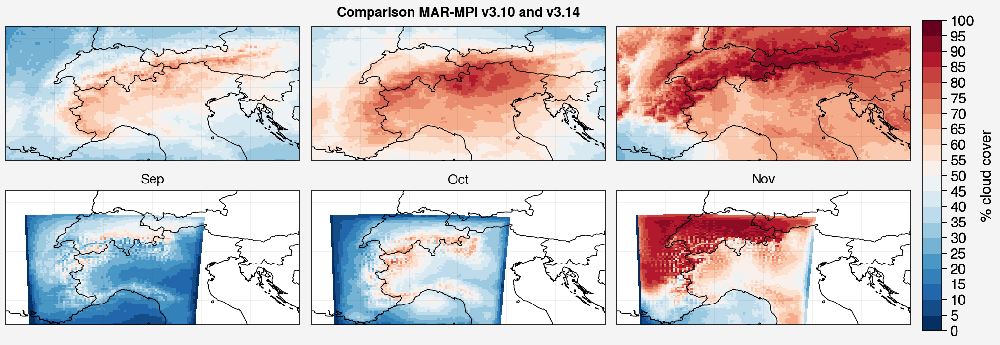

In [30]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=3,nrows=2,axheight=1.5)

list_ds = [ds_EUl2014_09_ave, ds_EUl2014_10_ave, ds_EUl2014_11_ave]
months = ['Sep','Oct','Nov']
ds_big = xr.open_dataset('/bettik/beaumetj/MARout/MAR-EC-Earth3/MARgrid_EUe.nc')

ds_EUy2014_CC_month = ds_EUy2014_CC.groupby("time.month").mean()

for mon in range(len(list_ds)):
    ax=axs[mon]
    m = ax.pcolormesh(ds_big.LON,ds_big.LAT,100*ds_EUy2014_CC_month.CC[mon+8],levels=np.linspace(0,100,21),cmap='RdBu_r')
    
    ax=axs[mon+3]
    m = ax.pcolormesh(ds.LON,ds.LAT,100*list_ds[mon].CC.mean(axis=0),levels=np.linspace(0,100,21),cmap='RdBu_r')
    ax.format(title=months[mon])


f.colorbar(m,label= '% cloud cover',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format,suptitle='Comparison MAR-MPI v3.10 and v3.14')

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

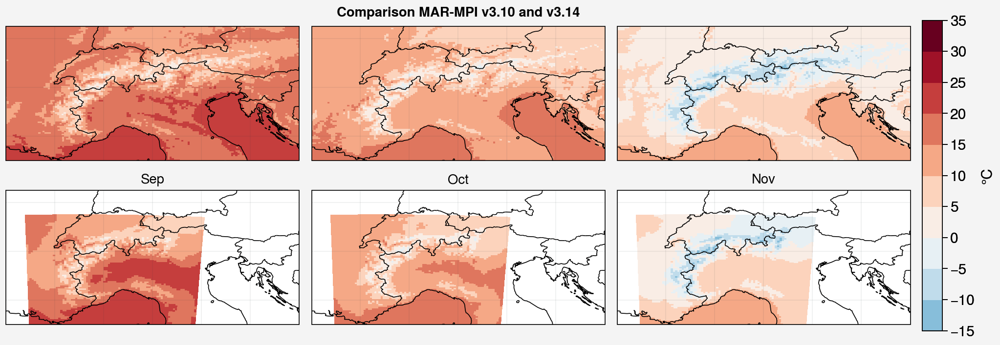

In [55]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=3,nrows=2,axheight=1.5)

list_ds = [ds_EUl2014_09_ave, ds_EUl2014_10_ave, ds_EUl2014_11_ave]
months = ['Sep','Oct','Nov']
ds_big = xr.open_dataset('/bettik/beaumetj/MARout/MAR-EC-Earth3/MARgrid_EUe.nc')

ds_EUy2014_TTz_month = ds_EUy2014_TTz.groupby("time.month").mean()

for mon in range(len(list_ds)):
    ax=axs[mon]
    m = ax.pcolormesh(ds_big.LON,ds_big.LAT,ds_EUy2014_TTz_month.TTz.isel(ztqlev=0)[mon+8],levels=np.linspace(-15,35,11),cmap='RdBu_r')
    
    ax=axs[mon+3]
    m = ax.pcolormesh(ds.LON,ds.LAT,list_ds[mon].TT2.mean(axis=0),levels=np.linspace(-15,35,11),cmap='RdBu_r')
    ax.format(title=months[mon])


f.colorbar(m,label= '°C',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format,suptitle='Comparison MAR-MPI v3.10 and v3.14')

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

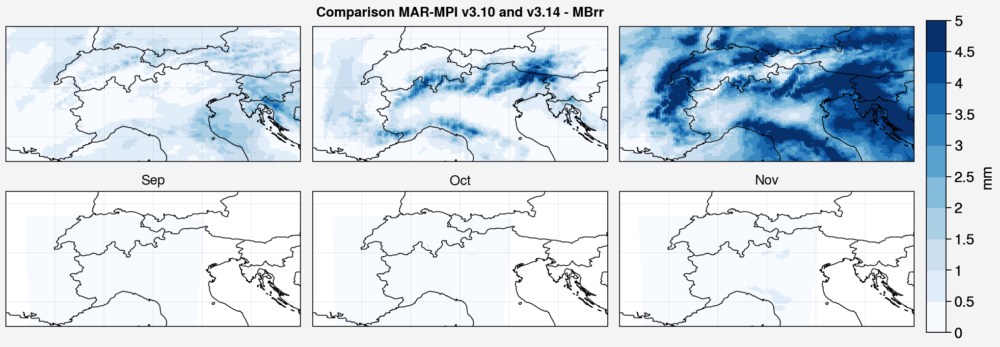

In [20]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=3,nrows=2,axheight=1.5)

list_ds = [ds_EUl2014_09_ave, ds_EUl2014_10_ave, ds_EUl2014_11_ave]
months = ['Sep','Oct','Nov']
ds_big = xr.open_dataset('/bettik/beaumetj/MARout/MAR-EC-Earth3/MARgrid_EUe.nc')

ds_EUy2014_MBrr_month = ds_EUy2014_MBrr.groupby("time.month").mean()

for mon in range(len(list_ds)):
    ax=axs[mon]
    m = ax.pcolormesh(ds_big.LON,ds_big.LAT,ds_EUy2014_MBrr_month.MBrr[mon+8],levels=np.linspace(0,5,11),cmap='Blues')
    
    ax=axs[mon+3]
    m = ax.pcolormesh(ds.LON,ds.LAT,list_ds[mon].MBrr.mean(axis=0),levels=np.linspace(0,5,11),cmap='Blues')
    ax.format(title=months[mon])


f.colorbar(m,label= 'mm',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format,suptitle='Comparison MAR-MPI v3.10 and v3.14 - MBrr')

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

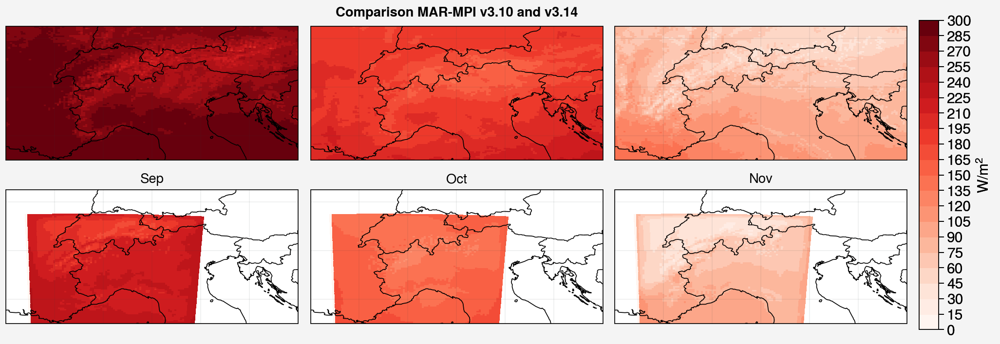

In [65]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=3,nrows=2,axheight=1.5)

list_ds = [ds_EUl2014_09_ave, ds_EUl2014_10_ave, ds_EUl2014_11_ave]
months = ['Sep','Oct','Nov']
ds_big = xr.open_dataset('/bettik/beaumetj/MARout/MAR-EC-Earth3/MARgrid_EUe.nc')

ds_EUy2014_SWD_month = ds_EUy2014_SWD.groupby("time.month").mean()

for mon in range(len(list_ds)):
    ax=axs[mon]
    m = ax.pcolormesh(ds_big.LON,ds_big.LAT,ds_EUy2014_SWD_month.SWD[mon+8],levels=np.linspace(0,200,21),cmap='Reds')
    
    ax=axs[mon+3]
    m = ax.pcolormesh(ds.LON,ds.LAT,list_ds[mon].SWD.mean(axis=0),levels=np.linspace(0,300,21),cmap='Reds')
    ax.format(title=months[mon])


f.colorbar(m,label= 'W/$m^2$',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format,suptitle='Comparison MAR-MPI v3.10 and v3.14')

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

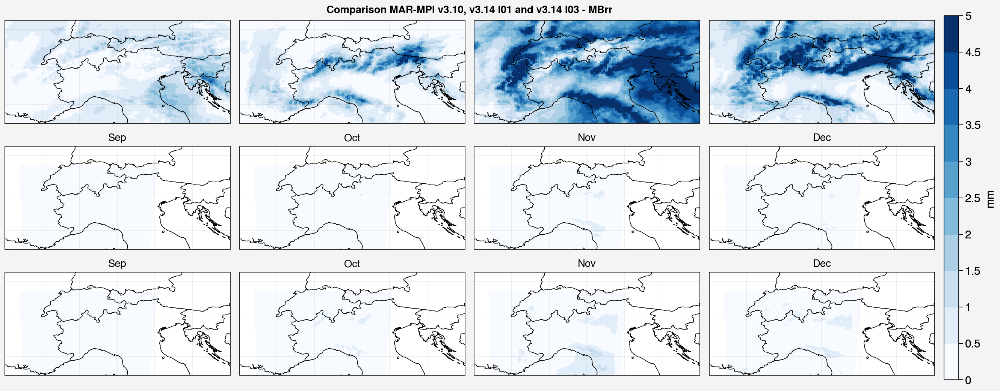

In [24]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3,axheight=1.5)

list_ds = [ds_EUl2014_09_ave, ds_EUl2014_10_ave, ds_EUl2014_11_ave, ds_EUl2014_12_ave]
list_ds2 = [ds_EUl032014_09_ave, ds_EUl032014_10_ave, ds_EUl032014_11_ave, ds_EUl032014_12_ave]
months = ['Sep','Oct','Nov','Dec']
ds_big = xr.open_dataset('/bettik/beaumetj/MARout/MAR-EC-Earth3/MARgrid_EUe.nc')

ds_EUy2014_MBrr_month = ds_EUy2014_MBrr.groupby("time.month").mean()

for mon in range(len(list_ds)):
    ax=axs[mon]
    m = ax.pcolormesh(ds_big.LON,ds_big.LAT,ds_EUy2014_MBrr_month.MBrr[mon+8],levels=np.linspace(0,5,11),cmap='Blues')
    
    ax=axs[mon+4]
    m = ax.pcolormesh(ds.LON,ds.LAT,list_ds[mon].MBrr.mean(axis=0),levels=np.linspace(0,5,11),cmap='Blues')
    ax.format(title=months[mon])

    ax=axs[mon+8]
    m = ax.pcolormesh(ds.LON,ds.LAT,list_ds2[mon].MBrr.mean(axis=0),levels=np.linspace(0,5,11),cmap='Blues')
    ax.format(title=months[mon])


f.colorbar(m,label= 'mm',labelsize='large',ticklabelsize='large')
axs.format(**multiplot_format,suptitle='Comparison MAR-MPI v3.10, v3.14 l01 and v3.14 l03 - MBrr')